In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import KFold, cross_val_score
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler, OrdinalEncoder
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor, ExtraTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor, AdaBoostRegressor, ExtraTreesRegressor
from xgboost import XGBRegressor
from sklearn.neural_network import MLPRegressor

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error

from sklearn.decomposition import PCA

import warnings
warnings.filterwarnings('ignore')

In [2]:
pd.set_option('display.max_row',None)
pd.set_option('display.max_columns',None)

## Load Flat Dataset

In [3]:
df_flat = pd.read_excel('flats.xlsx')
df_flat.head()

,property_name,link,society,price,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating,property_id
0,2 BHK Flat in Krishna Colony,https://www.99acres.com/2-bhk-bedroom-apartmen...,maa bhagwati residency,45 Lac,"₹ 5,000/sq.ft.",Carpet area: 900 (83.61 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"Krishna Colony, Gurgaon, Haryana",4th of 4 Floors,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ...",C68850746
1,2 BHK Flat in Ashok Vihar,https://www.99acres.com/2-bhk-bedroom-apartmen...,Apna Enclave,50 Lac,"₹ 7,692/sq.ft.",Carpet area: 650 (60.39 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"46b, Ashok Vihar, Gurgaon, Haryana",1st of 3 Floors,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ...",H68850564
2,2 BHK Flat in Sohna,https://www.99acres.com/2-bhk-bedroom-apartmen...,Tulsiani Easy in Homes,40 Lac,"₹ 6,722/sq.ft.",Carpet area: 595 (55.28 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,NaN,"Sohna, Gurgaon, Haryana",12nd of 14 Floors,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ...",J68850120
3,2 BHK Flat in Sector 61 Gurgaon,https://www.99acres.com/2-bhk-bedroom-apartmen...,Smart World Orchard,1.47 Crore,"₹ 12,250/sq.ft.",Carpet area: 1200 (111.48 sq.m.),2 Bedrooms,2 Bathrooms,2 Balconies,Study Room,"Sector 61 Gurgaon, Gurgaon, Haryana",2nd of 4 Floors,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN,S68849476
4,2 BHK Flat in Sector 92 Gurgaon,https://www.99acres.com/2-bhk-bedroom-apartmen...,Parkwood Westend,70 Lac,"₹ 5,204/sq.ft.",Super Built up area 1345(124.95 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,Study Room,"Sector 92 Gurgaon, Gurgaon, Haryana",5th of 8 Floors,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ...",L47956793


In [4]:
df_flat.shape

(3027, 20)

In [5]:
df_flat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3027 entries, 0 to 3026
Data columns (total 20 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   property_name    3027 non-null   object
 1   link             3027 non-null   object
 2   society          3026 non-null   object
 3   price            3007 non-null   object
 4   area             3014 non-null   object
 5   areaWithType     3008 non-null   object
 6   bedRoom          3008 non-null   object
 7   bathroom         3008 non-null   object
 8   balcony          3008 non-null   object
 9   additionalRoom   1694 non-null   object
 10  address          3002 non-null   object
 11  floorNum         3006 non-null   object
 12  facing           2127 non-null   object
 13  agePossession    3007 non-null   object
 14  nearbyLocations  2913 non-null   object
 15  description      3008 non-null   object
 16  furnishDetails   2203 non-null   object
 17  features         2594 non-null   

1. all most every column have  missing value
2. All columns have string data type

In [6]:
df_flat.duplicated().sum()

0

=> No duplicate entries found

In [7]:
df_flat.isnull().sum()

property_name         0
link                  0
society               1
price                20
area                 13
areaWithType         19
bedRoom              19
bathroom             19
balcony              19
additionalRoom     1333
address              25
floorNum             21
facing              900
agePossession        20
nearbyLocations     114
description          19
furnishDetails      824
features            433
rating              351
property_id          19
dtype: int64

Lot of missing value in my data set

In [8]:
# Deleting unwanted columns
df_flat.drop(columns=['link','property_id'], axis=1, inplace=True)
df_flat.head()

,property_name,society,price,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,maa bhagwati residency,45 Lac,"₹ 5,000/sq.ft.",Carpet area: 900 (83.61 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"Krishna Colony, Gurgaon, Haryana",4th of 4 Floors,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,Apna Enclave,50 Lac,"₹ 7,692/sq.ft.",Carpet area: 650 (60.39 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"46b, Ashok Vihar, Gurgaon, Haryana",1st of 3 Floors,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,Tulsiani Easy in Homes,40 Lac,"₹ 6,722/sq.ft.",Carpet area: 595 (55.28 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,NaN,"Sohna, Gurgaon, Haryana",12nd of 14 Floors,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,Smart World Orchard,1.47 Crore,"₹ 12,250/sq.ft.",Carpet area: 1200 (111.48 sq.m.),2 Bedrooms,2 Bathrooms,2 Balconies,Study Room,"Sector 61 Gurgaon, Gurgaon, Haryana",2nd of 4 Floors,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,Parkwood Westend,70 Lac,"₹ 5,204/sq.ft.",Super Built up area 1345(124.95 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,Study Room,"Sector 92 Gurgaon, Gurgaon, Haryana",5th of 8 Floors,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [9]:
# rename column "area" to "Price per sq feets"

df_flat.rename(columns={'area':'Price_Per_sqFeets'},inplace=True)
df_flat.head()

,property_name,society,price,Price_Per_sqFeets,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,maa bhagwati residency,45 Lac,"₹ 5,000/sq.ft.",Carpet area: 900 (83.61 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"Krishna Colony, Gurgaon, Haryana",4th of 4 Floors,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,Apna Enclave,50 Lac,"₹ 7,692/sq.ft.",Carpet area: 650 (60.39 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"46b, Ashok Vihar, Gurgaon, Haryana",1st of 3 Floors,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,Tulsiani Easy in Homes,40 Lac,"₹ 6,722/sq.ft.",Carpet area: 595 (55.28 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,NaN,"Sohna, Gurgaon, Haryana",12nd of 14 Floors,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,Smart World Orchard,1.47 Crore,"₹ 12,250/sq.ft.",Carpet area: 1200 (111.48 sq.m.),2 Bedrooms,2 Bathrooms,2 Balconies,Study Room,"Sector 61 Gurgaon, Gurgaon, Haryana",2nd of 4 Floors,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,Parkwood Westend,70 Lac,"₹ 5,204/sq.ft.",Super Built up area 1345(124.95 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,Study Room,"Sector 92 Gurgaon, Gurgaon, Haryana",5th of 8 Floors,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [10]:
df_flat['society'].value_counts()

SS The Leaf3.8 ★                                     73
Tulip Violet4.3 ★                                    40
Shapoorji Pallonji Joyville Gurugram4.0 ★            39
Signature Global Park4.0 ★                           36
Shree Vardhman Victoria3.8 ★                         35
Tulip Violet4.2 ★                                    33
Smart World Gems                                     32
Emaar MGF Emerald Floors Premier3.8 ★                32
Smart World Orchard                                  32
DLF The Ultima4.0 ★                                  31
Paras Dews                                           31
DLF Regal Gardens3.9 ★                               30
M3M Woodshire4.0 ★                                   29
Shree Vardhman Flora3.8 ★                            29
Signature Global Solera3.7 ★                         28
La Vida by Tata Housing                              28
Godrej Nature Plus                                   27
Emaar Gurgaon Greens4.1 ★                       

In [11]:
df_flat['society'].value_counts().shape

(638,)

In [12]:
import re
df_flat['society'] = df_flat['society'].apply(lambda x: re.sub(r'\d+(\.\d+)?\s★', '', str(x)).strip()).str.lower()

In [13]:
df_flat['society'].value_counts().shape

(604,)

In [14]:
df_flat['price'].value_counts()

1.25 Crore          79
1.1 Crore           61
1.4 Crore           60
1.5 Crore           59
1.2 Crore           59
90 Lac              58
1.3 Crore           57
95 Lac              53
2 Crore             51
1.75 Crore          47
1 Crore             46
1.6 Crore           43
1.35 Crore          41
1.55 Crore          40
1.9 Crore           40
75 Lac              38
1.65 Crore          38
1.8 Crore           37
1.7 Crore           37
80 Lac              36
2.2 Crore           34
50 Lac              33
1.15 Crore          33
1.45 Crore          31
85 Lac              31
1.05 Crore          30
2.5 Crore           29
60 Lac              29
40 Lac              29
2.1 Crore           26
45 Lac              26
65 Lac              25
35 Lac              23
2.35 Crore          23
1.85 Crore          23
3 Crore             22
70 Lac              21
55 Lac              20
2.25 Crore          20
3.5 Crore           19
2.4 Crore           18
2.3 Crore           18
30 Lac              17
2.65 Crore 

In [15]:
df_flat= df_flat[df_flat['price'] != 'Price on Request']

In [16]:
df_flat.head()

,property_name,society,price,Price_Per_sqFeets,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,maa bhagwati residency,45 Lac,"₹ 5,000/sq.ft.",Carpet area: 900 (83.61 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"Krishna Colony, Gurgaon, Haryana",4th of 4 Floors,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,apna enclave,50 Lac,"₹ 7,692/sq.ft.",Carpet area: 650 (60.39 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"46b, Ashok Vihar, Gurgaon, Haryana",1st of 3 Floors,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,tulsiani easy in homes,40 Lac,"₹ 6,722/sq.ft.",Carpet area: 595 (55.28 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,NaN,"Sohna, Gurgaon, Haryana",12nd of 14 Floors,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,smart world orchard,1.47 Crore,"₹ 12,250/sq.ft.",Carpet area: 1200 (111.48 sq.m.),2 Bedrooms,2 Bathrooms,2 Balconies,Study Room,"Sector 61 Gurgaon, Gurgaon, Haryana",2nd of 4 Floors,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,parkwood westend,70 Lac,"₹ 5,204/sq.ft.",Super Built up area 1345(124.95 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,Study Room,"Sector 92 Gurgaon, Gurgaon, Haryana",5th of 8 Floors,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [17]:
df_flat['price'].value_counts()

1.25 Crore     79
1.1 Crore      61
1.4 Crore      60
1.2 Crore      59
1.5 Crore      59
90 Lac         58
1.3 Crore      57
95 Lac         53
2 Crore        51
1.75 Crore     47
1 Crore        46
1.6 Crore      43
1.35 Crore     41
1.9 Crore      40
1.55 Crore     40
75 Lac         38
1.65 Crore     38
1.7 Crore      37
1.8 Crore      37
80 Lac         36
2.2 Crore      34
1.15 Crore     33
50 Lac         33
1.45 Crore     31
85 Lac         31
1.05 Crore     30
2.5 Crore      29
40 Lac         29
60 Lac         29
2.1 Crore      26
45 Lac         26
65 Lac         25
1.85 Crore     23
35 Lac         23
2.35 Crore     23
3 Crore        22
70 Lac         21
2.25 Crore     20
55 Lac         20
3.5 Crore      19
2.4 Crore      18
2.3 Crore      18
30 Lac         17
2.65 Crore     16
1.38 Crore     15
2.6 Crore      15
2.15 Crore     14
3.4 Crore      14
2.45 Crore     14
2.7 Crore      13
92 Lac         13
78 Lac         13
3.25 Crore     13
82 Lac         13
1.32 Crore     13
38 Lac    

In [18]:
# create a function for remove string from price column

def price_update(x):
    if type(x) == float:
        return x
    else:
        try:
            if x[1] == 'Lac':
                return round(float(x[0])/100,2)
            else:
                return round(float(x[0]),2)
        except:
            pass

In [19]:
df_flat['price'] = df_flat['price'].str.split(' ').apply(price_update)

In [20]:
df_flat.head()

,property_name,society,price,Price_Per_sqFeets,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,maa bhagwati residency,0.45,"₹ 5,000/sq.ft.",Carpet area: 900 (83.61 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"Krishna Colony, Gurgaon, Haryana",4th of 4 Floors,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,apna enclave,0.50,"₹ 7,692/sq.ft.",Carpet area: 650 (60.39 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"46b, Ashok Vihar, Gurgaon, Haryana",1st of 3 Floors,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,tulsiani easy in homes,0.40,"₹ 6,722/sq.ft.",Carpet area: 595 (55.28 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,NaN,"Sohna, Gurgaon, Haryana",12nd of 14 Floors,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,smart world orchard,1.47,"₹ 12,250/sq.ft.",Carpet area: 1200 (111.48 sq.m.),2 Bedrooms,2 Bathrooms,2 Balconies,Study Room,"Sector 61 Gurgaon, Gurgaon, Haryana",2nd of 4 Floors,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,parkwood westend,0.70,"₹ 5,204/sq.ft.",Super Built up area 1345(124.95 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,Study Room,"Sector 92 Gurgaon, Gurgaon, Haryana",5th of 8 Floors,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [21]:
df_flat['Price_Per_sqFeets']= df_flat['Price_Per_sqFeets'].str.split(' ').str.get(1).str.split('/').str.get(0).str.replace(',','').str.strip().astype(float)

In [22]:
df_flat.head()

,property_name,society,price,Price_Per_sqFeets,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,maa bhagwati residency,0.45,5000.0,Carpet area: 900 (83.61 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"Krishna Colony, Gurgaon, Haryana",4th of 4 Floors,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,apna enclave,0.50,7692.0,Carpet area: 650 (60.39 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"46b, Ashok Vihar, Gurgaon, Haryana",1st of 3 Floors,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,tulsiani easy in homes,0.40,6722.0,Carpet area: 595 (55.28 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,NaN,"Sohna, Gurgaon, Haryana",12nd of 14 Floors,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,smart world orchard,1.47,12250.0,Carpet area: 1200 (111.48 sq.m.),2 Bedrooms,2 Bathrooms,2 Balconies,Study Room,"Sector 61 Gurgaon, Gurgaon, Haryana",2nd of 4 Floors,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,parkwood westend,0.70,5204.0,Super Built up area 1345(124.95 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,Study Room,"Sector 92 Gurgaon, Gurgaon, Haryana",5th of 8 Floors,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [23]:
df_flat['areaWithType'].value_counts()

Super Built up area 1578(146.6 sq.m.)                                                                                           17
Super Built up area 1350(125.42 sq.m.)                                                                                          17
Super Built up area 1950(181.16 sq.m.)Carpet area: 1161 sq.ft. (107.86 sq.m.)                                                   17
Super Built up area 1650(153.29 sq.m.)Carpet area: 1022.58 sq.ft. (95 sq.m.)                                                    15
Super Built up area 2010(186.74 sq.m.)                                                                                          14
Super Built up area 2150(199.74 sq.m.)                                                                                          12
Super Built up area 1950(181.16 sq.m.)                                                                                          11
Carpet area: 1650 (153.29 sq.m.)                                                   

In [24]:
#bedroom
df_flat['bedRoom'].value_counts()

3 Bedrooms    1437
2 Bedrooms     944
4 Bedrooms     478
1 Bedroom      104
5 Bedrooms      31
6 Bedrooms       3
Name: bedRoom, dtype: int64

In [25]:
df_flat[df_flat['bedRoom'].isnull()]

,property_name,society,price,Price_Per_sqFeets,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
2849,2 BHK Flat in Sector 107 Gurgaon,signature global solera,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2850,4 BHK Flat in Sector 53 Gurgaon,tulip monsella,NaN,33198.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2851,2 BHK Flat in New Palam Vihar,my home,NaN,4400.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2852,2 BHK Flat in Sohna,breez global hill view,NaN,5470.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2922,3 BHK Flat in Sector 99A Gurgaon,pareena coban residences,NaN,5759.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2923,1 BHK Flat in Golf Course Ext Road,ikon tower baani city centre,NaN,12437.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2924,2 BHK Flat in Sector 89 Gurgaon,greenopolis,NaN,4820.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2926,4 BHK Flat in C Block Sushant Lok Phase 1,maple heights,NaN,8888.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2927,2 BHK Flat in Sector 99 Gurgaon,assotech blith,NaN,6593.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2993,4 BHK Flat in DLF Phase 4,chanderlok society,NaN,7234.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [26]:
df_flat = df_flat[~df_flat['bedRoom'].isnull()]

In [27]:
df_flat

,property_name,society,price,Price_Per_sqFeets,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,maa bhagwati residency,0.45,5000.0,Carpet area: 900 (83.61 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"Krishna Colony, Gurgaon, Haryana",4th of 4 Floors,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,apna enclave,0.50,7692.0,Carpet area: 650 (60.39 sq.m.),2 Bedrooms,2 Bathrooms,1 Balcony,NaN,"46b, Ashok Vihar, Gurgaon, Haryana",1st of 3 Floors,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,tulsiani easy in homes,0.40,6722.0,Carpet area: 595 (55.28 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,NaN,"Sohna, Gurgaon, Haryana",12nd of 14 Floors,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,smart world orchard,1.47,12250.0,Carpet area: 1200 (111.48 sq.m.),2 Bedrooms,2 Bathrooms,2 Balconies,Study Room,"Sector 61 Gurgaon, Gurgaon, Haryana",2nd of 4 Floors,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,parkwood westend,0.70,5204.0,Super Built up area 1345(124.95 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,Study Room,"Sector 92 Gurgaon, Gurgaon, Haryana",5th of 8 Floors,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."
5,2 BHK Flat in Sector 36 Gurgaon,signature global infinity mall,0.41,6269.0,Built Up area: 654 (60.76 sq.m.),2 Bedrooms,2 Bathrooms,3 Balconies,NaN,"Sohna Sector 36, Sector 36 Gurgaon, Gurgaon, H...",3rd of 3 Floors,NaN,undefined,NaN,Best in class property available at sector 36 ...,NaN,NaN,NaN
6,3 BHK Flat in Dwarka Expressway Gurgaon,the cocoon,2.00,13333.0,Super Built up area 1500(139.35 sq.m.),3 Bedrooms,3 Bathrooms,3 Balconies,NaN,"Dwarka Expressway Gurgaon, Gurgaon, Haryana",5th of 25 Floors,NaN,0 to 1 Year Old,"['Shri Multispeciality Hospital', 'Esic Hospit...",Residential apartment for sell.The property co...,[],NaN,NaN
7,3 BHK Flat in Sector 104 Gurgaon,ats triumph,1.80,7860.0,Carpet area: 2290 (212.75 sq.m.),3 Bedrooms,4 Bathrooms,3 Balconies,NaN,"Sector 104 Gurgaon, Gurgaon, Haryana",14th of 27 Floors,NaN,0 to 1 Year Old,"['IFFCO Chowk Metro Station', 'The Esplanade M...",Ats triumph is one of gurgaon's most sought af...,[],"['Power Back-up', 'Intercom Facility', 'Lift(s...","['Green Area4 out of 5', 'Amenities4.5 out of ..."
8,2 BHK Flat in Sector 88B Gurgaon,vatika xpressions,1.10,8148.0,Built Up area: 1350 (125.42 sq.m.)Carpet area:...,2 Bedrooms,4 Bathrooms,3+ Balconies,Study Room,"H 23, Sector 88B Gurgaon, Gurgaon, Haryana",2nd of 3 Floors,North-East,Under Construction,"['Dwarka Expressway', 'Adarsh public school,Ga...",We are the proud owners of this 2 bhk apartmen...,NaN,"['Feng Shui / Vaastu Compliant', 'Intercom Fac...",NaN
9,3 BHK Flat in Sector 78 Gurgaon,raheja revanta,4.75,16885.0,Built Up area: 2813 (261.34 sq.m.),3 Bedrooms,3 Bathrooms,2 Balconies,Servant Room,"Sector 78 Gurgaon, Gurgaon, Haryana",31st of 40 Floors,NaN,2023-12-01 00:00:00,"['Sapphire 83 Mal

In [28]:
df_flat['bedRoom']= df_flat['bedRoom'].str.split(' ').str.get(0).str.strip().astype('int')

In [29]:
df_flat.head()

,property_name,society,price,Price_Per_sqFeets,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,maa bhagwati residency,0.45,5000.0,Carpet area: 900 (83.61 sq.m.),2,2 Bathrooms,1 Balcony,NaN,"Krishna Colony, Gurgaon, Haryana",4th of 4 Floors,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,apna enclave,0.50,7692.0,Carpet area: 650 (60.39 sq.m.),2,2 Bathrooms,1 Balcony,NaN,"46b, Ashok Vihar, Gurgaon, Haryana",1st of 3 Floors,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,tulsiani easy in homes,0.40,6722.0,Carpet area: 595 (55.28 sq.m.),2,2 Bathrooms,3 Balconies,NaN,"Sohna, Gurgaon, Haryana",12nd of 14 Floors,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,smart world orchard,1.47,12250.0,Carpet area: 1200 (111.48 sq.m.),2,2 Bathrooms,2 Balconies,Study Room,"Sector 61 Gurgaon, Gurgaon, Haryana",2nd of 4 Floors,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,parkwood westend,0.70,5204.0,Super Built up area 1345(124.95 sq.m.),2,2 Bathrooms,3 Balconies,Study Room,"Sector 92 Gurgaon, Gurgaon, Haryana",5th of 8 Floors,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [30]:
df_flat['bathroom'].value_counts()

2 Bathrooms    1044
3 Bathrooms     989
4 Bathrooms     636
5 Bathrooms     169
1 Bathroom      112
6 Bathrooms      42
7 Bathrooms       5
Name: bathroom, dtype: int64

In [31]:
df_flat['bathroom'].isnull().sum()

0

In [32]:
df_flat['bathroom']=df_flat['bathroom'].str.split(' ').str.get(0).astype('int')

In [33]:
df_flat['balcony'].value_counts()

3 Balconies     974
3+ Balconies    862
2 Balconies     749
1 Balcony       315
No Balcony       97
Name: balcony, dtype: int64

In [34]:
df_flat['balcony'].isnull().sum()

0

In [35]:
df_flat['balcony'] = df_flat['balcony'].str.split(' ').str.get(0).str.replace('No','0')

In [36]:
df_flat.head()

,property_name,society,price,Price_Per_sqFeets,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,maa bhagwati residency,0.45,5000.0,Carpet area: 900 (83.61 sq.m.),2,2,1,NaN,"Krishna Colony, Gurgaon, Haryana",4th of 4 Floors,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,apna enclave,0.50,7692.0,Carpet area: 650 (60.39 sq.m.),2,2,1,NaN,"46b, Ashok Vihar, Gurgaon, Haryana",1st of 3 Floors,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,tulsiani easy in homes,0.40,6722.0,Carpet area: 595 (55.28 sq.m.),2,2,3,NaN,"Sohna, Gurgaon, Haryana",12nd of 14 Floors,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,smart world orchard,1.47,12250.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,Study Room,"Sector 61 Gurgaon, Gurgaon, Haryana",2nd of 4 Floors,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,parkwood westend,0.70,5204.0,Super Built up area 1345(124.95 sq.m.),2,2,3,Study Room,"Sector 92 Gurgaon, Gurgaon, Haryana",5th of 8 Floors,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [37]:
df_flat['additionalRoom'].value_counts()

Servant Room                                     629
Study Room                                       232
Others                                           179
Pooja Room                                       132
Study Room,Servant Room                           81
Store Room                                        76
Pooja Room,Servant Room                           60
Servant Room,Others                               52
Servant Room,Pooja Room                           30
Study Room,Others                                 27
Pooja Room,Study Room,Servant Room,Others         25
Pooja Room,Study Room,Servant Room                24
Servant Room,Store Room                           19
Pooja Room,Study Room                             13
Pooja Room,Study Room,Servant Room,Store Room     12
Study Room,Pooja Room                              8
Servant Room,Study Room                            8
Study Room,Servant Room,Store Room                 7
Pooja Room,Store Room                         

In [38]:
df_flat['additionalRoom'].isnull().sum()

1305

In [39]:
df_flat['additionalRoom'].fillna('not available', inplace=True)

In [40]:
df_flat['additionalRoom'] = df_flat['additionalRoom'].str.lower()

In [41]:
df_flat.head()

,property_name,society,price,Price_Per_sqFeets,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,maa bhagwati residency,0.45,5000.0,Carpet area: 900 (83.61 sq.m.),2,2,1,not available,"Krishna Colony, Gurgaon, Haryana",4th of 4 Floors,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,apna enclave,0.50,7692.0,Carpet area: 650 (60.39 sq.m.),2,2,1,not available,"46b, Ashok Vihar, Gurgaon, Haryana",1st of 3 Floors,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,tulsiani easy in homes,0.40,6722.0,Carpet area: 595 (55.28 sq.m.),2,2,3,not available,"Sohna, Gurgaon, Haryana",12nd of 14 Floors,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,smart world orchard,1.47,12250.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,study room,"Sector 61 Gurgaon, Gurgaon, Haryana",2nd of 4 Floors,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,parkwood westend,0.70,5204.0,Super Built up area 1345(124.95 sq.m.),2,2,3,study room,"Sector 92 Gurgaon, Gurgaon, Haryana",5th of 8 Floors,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [42]:
# floor nu

df_flat['floorNum']

0              4th   of 4 Floors
1              1st   of 3 Floors
2            12nd   of 14 Floors
3              2nd   of 4 Floors
4              5th   of 8 Floors
5              3rd   of 3 Floors
6             5th   of 25 Floors
7            14th   of 27 Floors
8              2nd   of 3 Floors
9            31st   of 40 Floors
10             1st   of 4 Floors
11            4th   of 13 Floors
12            4th   of 15 Floors
13            3rd   of 20 Floors
14           13rd   of 13 Floors
15           25th   of 25 Floors
16            Ground of 1 Floors
17           Ground of 14 Floors
18           11st   of 14 Floors
19           12nd   of 13 Floors
20             4th   of 4 Floors
21           11st   of 22 Floors
22             4th   of 4 Floors
23           Ground of 14 Floors
24           10th   of 25 Floors
26             3rd   of 3 Floors
27           20th   of 20 Floors
28            5th   of 17 Floors
29            4th   of 12 Floors
30             4th   of 4 Floors
31        

In [43]:
df_flat['floorNum'].isnull().sum()

2

In [44]:
df_flat['floorNum'] = df_flat['floorNum'].str.split(' ').str.get(0).str.replace('Ground','0').str.replace('Basement','-1').str.replace('Lower','0').str.extract(r'(\d+)')

In [45]:
df_flat['floorNum'] = df_flat['floorNum'].astype('float')

In [46]:
df_flat.head()

,property_name,society,price,Price_Per_sqFeets,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,maa bhagwati residency,0.45,5000.0,Carpet area: 900 (83.61 sq.m.),2,2,1,not available,"Krishna Colony, Gurgaon, Haryana",4.0,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,apna enclave,0.50,7692.0,Carpet area: 650 (60.39 sq.m.),2,2,1,not available,"46b, Ashok Vihar, Gurgaon, Haryana",1.0,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,tulsiani easy in homes,0.40,6722.0,Carpet area: 595 (55.28 sq.m.),2,2,3,not available,"Sohna, Gurgaon, Haryana",12.0,NaN,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,smart world orchard,1.47,12250.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,study room,"Sector 61 Gurgaon, Gurgaon, Haryana",2.0,NaN,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,parkwood westend,0.70,5204.0,Super Built up area 1345(124.95 sq.m.),2,2,3,study room,"Sector 92 Gurgaon, Gurgaon, Haryana",5.0,NaN,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [47]:
df_flat['facing'].value_counts()

North-East    505
East          490
North         301
South         203
West          183
North-West    162
South-East    144
South-West    135
Name: facing, dtype: int64

In [48]:
df_flat['facing'].isnull().sum()

874

In [49]:
df_flat['facing'].fillna('NA',inplace=True)

In [50]:
df_flat.insert(loc=4,column='area', value=round((df_flat['price']*10000000)/df_flat['Price_Per_sqFeets']))

In [51]:
df_flat.insert(loc=1,column='Property_type',value='flat')

In [52]:
df_flat.head()

,property_name,Property_type,society,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,flat,maa bhagwati residency,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,not available,"Krishna Colony, Gurgaon, Haryana",4.0,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,flat,apna enclave,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,not available,"46b, Ashok Vihar, Gurgaon, Haryana",1.0,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,flat,tulsiani easy in homes,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,not available,"Sohna, Gurgaon, Haryana",12.0,NA,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,flat,smart world orchard,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,study room,"Sector 61 Gurgaon, Gurgaon, Haryana",2.0,NA,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,flat,parkwood westend,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,study room,"Sector 92 Gurgaon, Gurgaon, Haryana",5.0,NA,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [53]:
df_flat.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2997 entries, 0 to 3026
Data columns (total 20 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   property_name      2997 non-null   object 
 1   Property_type      2997 non-null   object 
 2   society            2997 non-null   object 
 3   price              2996 non-null   float64
 4   Price_Per_sqFeets  2996 non-null   float64
 5   area               2996 non-null   float64
 6   areaWithType       2997 non-null   object 
 7   bedRoom            2997 non-null   int32  
 8   bathroom           2997 non-null   int32  
 9   balcony            2997 non-null   object 
 10  additionalRoom     2997 non-null   object 
 11  address            2991 non-null   object 
 12  floorNum           2995 non-null   float64
 13  facing             2997 non-null   object 
 14  agePossession      2996 non-null   object 
 15  nearbyLocations    2906 non-null   object 
 16  description        2997 

In [54]:
df_flat.shape

(2997, 20)

## Load House data set

In [55]:
# load dataset

df_house = pd.read_excel('independent-house.xlsx')
df_house.head()

,property_name,link,society,price,rate,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,noOfFloor,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating,property_id
0,5 Bedroom House for sale in Sector 70A Gurgaon,https://www.99acres.com/5-bhk-bedroom-independ...,Bptp Visionnaire,5.25 Crore,"₹ 20,115/sq.ft.",(242 sq.m.) Plot Area,Plot area 290(242.48 sq.m.),5 Bedrooms,4 Bathrooms,3+ Balconies,Servant Room,"29b, Sector 70A Gurgaon, Gurgaon, Haryana",3 Floors,North-East,0 to 1 Year Old,"['Good Earth City Center 2', 'Kunskapsskolan I...",Do you wish to buy an independent house in sec...,"['1 Wardrobe', '1 Fan', '1 Exhaust Fan', '1 Ge...","['Feng Shui / Vaastu Compliant', 'Private Gard...","['Environment5 out of 5', 'Lifestyle4 out of 5...",K70037724
1,5 Bedroom House for sale in Sector 21A Faridabad,https://www.99acres.com/5-bhk-bedroom-independ...,NaN,5.7 Crore,"₹ 105,751/sq.ft.",(50 sq.m.) Plot Area,Plot area 539(50.07 sq.m.),5 Bedrooms,4 Bathrooms,2 Balconies,"Store Room,Pooja Room,Servant Room","Sector 21A Faridabad, Gurgaon, Haryana",2 Floors,NaN,5 to 10 Year Old,NaN,"Hi, we have an independent house/villa availab...","['1 Water Purifier', '5 Fan', '1 Exhaust Fan',...","['Private Garden / Terrace', 'Park', 'Visitor ...",NaN,E69288322
2,10 Bedroom House for sale in Sushant Lok Phase 1,https://www.99acres.com/10-bhk-bedroom-indepen...,NaN,2.1 Crore,"₹ 38,251/sq.ft.",(51 sq.m.) Plot Area,Plot area 61(51 sq.m.),10 Bedrooms,10 Bathrooms,3+ Balconies,Servant Room,"Sushant Lok Phase 1, Gurgaon, Haryana",5 Floors,West,0 to 1 Year Old,"['Sector 42-43 metro station', 'Huda city cent...","Monthly rental income is rs1,40,000/- Best opt...","['10 Bed', '3 Fan', '10 Geyser', '2 Light', 'N...","['Maintenance Staff', 'Water Storage', 'Visito...","['Environment5 out of 5', 'Lifestyle5 out of 5...",F69536898
3,21 Bedroom House for sale in Sector 54 Gurgaon,https://www.99acres.com/21-bhk-bedroom-indepen...,NaN,5 Crore,"₹ 43,066/sq.ft.",(108 sq.m.) Plot Area,Plot area 129(107.86 sq.m.),21 Bedrooms,21 Bathrooms,3+ Balconies,Servant Room,"Sector 54 Gurgaon, Gurgaon, Haryana",5 Floors,North,1 to 5 Year Old,"['Sector 53-54 metro station', 'Sector 54 chow...","129 sq yd plot size. 5 floors built up , fully...","['1 Water Purifier', '21 Fan', '1 Fridge', '1 ...","['Feng Shui / Vaastu Compliant', 'Private Gard...","['Environment4 out of 5', 'Lifestyle5 out of 5...",R69483164
4,12 Bedroom House for sale in Sushant Lok Phase 1,https://www.99acres.com/12-bhk-bedroom-indepen...,NaN,3 Crore,"₹ 53,763/sq.ft.",(52 sq.m.) Plot Area,Plot area 62(51.84 sq.m.),12 Bedrooms,12 Bathrooms,3+ Balconies,Others,"1228, Sushant Lok Phase 1, Gurgaon, Haryana",5 Floors,West,Within 6 months,"['Sector 42-43 metro station', 'Huda city cent...",Best for investment purpose. Fully furnished b...,"['1 Water Purifier', '1 Fridge', '12 Fan', '1 ...","['Maintenance Staff', 'Water Storage', 'Visito...","['Environment5 out of 5', 'Lifestyle5 out of 5...",M69381272


In [56]:
df_house.drop(columns=['link','property_id'], axis=1, inplace=True)
df_house.head()

,property_name,society,price,rate,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,noOfFloor,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,5 Bedroom House for sale in Sector 70A Gurgaon,Bptp Visionnaire,5.25 Crore,"₹ 20,115/sq.ft.",(242 sq.m.) Plot Area,Plot area 290(242.48 sq.m.),5 Bedrooms,4 Bathrooms,3+ Balconies,Servant Room,"29b, Sector 70A Gurgaon, Gurgaon, Haryana",3 Floors,North-East,0 to 1 Year Old,"['Good Earth City Center 2', 'Kunskapsskolan I...",Do you wish to buy an independent house in sec...,"['1 Wardrobe', '1 Fan', '1 Exhaust Fan', '1 Ge...","['Feng Shui / Vaastu Compliant', 'Private Gard...","['Environment5 out of 5', 'Lifestyle4 out of 5..."
1,5 Bedroom House for sale in Sector 21A Faridabad,NaN,5.7 Crore,"₹ 105,751/sq.ft.",(50 sq.m.) Plot Area,Plot area 539(50.07 sq.m.),5 Bedrooms,4 Bathrooms,2 Balconies,"Store Room,Pooja Room,Servant Room","Sector 21A Faridabad, Gurgaon, Haryana",2 Floors,NaN,5 to 10 Year Old,NaN,"Hi, we have an independent house/villa availab...","['1 Water Purifier', '5 Fan', '1 Exhaust Fan',...","['Private Garden / Terrace', 'Park', 'Visitor ...",NaN
2,10 Bedroom House for sale in Sushant Lok Phase 1,NaN,2.1 Crore,"₹ 38,251/sq.ft.",(51 sq.m.) Plot Area,Plot area 61(51 sq.m.),10 Bedrooms,10 Bathrooms,3+ Balconies,Servant Room,"Sushant Lok Phase 1, Gurgaon, Haryana",5 Floors,West,0 to 1 Year Old,"['Sector 42-43 metro station', 'Huda city cent...","Monthly rental income is rs1,40,000/- Best opt...","['10 Bed', '3 Fan', '10 Geyser', '2 Light', 'N...","['Maintenance Staff', 'Water Storage', 'Visito...","['Environment5 out of 5', 'Lifestyle5 out of 5..."
3,21 Bedroom House for sale in Sector 54 Gurgaon,NaN,5 Crore,"₹ 43,066/sq.ft.",(108 sq.m.) Plot Area,Plot area 129(107.86 sq.m.),21 Bedrooms,21 Bathrooms,3+ Balconies,Servant Room,"Sector 54 Gurgaon, Gurgaon, Haryana",5 Floors,North,1 to 5 Year Old,"['Sector 53-54 metro station', 'Sector 54 chow...","129 sq yd plot size. 5 floors built up , fully...","['1 Water Purifier', '21 Fan', '1 Fridge', '1 ...","['Feng Shui / Vaastu Compliant', 'Private Gard...","['Environment4 out of 5', 'Lifestyle5 out of 5..."
4,12 Bedroom House for sale in Sushant Lok Phase 1,NaN,3 Crore,"₹ 53,763/sq.ft.",(52 sq.m.) Plot Area,Plot area 62(51.84 sq.m.),12 Bedrooms,12 Bathrooms,3+ Balconies,Others,"1228, Sushant Lok Phase 1, Gurgaon, Haryana",5 Floors,West,Within 6 months,"['Sector 42-43 metro station', 'Huda city cent...",Best for investment purpose. Fully furnished b...,"['1 Water Purifier', '1 Fridge', '12 Fan', '1 ...","['Maintenance Staff', 'Water Storage', 'Visito...","['Environment5 out of 5', 'Lifestyle5 out of 5..."


In [57]:
df_house.isnull().sum()

property_name        0
society            584
price               69
rate                38
area                 0
areaWithType        50
bedRoom             50
bathroom            50
balcony             50
additionalRoom     448
address              6
noOfFloor           70
facing             363
agePossession       50
nearbyLocations    124
description          1
furnishDetails     294
features           363
rating             130
dtype: int64

In [58]:
df_house.duplicated().sum()

21

In [59]:
df_house.drop_duplicates(inplace=True)

In [60]:
df_house.shape

(1016, 19)

In [61]:
df_house.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1016 entries, 0 to 1036
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   property_name    1016 non-null   object
 1   society          437 non-null    object
 2   price            955 non-null    object
 3   rate             979 non-null    object
 4   area             1016 non-null   object
 5   areaWithType     974 non-null    object
 6   bedRoom          974 non-null    object
 7   bathroom         974 non-null    object
 8   balcony          974 non-null    object
 9   additionalRoom   578 non-null    object
 10  address          1010 non-null   object
 11  noOfFloor        955 non-null    object
 12  facing           662 non-null    object
 13  agePossession    974 non-null    object
 14  nearbyLocations  892 non-null    object
 15  description      1015 non-null   object
 16  furnishDetails   732 non-null    object
 17  features         662 non-null    

In [62]:
df_house.rename(columns={'rate':'Price_Per_sqFeets'},inplace=True)

In [63]:
df_house['society'].value_counts()

International City by SOBHA Phase 2                  26
Vipul Tatvam Villa                                   23
International City by Sobha Phase 1                  22
Emaar MGF Marbella                                   22
Unitech Uniworld Resorts                             13
DLF City Plots                                       11
DLF City Plots Phase 2                               11
Unitech Espace                                       11
Eldeco Mansionz                                       9
Bptp Visionnaire                                      8
Not Applicable                                        7
Uppal Southend4.0 ★                                   7
Sushant Lok 1 Builder Floors                          6
Ansals Palam Vihar                                    6
DLF City Phase 1                                      5
DLF Alameda                                           4
Unitech Aspen Greens                                  4
Ansal Sushant Lok Plots4.1 ★                    

In [64]:
df_house['society'].value_counts().sum()

437

In [65]:
import re
df_house['society'] = df_house['society'].apply(lambda x: re.sub(r'\d+(\.\d+)?\s★', '', str(x)).strip()).str.lower()

In [66]:
df_house['society'].value_counts()

nan                                                  579
international city by sobha phase 2                   26
vipul tatvam villa                                    23
international city by sobha phase 1                   22
emaar mgf marbella                                    22
unitech uniworld resorts                              13
dlf city plots                                        11
dlf city plots phase 2                                11
unitech espace                                        11
eldeco mansionz                                        9
bptp visionnaire                                       8
not applicable                                         7
uppal southend                                         7
sushant lok 1 builder floors                           6
ansals palam vihar                                     6
dlf city phase 1                                       5
dlf alameda                                            4
unitech aspen greens           

In [67]:
df_house['society'] = df_house['society'].str.replace('nan','independent')

In [68]:
def correct_price(x):
    if type(x) == float:
        return x
    else:
        if x[1] == 'Lac':
            return round(float(x[0])/100,2)
        else:
            return round(float(x[0]),2)

In [69]:
df_house['price'].value_counts()

3.5 Crore           19
5.5 Crore           17
6.5 Crore           16
6 Crore             14
5 Crore             13
4.5 Crore           13
70 Lac              13
8 Crore             13
50 Lac              13
75 Lac              13
8.5 Crore           12
7 Crore             12
85 Lac              12
1.5 Crore           11
4 Crore             11
10 Crore            10
Price on Request    10
45 Lac              10
2.25 Crore          10
2.5 Crore           10
60 Lac              10
90 Lac              10
9 Crore             10
9.5 Crore            9
12 Crore             9
80 Lac               9
1.7 Crore            9
2 Crore              9
1.1 Crore            9
1 Crore              8
6.75 Crore           8
11 Crore             8
1.6 Crore            8
4.6 Crore            8
1.3 Crore            7
95 Lac               7
12.5 Crore           7
3.75 Crore           7
1.2 Crore            7
55 Lac               7
2.1 Crore            7
65 Lac               7
40 Lac               7
1.35 Crore 

In [70]:
df_house = df_house[df_house['price'] != 'Price on Request']

In [71]:
df_house.shape

(1006, 19)

In [72]:
df_house['price'] = df_house['price'].str.split().apply(correct_price)

In [73]:
df_house.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1006 entries, 0 to 1036
Data columns (total 19 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   property_name      1006 non-null   object 
 1   society            1006 non-null   object 
 2   price              945 non-null    float64
 3   Price_Per_sqFeets  979 non-null    object 
 4   area               1006 non-null   object 
 5   areaWithType       964 non-null    object 
 6   bedRoom            964 non-null    object 
 7   bathroom           964 non-null    object 
 8   balcony            964 non-null    object 
 9   additionalRoom     578 non-null    object 
 10  address            1000 non-null   object 
 11  noOfFloor          945 non-null    object 
 12  facing             661 non-null    object 
 13  agePossession      964 non-null    object 
 14  nearbyLocations    889 non-null    object 
 15  description        1005 non-null   object 
 16  furnishDetails     729 n

In [74]:
df_house['Price_Per_sqFeets'].value_counts()

₹ 22,222/sq.ft.     14
₹ 11,111/sq.ft.     11
₹ 33,333/sq.ft.     11
₹ 10,000/sq.ft.     10
₹ 30,556/sq.ft.      6
₹ 26,667/sq.ft.      6
₹ 37,037/sq.ft.      6
₹ 31,481/sq.ft.      6
₹ 26,235/sq.ft.      6
₹ 8,889/sq.ft.       5
₹ 23,148/sq.ft.      5
₹ 8,000/sq.ft.       5
₹ 9,444/sq.ft.       5
₹ 23,333/sq.ft.      5
₹ 5,000/sq.ft.       5
₹ 13,333/sq.ft.      5
₹ 34,722/sq.ft.      4
₹ 35,000/sq.ft.      4
₹ 32,407/sq.ft.      4
₹ 18,889/sq.ft.      4
₹ 9,722/sq.ft.       4
₹ 27,778/sq.ft.      4
₹ 24,691/sq.ft.      4
₹ 11,100/sq.ft.      4
₹ 21,605/sq.ft.      4
₹ 13,889/sq.ft.      3
₹ 15,625/sq.ft.      3
₹ 6,944/sq.ft.       3
₹ 8,444/sq.ft.       3
₹ 12,222/sq.ft.      3
₹ 36,111/sq.ft.      3
₹ 33,951/sq.ft.      3
₹ 11,250/sq.ft.      3
₹ 8,333/sq.ft.       3
₹ 20,000/sq.ft.      3
₹ 50,000/sq.ft.      3
₹ 14,815/sq.ft.      3
₹ 12,000/sq.ft.      3
₹ 25,000/sq.ft.      3
₹ 60,000/sq.ft.      3
₹ 5,555/sq.ft.       3
₹ 10,556/sq.ft.      3
₹ 29,880/sq.ft.      3
₹ 25,926/sq

In [75]:
df_house['Price_Per_sqFeets'].value_counts().sum()

979

In [76]:
df_house['Price_Per_sqFeets'] = df_house['Price_Per_sqFeets'].str.split(' ').str.get(1).str.split('/').str.get(0).str.replace(',','')

In [77]:
df_house['Price_Per_sqFeets'] = df_house['Price_Per_sqFeets'].astype('float')

In [78]:
df_house.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1006 entries, 0 to 1036
Data columns (total 19 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   property_name      1006 non-null   object 
 1   society            1006 non-null   object 
 2   price              945 non-null    float64
 3   Price_Per_sqFeets  979 non-null    float64
 4   area               1006 non-null   object 
 5   areaWithType       964 non-null    object 
 6   bedRoom            964 non-null    object 
 7   bathroom           964 non-null    object 
 8   balcony            964 non-null    object 
 9   additionalRoom     578 non-null    object 
 10  address            1000 non-null   object 
 11  noOfFloor          945 non-null    object 
 12  facing             661 non-null    object 
 13  agePossession      964 non-null    object 
 14  nearbyLocations    889 non-null    object 
 15  description        1005 non-null   object 
 16  furnishDetails     729 n

In [79]:
df_house.head()

,property_name,society,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,noOfFloor,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,5 Bedroom House for sale in Sector 70A Gurgaon,bptp visionnaire,5.25,20115.0,(242 sq.m.) Plot Area,Plot area 290(242.48 sq.m.),5 Bedrooms,4 Bathrooms,3+ Balconies,Servant Room,"29b, Sector 70A Gurgaon, Gurgaon, Haryana",3 Floors,North-East,0 to 1 Year Old,"['Good Earth City Center 2', 'Kunskapsskolan I...",Do you wish to buy an independent house in sec...,"['1 Wardrobe', '1 Fan', '1 Exhaust Fan', '1 Ge...","['Feng Shui / Vaastu Compliant', 'Private Gard...","['Environment5 out of 5', 'Lifestyle4 out of 5..."
1,5 Bedroom House for sale in Sector 21A Faridabad,independent,5.70,105751.0,(50 sq.m.) Plot Area,Plot area 539(50.07 sq.m.),5 Bedrooms,4 Bathrooms,2 Balconies,"Store Room,Pooja Room,Servant Room","Sector 21A Faridabad, Gurgaon, Haryana",2 Floors,NaN,5 to 10 Year Old,NaN,"Hi, we have an independent house/villa availab...","['1 Water Purifier', '5 Fan', '1 Exhaust Fan',...","['Private Garden / Terrace', 'Park', 'Visitor ...",NaN
2,10 Bedroom House for sale in Sushant Lok Phase 1,independent,2.10,38251.0,(51 sq.m.) Plot Area,Plot area 61(51 sq.m.),10 Bedrooms,10 Bathrooms,3+ Balconies,Servant Room,"Sushant Lok Phase 1, Gurgaon, Haryana",5 Floors,West,0 to 1 Year Old,"['Sector 42-43 metro station', 'Huda city cent...","Monthly rental income is rs1,40,000/- Best opt...","['10 Bed', '3 Fan', '10 Geyser', '2 Light', 'N...","['Maintenance Staff', 'Water Storage', 'Visito...","['Environment5 out of 5', 'Lifestyle5 out of 5..."
3,21 Bedroom House for sale in Sector 54 Gurgaon,independent,5.00,43066.0,(108 sq.m.) Plot Area,Plot area 129(107.86 sq.m.),21 Bedrooms,21 Bathrooms,3+ Balconies,Servant Room,"Sector 54 Gurgaon, Gurgaon, Haryana",5 Floors,North,1 to 5 Year Old,"['Sector 53-54 metro station', 'Sector 54 chow...","129 sq yd plot size. 5 floors built up , fully...","['1 Water Purifier', '21 Fan', '1 Fridge', '1 ...","['Feng Shui / Vaastu Compliant', 'Private Gard...","['Environment4 out of 5', 'Lifestyle5 out of 5..."
4,12 Bedroom House for sale in Sushant Lok Phase 1,independent,3.00,53763.0,(52 sq.m.) Plot Area,Plot area 62(51.84 sq.m.),12 Bedrooms,12 Bathrooms,3+ Balconies,Others,"1228, Sushant Lok Phase 1, Gurgaon, Haryana",5 Floors,West,Within 6 months,"['Sector 42-43 metro station', 'Huda city cent...",Best for investment purpose. Fully furnished b...,"['1 Water Purifier', '1 Fridge', '12 Fan', '1 ...","['Maintenance Staff', 'Water Storage', 'Visito...","['Environment5 out of 5', 'Lifestyle5 out of 5..."


In [80]:
df_house['area'].value_counts()

(301 sq.m.) Plot Area            43
(84 sq.m.) Plot Area             37
(251 sq.m.) Plot Area            31
(167 sq.m.) Plot Area            25
(420 sq.m.) Plot Area            24
(226 sq.m.) Plot Area            21
(418 sq.m.) Plot Area            20
(125 sq.m.) Plot Area            19
(201 sq.m.) Plot Area            18
(50 sq.m.) Plot Area             16
(180 sq.m.) Plot Area            16
(135 sq.m.) Plot Area            15
(209 sq.m.) Plot Area            14
(171 sq.m.) Plot Area            12
(42 sq.m.) Plot Area             11
(220 sq.m.) Plot Area            11
(293 sq.m.) Plot Area            11
(33 sq.m.) Plot Area             11
(334 sq.m.) Plot Area            11
(264 sq.m.) Plot Area            10
(51 sq.m.) Plot Area              9
(502 sq.m.) Plot Area             8
(151 sq.m.) Plot Area             8
(145 sq.m.) Plot Area             8
(136 sq.m.) Plot Area             7
(134 sq.m.) Plot Area             7
(161 sq.m.) Plot Area             7
(650 sq.m.) Built-up Area   

In [81]:
df_house['area'].value_counts().sum()

1006

In [82]:
df_house['bedRoom'].value_counts()

4 Bedrooms     232
5 Bedrooms     194
3 Bedrooms     146
2 Bedrooms      88
6 Bedrooms      81
9 Bedrooms      45
1 Bedroom       38
8 Bedrooms      33
7 Bedrooms      31
12 Bedrooms     28
10 Bedrooms     21
16 Bedrooms     12
13 Bedrooms      4
18 Bedrooms      2
19 Bedrooms      2
11 Bedrooms      2
20 Bedrooms      1
21 Bedrooms      1
36 Bedrooms      1
34 Bedrooms      1
14 Bedrooms      1
Name: bedRoom, dtype: int64

In [83]:
df_house['bedRoom'].isnull().sum()

42

In [84]:
df_house = df_house[~df_house['bedRoom'].isnull()]

In [85]:
df_house.head()

,property_name,society,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,noOfFloor,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,5 Bedroom House for sale in Sector 70A Gurgaon,bptp visionnaire,5.25,20115.0,(242 sq.m.) Plot Area,Plot area 290(242.48 sq.m.),5 Bedrooms,4 Bathrooms,3+ Balconies,Servant Room,"29b, Sector 70A Gurgaon, Gurgaon, Haryana",3 Floors,North-East,0 to 1 Year Old,"['Good Earth City Center 2', 'Kunskapsskolan I...",Do you wish to buy an independent house in sec...,"['1 Wardrobe', '1 Fan', '1 Exhaust Fan', '1 Ge...","['Feng Shui / Vaastu Compliant', 'Private Gard...","['Environment5 out of 5', 'Lifestyle4 out of 5..."
1,5 Bedroom House for sale in Sector 21A Faridabad,independent,5.70,105751.0,(50 sq.m.) Plot Area,Plot area 539(50.07 sq.m.),5 Bedrooms,4 Bathrooms,2 Balconies,"Store Room,Pooja Room,Servant Room","Sector 21A Faridabad, Gurgaon, Haryana",2 Floors,NaN,5 to 10 Year Old,NaN,"Hi, we have an independent house/villa availab...","['1 Water Purifier', '5 Fan', '1 Exhaust Fan',...","['Private Garden / Terrace', 'Park', 'Visitor ...",NaN
2,10 Bedroom House for sale in Sushant Lok Phase 1,independent,2.10,38251.0,(51 sq.m.) Plot Area,Plot area 61(51 sq.m.),10 Bedrooms,10 Bathrooms,3+ Balconies,Servant Room,"Sushant Lok Phase 1, Gurgaon, Haryana",5 Floors,West,0 to 1 Year Old,"['Sector 42-43 metro station', 'Huda city cent...","Monthly rental income is rs1,40,000/- Best opt...","['10 Bed', '3 Fan', '10 Geyser', '2 Light', 'N...","['Maintenance Staff', 'Water Storage', 'Visito...","['Environment5 out of 5', 'Lifestyle5 out of 5..."
3,21 Bedroom House for sale in Sector 54 Gurgaon,independent,5.00,43066.0,(108 sq.m.) Plot Area,Plot area 129(107.86 sq.m.),21 Bedrooms,21 Bathrooms,3+ Balconies,Servant Room,"Sector 54 Gurgaon, Gurgaon, Haryana",5 Floors,North,1 to 5 Year Old,"['Sector 53-54 metro station', 'Sector 54 chow...","129 sq yd plot size. 5 floors built up , fully...","['1 Water Purifier', '21 Fan', '1 Fridge', '1 ...","['Feng Shui / Vaastu Compliant', 'Private Gard...","['Environment4 out of 5', 'Lifestyle5 out of 5..."
4,12 Bedroom House for sale in Sushant Lok Phase 1,independent,3.00,53763.0,(52 sq.m.) Plot Area,Plot area 62(51.84 sq.m.),12 Bedrooms,12 Bathrooms,3+ Balconies,Others,"1228, Sushant Lok Phase 1, Gurgaon, Haryana",5 Floors,West,Within 6 months,"['Sector 42-43 metro station', 'Huda city cent...",Best for investment purpose. Fully furnished b...,"['1 Water Purifier', '1 Fridge', '12 Fan', '1 ...","['Maintenance Staff', 'Water Storage', 'Visito...","['Environment5 out of 5', 'Lifestyle5 out of 5..."


In [86]:
df_house['bedRoom'] = df_house['bedRoom'].str.split(' ').str.get(0).astype('int')

In [87]:
df_house['bathroom'].isnull().sum()

0

In [88]:
df_house['bathroom'] = df_house['bathroom'].str.split(' ').str.get(0).astype('int')

In [89]:
df_house['balcony'].isnull().sum()

0

In [90]:
df_house['balcony'].value_counts()

3+ Balconies    365
2 Balconies     220
3 Balconies     159
No Balcony      115
1 Balcony       105
Name: balcony, dtype: int64

In [91]:
df_house['balcony'] = df_house['balcony'].str.split(' ').str.get(0).str.replace('No','0')

In [92]:
df_house.sample(10)

,property_name,society,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,noOfFloor,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
384,14 Bedroom House for sale in DLF Phase 3,independent,3.20,59259.0,(50 sq.m.) Plot Area,Plot area 60(50.17 sq.m.),14,14,3+,NaN,"Three Side Corner, DLF Phase 3, Gurgaon, Haryana",6 Floors,West,1 to 5 Year Old,"['Dlf phase 3 metro station', 'Micromax moulsa...",Rental income option for sale in 60 sq.Yds. Fu...,"['14 Bed', '14 Wardrobe', '1 Water Purifier', ...","['Water Storage', 'Park']","['Environment4 out of 5', 'Lifestyle5 out of 5..."
443,9 Bedroom House for sale in Sector 52 Gurgaon,ardee city,5.50,183333.0,(28 sq.m.) Plot Area,Plot area 300(27.87 sq.m.),9,9,3+,"Pooja Room,Servant Room,Others","Sector 52 Gurgaon, Gurgaon, Haryana",3 Floors,South,5 to 10 Year Old,"['Radhakrishna Shani Mandir', 'Hanuman Mandir'...",Brokers please excuse 9 bedroom house built ar...,"['21 Fan', '1 Exhaust Fan', '9 Geyser', '10 AC...","['Feng Shui / Vaastu Compliant', 'Maintenance ...","['Environment4 out of 5', 'Lifestyle5 out of 5..."
530,6 Bedroom House for sale in Sector 1 Gurgaon,independent,4.75,10556.0,(418 sq.m.) Built-up Area,Built Up area: 4500 (418.06 sq.m.),6,7,0,NaN,"Gurugram ,palam Vihar , Hblock ... ..Opposite ...",4 Floors,NaN,undefined,NaN,"6bhk villa for resale in sector 1 gurugram ,pa...","['1 Wardrobe', '1 Fan', '1 Light', 'No AC', 'N...",NaN,NaN
799,5 Bedroom House for sale in Nirvana Country,unitech espace,11.29,34846.0,(301 sq.m.) Plot Area,Plot area 360(301.01 sq.m.),5,5,3+,"Study Room,Pooja Room","Nirvana Country, Gurgaon, Haryana",2 Floors,NaN,5 to 10 Year Old,"['Radhakrishna Shani Mandir', 'Sri Radhe Krish...",Urgent for sale villa\nConfirm deal\nNice loca...,"['7 Fan', '8 Light', '4 AC', 'No Bed', 'No Chi...","['Maintenance Staff', 'Water Storage', 'Fitnes...","['Environment5 out of 5', 'Lifestyle5 out of 5..."
244,5 Bedroom House for sale in Sector 50 Gurgaon,independent,6.50,21667.0,(279 sq.m.) Built-up Area,Built Up area: 3000 (278.71 sq.m.),5,6,0,NaN,"Sector 50, Sector 50 Gurgaon, Gurgaon, Haryana",1 Floors,NaN,undefined,NaN,Best in class property available at sector 50 ...,NaN,NaN,"['Environment5 out of 5', 'Lifestyle5 out of 5..."
966,6 Bedroom House for sale in Sector 14 Gurgaon,independent,6.40,20317.0,(293 sq.m.) Plot Area,Plot area 350(292.64 sq.m.)Built Up area: 349 ...,6,6,3+,Others,"Sector 14, Sector 14 Gurgaon, Gurgaon, Haryana",3 Floors,North,10+ Year Old,"['Sheetla Mata Mandir', 'Hsbc bank ATM', 'Hdfc...",House for sale plot size 350 sqyard corner 20 ...,NaN,"['Maintenance Staff', 'Water Storage', 'Park',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
315,6 Bedroom House for sale in Ashok Vihar Phase ...,independent,1.50,5000.0,(279 sq.m.) Built-up Area,Built Up area: 3000 (278.71 sq.m.),6,1,0,NaN,"Ashok Vihar Phase 3 Extension, Ashok Vihar Pha...",1 Floors,NaN,0 to 1 Year Old,NaN,Best in class property available at ashok viha...,NaN,NaN,"['Environment3 out of 5', 'Lifestyle4 out of 5..."
601,2 Bedroom House for sale in Bhimgarh Kheri Pha...,independent,0.58,10591.0,(51 sq.m.) Plot Area,Plot area 550(51.1 sq.m.)Built Up area: 1000 s...,2,3,2,NaN,"Bhimgarh Kheri Phase 3, Gurgaon, Haryana, Indi...",2 Floors,South-East,1 to 5 Year Old,"['Palam Vihar Vyapar kendra', 'Chintapurni Man...",Two story house built on corner plot of 61 gaz,[],['Natural Light'],NaN
534,3 Bedroom House for sale in Vishnu Garden,independent,0.74,7400.0,(93 sq.m.) Built-up Area,Built Up area: 1000 (92.9 sq.m.),3,3,0,NaN,"Vishnu Garden, Sector 105, Vishnu Garden, Gurg...",2 Floors,NaN,undefined,NaN,3bhk residential house for resale in vishnu ga...,NaN,NaN,"['Environment3 out of 5', 'Lifestyle4 out of 5..."
824,9 Bedroom House for sale in Sector 47 Gurgaon,independent,5.15,26615.0,(180 sq.m.) Plot Area,Plot area 215(179.77 sq.m.),9,9,3+,Store Room,"02120, Sector 47 Gurgaon, Gurgaon, Haryana",3 Floors,East,1 to 5 Year Old,"[

In [93]:
df_house['additionalRoom'].value_counts()

Servant Room                                     81
Pooja Room,Study Room,Servant Room,Store Room    60
Others                                           58
Pooja Room                                       38
Pooja Room,Study Room,Servant Room               33
Pooja Room,Study Room,Servant Room,Others        32
Store Room                                       31
Pooja Room,Servant Room                          24
Study Room                                       19
Study Room,Servant Room                          19
Servant Room,Store Room                          15
Pooja Room,Study Room                            11
Pooja Room,Store Room                            11
Pooja Room,Others                                11
Servant Room,Pooja Room                           8
Servant Room,Others                               8
Pooja Room,Store Room,Study Room,Servant Room     8
Pooja Room,Servant Room,Store Room                7
Store Room,Servant Room                           6
Study Room,S

In [94]:
df_house['additionalRoom'].isnull().sum()

386

In [95]:
df_house['additionalRoom'].fillna('Not available',inplace=True)

In [96]:
df_house['noOfFloor'].value_counts()

3 Floors     304
2 Floors     288
1 Floors     181
4 Floors     136
5 Floors       9
0 Floors       6
14 Floors      3
6 Floors       3
11 Floors      2
12 Floors      2
10 Floors      2
16 Floors      1
51 Floors      1
41 Floors      1
27 Floors      1
20 Floors      1
13 Floors      1
21 Floors      1
02 Floors      1
33 Floors      1
Name: noOfFloor, dtype: int64

In [97]:
df_house['noOfFloor'].isnull().sum()

19

In [98]:
df_house['noOfFloor'] = df_house['noOfFloor'].str.split(' ').str.get(0)

In [99]:
df_house.rename(columns={'noOfFloor':'floorNum'},inplace=True)

In [100]:
df_house['floorNum'] = df_house['floorNum'].astype('float')

In [101]:
df_house['facing'].isnull().sum()

303

In [102]:
df_house['facing'].fillna('NA',inplace=True)

In [103]:
df_house['area'] = round((df_house['price']*10000000)/df_house['Price_Per_sqFeets'])

In [104]:
df_house.head()

,property_name,society,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,5 Bedroom House for sale in Sector 70A Gurgaon,bptp visionnaire,5.25,20115.0,2610.0,Plot area 290(242.48 sq.m.),5,4,3+,Servant Room,"29b, Sector 70A Gurgaon, Gurgaon, Haryana",3.0,North-East,0 to 1 Year Old,"['Good Earth City Center 2', 'Kunskapsskolan I...",Do you wish to buy an independent house in sec...,"['1 Wardrobe', '1 Fan', '1 Exhaust Fan', '1 Ge...","['Feng Shui / Vaastu Compliant', 'Private Gard...","['Environment5 out of 5', 'Lifestyle4 out of 5..."
1,5 Bedroom House for sale in Sector 21A Faridabad,independent,5.70,105751.0,539.0,Plot area 539(50.07 sq.m.),5,4,2,"Store Room,Pooja Room,Servant Room","Sector 21A Faridabad, Gurgaon, Haryana",2.0,NA,5 to 10 Year Old,NaN,"Hi, we have an independent house/villa availab...","['1 Water Purifier', '5 Fan', '1 Exhaust Fan',...","['Private Garden / Terrace', 'Park', 'Visitor ...",NaN
2,10 Bedroom House for sale in Sushant Lok Phase 1,independent,2.10,38251.0,549.0,Plot area 61(51 sq.m.),10,10,3+,Servant Room,"Sushant Lok Phase 1, Gurgaon, Haryana",5.0,West,0 to 1 Year Old,"['Sector 42-43 metro station', 'Huda city cent...","Monthly rental income is rs1,40,000/- Best opt...","['10 Bed', '3 Fan', '10 Geyser', '2 Light', 'N...","['Maintenance Staff', 'Water Storage', 'Visito...","['Environment5 out of 5', 'Lifestyle5 out of 5..."
3,21 Bedroom House for sale in Sector 54 Gurgaon,independent,5.00,43066.0,1161.0,Plot area 129(107.86 sq.m.),21,21,3+,Servant Room,"Sector 54 Gurgaon, Gurgaon, Haryana",5.0,North,1 to 5 Year Old,"['Sector 53-54 metro station', 'Sector 54 chow...","129 sq yd plot size. 5 floors built up , fully...","['1 Water Purifier', '21 Fan', '1 Fridge', '1 ...","['Feng Shui / Vaastu Compliant', 'Private Gard...","['Environment4 out of 5', 'Lifestyle5 out of 5..."
4,12 Bedroom House for sale in Sushant Lok Phase 1,independent,3.00,53763.0,558.0,Plot area 62(51.84 sq.m.),12,12,3+,Others,"1228, Sushant Lok Phase 1, Gurgaon, Haryana",5.0,West,Within 6 months,"['Sector 42-43 metro station', 'Huda city cent...",Best for investment purpose. Fully furnished b...,"['1 Water Purifier', '1 Fridge', '12 Fan', '1 ...","['Maintenance Staff', 'Water Storage', 'Visito...","['Environment5 out of 5', 'Lifestyle5 out of 5..."


In [105]:
df_house.insert(loc=1,column='Property_type', value='house')

In [106]:
df_house.shape

(964, 20)

In [107]:
df_house.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 964 entries, 0 to 1036
Data columns (total 20 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   property_name      964 non-null    object 
 1   Property_type      964 non-null    object 
 2   society            964 non-null    object 
 3   price              945 non-null    float64
 4   Price_Per_sqFeets  945 non-null    float64
 5   area               945 non-null    float64
 6   areaWithType       964 non-null    object 
 7   bedRoom            964 non-null    int32  
 8   bathroom           964 non-null    int32  
 9   balcony            964 non-null    object 
 10  additionalRoom     964 non-null    object 
 11  address            959 non-null    object 
 12  floorNum           945 non-null    float64
 13  facing             964 non-null    object 
 14  agePossession      964 non-null    object 
 15  nearbyLocations    848 non-null    object 
 16  description        964 no

### Concatenate House dataset and Flat dataset

In [108]:
df = pd.concat([df_flat,df_house],axis=0).reset_index(drop=True)

In [109]:
df.head()

,property_name,Property_type,society,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,flat,maa bhagwati residency,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,not available,"Krishna Colony, Gurgaon, Haryana",4.0,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,flat,apna enclave,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,not available,"46b, Ashok Vihar, Gurgaon, Haryana",1.0,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,flat,tulsiani easy in homes,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,not available,"Sohna, Gurgaon, Haryana",12.0,NA,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,flat,smart world orchard,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,study room,"Sector 61 Gurgaon, Gurgaon, Haryana",2.0,NA,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,flat,parkwood westend,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,study room,"Sector 92 Gurgaon, Gurgaon, Haryana",5.0,NA,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [110]:
df.shape

(3961, 20)

In [111]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3961 entries, 0 to 3960
Data columns (total 20 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   property_name      3961 non-null   object 
 1   Property_type      3961 non-null   object 
 2   society            3961 non-null   object 
 3   price              3941 non-null   float64
 4   Price_Per_sqFeets  3941 non-null   float64
 5   area               3941 non-null   float64
 6   areaWithType       3961 non-null   object 
 7   bedRoom            3961 non-null   int32  
 8   bathroom           3961 non-null   int32  
 9   balcony            3961 non-null   object 
 10  additionalRoom     3961 non-null   object 
 11  address            3950 non-null   object 
 12  floorNum           3940 non-null   float64
 13  facing             3961 non-null   object 
 14  agePossession      3960 non-null   object 
 15  nearbyLocations    3754 non-null   object 
 16  description        3961 

In [112]:
df.shape

(3961, 20)

In [113]:
df.isnull().sum()

property_name           0
Property_type           0
society                 0
price                  20
Price_Per_sqFeets      20
area                   20
areaWithType            0
bedRoom                 0
bathroom                0
balcony                 0
additionalRoom          0
address                11
floorNum               21
facing                  0
agePossession           1
nearbyLocations       207
description             0
furnishDetails       1032
features              709
rating                450
dtype: int64

In [114]:
df['property_name'].value_counts()

2 BHK Flat in Sohna                                                                      125
3 BHK Flat in Sector 102 Gurgaon                                                          76
3 BHK Flat in Sector 65 Gurgaon                                                           57
3 BHK Flat in Sector 92 Gurgaon                                                           53
3 BHK Flat in Sector 69 Gurgaon                                                           51
2 BHK Flat in Sector 85 Gurgaon                                                           49
3 BHK Flat in Sector 83 Gurgaon                                                           47
3 BHK Flat in Sector 81 Gurgaon                                                           45
3 BHK Flat in Sector 79 Gurgaon                                                           44
3 BHK Flat in Sector 109 Gurgaon                                                          44
2 BHK Flat in Sector 107 Gurgaon                                      

In [115]:
df.insert(loc=3,column='sector',value=df['property_name'].str.split('in').str.get(1).str.replace('Gurgaon',''))

In [116]:
df.head()

,property_name,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,flat,maa bhagwati residency,Krishna Colony,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,not available,"Krishna Colony, Gurgaon, Haryana",4.0,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,flat,apna enclave,Ashok Vihar,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,not available,"46b, Ashok Vihar, Gurgaon, Haryana",1.0,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,flat,tulsiani easy in homes,Sohna,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,not available,"Sohna, Gurgaon, Haryana",12.0,NA,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,flat,smart world orchard,Sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,study room,"Sector 61 Gurgaon, Gurgaon, Haryana",2.0,NA,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,flat,parkwood westend,Sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,study room,"Sector 92 Gurgaon, Gurgaon, Haryana",5.0,NA,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [117]:
df['sector'] = df['sector'].str.lower()

In [118]:
df.head()

,property_name,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,flat,maa bhagwati residency,krishna colony,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,not available,"Krishna Colony, Gurgaon, Haryana",4.0,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,flat,apna enclave,ashok vihar,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,not available,"46b, Ashok Vihar, Gurgaon, Haryana",1.0,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,flat,tulsiani easy in homes,sohna,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,not available,"Sohna, Gurgaon, Haryana",12.0,NA,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,study room,"Sector 61 Gurgaon, Gurgaon, Haryana",2.0,NA,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,study room,"Sector 92 Gurgaon, Gurgaon, Haryana",5.0,NA,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [119]:
df.duplicated().sum()

0

In [120]:
df['sector'].value_counts()

 sohna                                                        163
 sector 102                                                   113
 sector 85                                                    110
 sector 92                                                    104
 sector 69                                                     94
 sector 81                                                     90
 sector 90                                                     90
 sector 65                                                     90
 sector 109                                                    88
 sector 79                                                     80
 sector 83                                                     69
 sector 37d                                                    68
 sector 86                                                     67
 sector 104                                                    66
 sector 107                                                    60
 sector 10

In [121]:
df['sector'].value_counts().sum()

3961

In [122]:
df['sector'] = df['sector'].str.replace('sohna','sector 35')

In [123]:
df['sector'] = df['sector'].str.replace('nirvana country','sector 50')
df['sector'] = df['sector'].str.replace('sector-33 sector 35','sector 35')
df['sector'] = df['sector'].str.replace('palam vihar','sector 23')
df['sector'] = df['sector'].str.replace('dlf phase 1','sector 26')
df['sector'] = df['sector'].str.replace('dlf phase 2','sector 25')
df['sector'] = df['sector'].str.replace('sushant lok phase 1','sector 43')

In [124]:
df['sector'] = df['sector'].str.replace('laxman vihar','sector 43')

In [125]:
import re

def extract_sector(x):
    
    match = re.search(r'sector\s\d+', x)
    
    if match:
        extracted_text = match.group()
        return extracted_text
    else:
        return x

In [126]:
df['sector'] = df['sector'].apply(extract_sector)

In [127]:
df['sector'] = df['sector'].str.replace('sector 105, sector-105', 'sector 105')


In [128]:
df['sector'] = df['sector'].str.replace('block g sector-57', 'sector 57')
df['sector'] = df['sector'].str.replace('sector-7 hous', 'sector 7')
df['sector'] = df['sector'].str.replace('sector-5 sheetla colony', 'sector 5')

In [129]:
df['sector'] = df['sector'].str.replace('laxman vihar','Sector 4')
df['sector'] = df['sector'].str.replace('dlf phase 4','Sector 27')
df['sector'] = df['sector'].str.replace('dlf phase 3','Sector 24')
df['sector'] = df['sector'].str.replace('sushant lok phase 3','Sector 57')
df['sector'] = df['sector'].str.replace('rajendra park','Sector 105')
df['sector'] = df['sector'].str.replace('gwal pahari','Sector 79')
df['sector'] = df['sector'].str.replace('dlf phase 5','Sector 53')
df['sector'] = df['sector'].str.replace('laxman vihar phase 2','Sector 4')
df['sector'] = df['sector'].str.replace('uppals southend','Sector 49')
df['sector'] = df['sector'].str.replace('ashok vihar phase 3 extension','Sector 35')
df['sector'] = df['sector'].str.replace('ashok vihar phase 2','Sector 37')
df['sector'] = df['sector'].str.replace('south city 1','Sector 41')
df['sector'] = df['sector'].str.replace('mehrauli  road','Sector 14')
df['sector'] = df['sector'].str.replace('dwarka expressway','Sector 104')
df['sector'] = df['sector'].str.replace('malibu town','Sector 47')
df['sector'] = df['sector'].str.replace('surat nagar 1','Sector 104')
df['sector'] = df['sector'].str.replace('new colony','Sector 7')
df['sector'] = df['sector'].str.replace('mianwali colony','Sector 12A')
df['sector'] = df['sector'].str.replace('rajiv nagar','Sector 13')
df['sector'] = df['sector'].str.replace('ashok vihar','Sector 5')
df['sector'] = df['sector'].str.replace('jyoti park','Sector 7')
df['sector'] = df['sector'].str.replace('jacobpura','Sector 12A')
df['sector'] = df['sector'].str.replace('greenwood city','Sector 45')
df['sector'] = df['sector'].str.replace('subhash nagar','Sector 10')
df['sector'] = df['sector'].str.replace('dayanand colony','Sector 7')
df['sector'] = df['sector'].str.replace('manesar','Sector 1')
df['sector'] = df['sector'].str.replace('saraswati vihar','Sector 10')
df['sector'] = df['sector'].str.replace('arjun nagar','Sector 52')
df['sector'] = df['sector'].str.replace('sushant lok phase 2','Sector 56')
df['sector'] = df['sector'].str.replace('ansal plaza','Sector 23')
df['sector'] = df['sector'].str.replace('chakkarpur','Sector 28')
df['sector'] = df['sector'].str.replace('krishna colony','Sector 7')
df['sector'] = df['sector'].str.replace('vishnu garden','Sector 105')
df['sector'] = df['sector'].str.replace('madanpuri','Sector 7')
df['sector'] = df['sector'].str.replace('shivaji nagar','Sector 9')
df['sector'] = df['sector'].str.replace('dharam colony','Sector 9')
df['sector'] = df['sector'].str.replace('valley view estate','Sector 46')
df['sector'] = df['sector'].str.replace('devilal colony','Sector 9')
df['sector'] = df['sector'].str.replace('adarsh nagar','Sector 12')
df['sector'] = df['sector'].str.replace('shivpuri','Sector 9')
df['sector'] = df['sector'].str.replace('surya vihar','Sector 21')
df['sector'] = df['sector'].str.replace('new','Unknown')
df['sector'] = df['sector'].str.replace('imt manesar','IMT Manesar')
df['sector'] = df['sector'].str.replace('bhim nagar','Sector 6')
df['sector'] = df['sector'].str.replace('suncity','Sector 54')
df['sector'] = df['sector'].str.replace('ravi nagar','Sector 23')
df['sector'] = df['sector'].str.replace('baldev nagar','Sector 9')
df['sector'] = df['sector'].str.replace('garhi harsaru','Garhi Harsaru')
df['sector'] = df['sector'].str.replace('bhondsi','Bhondsi')
df['sector'] = df['sector'].str.replace('laxmi garden','Sector 9')
df['sector'] = df['sector'].str.replace('prem nagar','Sector 13')
df['sector'] = df['sector'].str.replace('gandhi nagar','Sector 9')
df['sector'] = df['sector'].str.replace('shakti nagar','Sector 10')
df['sector'] = df['sector'].str.replace('maruti kunj','Sector 67')
df['sector'] = df['sector'].str.replace('mg road','Sector 28')
df['sector'] = df['sector'].str.replace('patel nagar','Sector 15')
df['sector'] = df['sector'].str.replace('iffco chowk','Sector 29')
df['sector'] = df['sector'].str.replace('acharya puri','Sector 12')
df['sector'] = df['sector'].str.replace('surat nagar','Sector 104')
df['sector'] = df['sector'].str.replace('ambience island','Ambience Island')
df['sector'] = df['sector'].str.replace('west rajiv nagar','Sector 6')
df['sector'] = df['sector'].str.replace('sheetla colony','Sector 5')
df['sector'] = df['sector'].str.replace('farukhnagar','Farukhnagar')
df['sector'] = df['sector'].str.replace('golf course road','Golf Course Road')
df['sector'] = df['sector'].str.replace('bhawani enclave','Sector 9')
df['sector'] = df['sector'].str.replace('surat nagar phase 2','Sector 104')
df['sector'] = df['sector'].str.replace('pratap nagar','Sector 8')
df['sector'] = df['sector'].str.replace('manohar nagar','Sector 7')
df['sector'] = df['sector'].str.replace('rajiv chowk','Sector 33')
df['sector'] = df['sector'].str.replace('block a surya vihar','Sector 21')
df['sector'] = df['sector'].str.replace('mayfield garden','Mayfield Garden')
df['sector'] = df['sector'].str.replace('rosewood','Sector 49')
df['sector'] = df['sector'].str.replace('lajpat nagar','Sector 15')
df['sector'] = df['sector'].str.replace('bissar','Sector 3')
df['sector'] = df['sector'].str.replace('mohan nagar','Sector 13')
df['sector'] = df['sector'].str.replace('samaspur','Sector 51')
df['sector'] = df['sector'].str.replace('nars','Unknown')
df['sector'] = df['sector'].str.replace('daulatabad','Daulatabad')
df['sector'] = df['sector'].str.replace('hira nagar','Sector 15')
df['sector'] = df['sector'].str.replace('sushant lok','Sushant Lok')
df['sector'] = df['sector'].str.replace('new basti','Unknown')
df['sector'] = df['sector'].str.replace('shanti nagar','Sector 10')
df['sector'] = df['sector'].str.replace('sispal vihar','Sector 49')
df['sector'] = df['sector'].str.replace('golf course ext road','Golf Course Extension Road')
df['sector'] = df['sector'].str.replace('shankar vihar','Sector 4')
df['sector'] = df['sector'].str.replace('faridabad road','Faridabad Road')
df['sector'] = df['sector'].str.replace('damdma','Damdama')
df['sector'] = df['sector'].str.replace('laxman vihar, railway road,','Sector 3A')
df['sector'] = df['sector'].str.replace('new jyoti park','Sector 9')
df['sector'] = df['sector'].str.replace('dhankot','Dhankot')
df['sector'] = df['sector'].str.replace('mahavir pura','Sector 4')
df['sector'] = df['sector'].str.replace('g block dlf city phase 1','Sector 28')
df['sector'] = df['sector'].str.replace('naharpur rupa','Sector 111')
df['sector'] = df['sector'].str.replace('park view','Sector 3')
df['sector'] = df['sector'].str.replace('ravi nager basai road','Sector 9')
df['sector'] = df['sector'].str.replace('begampur khatola','Begampur Khatola')
df['sector'] = df['sector'].str.replace('sadar bazar','Sector 9')
df['sector'] = df['sector'].str.replace('near nand hospital','Unknown')
df['sector'] = df['sector'].str.replace('devi lal colony gali no 12 gurgaon nr omkar public school','Sector 9')
df['sector'] = df['sector'].str.replace('alipur','Alipur')
df['sector'] = df['sector'].str.replace('mahalaxmi garden, rajendra place','Unknown')
df['sector'] = df['sector'].str.replace('saraswati enclave','Sector 28')
df['sector'] = df['sector'].str.replace('sec 3 bhim vihar part 1 bhimgher kheri','Sector 5')
df['sector'] = df['sector'].str.replace('near euro','Unknown')
df['sector'] = df['sector'].str.replace('bhimgarh kheri phase 3','Unknown')
df['sector'] = df['sector'].str.replace('huda saraswati vihar','Sector 10')
df['sector'] = df['sector'].str.replace('laxmna vihar, phase 2','Sector 37')
df['sector'] = df['sector'].str.replace('rajiv colony','Sector 9')
df['sector'] = df['sector'].str.replace('south city','Sector 41')
df['sector'] = df['sector'].str.replace('v block dlf phase 3','Sector 24')
df['sector'] = df['sector'].str.replace('rattan garden','Unknown')
df['sector'] = df['sector'].str.replace('ashok vihar phase 3','Sector 35')
df['sector'] = df['sector'].str.replace('udyog vihar phase 1','Udyog Vihar Phase 1')
df['sector'] = df['sector'].str.replace('shivji park colony','Unknown')
df['sector'] = df['sector'].str.replace('near pataudi chowk','Unknown')
df['sector'] = df['sector'].str.replace('bhora kalan','Bhora Kalan')
df['sector'] = df['sector'].str.replace('ats marigold','ATS Marigold')
df['sector'] = df['sector'].str.replace('civil l','Sector 2')
df['sector'] = df['sector'].str.replace('ashok vihar phase i','Sector 3A')
df['sector'] = df['sector'].str.replace('block h ashok vihar phase iii extension','Sector 5')
df['sector'] = df['sector'].str.replace('sultanpur','Sultanpur')
df['sector'] = df['sector'].str.replace('carterpuri village','Carterpuri')
df['sector'] = df['sector'].str.replace('sai kunj','Sai Kunj')
df['sector'] = df['sector'].str.replace('khandsa','Khandsa')
df['sector'] = df['sector'].str.replace('heritage city','Heritage City')
df['sector'] = df['sector'].str.replace('near khandsa road','Unknown')
df['sector'] = df['sector'].str.replace('kanahi','Kanahi')
df['sector'] = df['sector'].str.replace('lucknow','Lucknow')
df['sector'] = df['sector'].str.replace('pataudi road','Pataudi Road')
df['sector'] = df['sector'].str.replace('saroop garden rajendra park','Sector 105')
df['sector'] = df['sector'].str.replace('kheri','Kheri')
df['sector'] = df['sector'].str.replace('jat colony,fazilpur/taj nagar road','Unknown')
df['sector'] = df['sector'].str.replace('gopal nagar, garhi ghasita, sonipat','Unknown')
df['sector'] = df['sector'].str.replace('vir nagar','Vir Nagar')
df['sector'] = df['sector'].str.replace('hno 13 sagar enclave sura','Unknown')
df['sector'] = df['sector'].str.replace('ram nagar','Ram Nagar')
df['sector'] = df['sector'].str.replace('om nagar','Sector 7')
df['sector'] = df['sector'].str.replace('garauli kalan','Garauli Kalan')
df['sector'] = df['sector'].str.replace('tekchand nagar','Tekchand Nagar')
df['sector'] = df['sector'].str.replace('cyber city','Cyber City')
df['sector'] = df['sector'].str.replace('jacobpura near sadar bazar','Sector 12A')
df['sector'] = df['sector'].str.replace('bptp','BPTP')


In [130]:
df['sector'].value_counts()

sector 35                                234
sector 37                                123
sector 102                               113
sector 85                                110
sector 70                                107
sector 92                                104
sector 43                                 94
sector 69                                 94
sector 65                                 90
sector 81                                 90
sector 90                                 90
sector 109                                88
sector 79                                 81
sector 23                                 76
sector 67                                 70
sector 83                                 69
sector 86                                 67
sector 50                                 66
sector 95                                 66
sector 104                                66
sector 89                                 64
sector 82                                 62
sector 107

In [131]:
df = df[df['sector'].str.contains(r'\bsector\b', case=False, na=False)]

In [132]:
def clean_sector(x):
    match = re.search(r'sector\s+(\d+)', x)
    
    if match:
        extract_text = match.group(0)
        return extract_text
    else:
        return x

In [133]:
df['sector'] = df['sector'].str.strip().str.lower().apply(clean_sector)
df['sector'] = df['sector'].str.replace('old delhi road, opp sector-14', 'sector 14')
df['sector'] = df['sector'].str.replace('anand garden, sector-105', 'sector 105')
df['sector'] = df['sector'].str.replace('sector 24', 'sector 23')
df['sector'] = df['sector'].str.replace('sector 42', 'sector 43')

In [134]:
df['sector'].unique()

array(['sector 7', 'sector 5', 'sector 35', 'sector 61', 'sector 92',
       'sector 36', 'sector 104', 'sector 88', 'sector 78', 'sector 81',
       'sector 79', 'sector 33', 'sector 90', 'sector 108', 'sector 62',
       'sector 102', 'sector 93', 'sector 89', 'sector 113', 'sector 65',
       'sector 48', 'sector 37', 'sector 3', 'sector 23', 'sector 43',
       'sector 68', 'sector 109', 'sector 106', 'sector 82', 'sector 85',
       'sector 27', 'sector 10', 'sector 1', 'sector 21', 'sector 84',
       'sector 71', 'sector 77', 'sector 67', 'sector 57', 'sector 95',
       'sector 99', 'sector 103', 'sector 49', 'sector 30', 'sector 86',
       'sector 66', 'sector 15', 'sector 22', 'sector 63', 'sector 52',
       'sector 107', 'sector 12', 'sector 9', 'sector 2', 'sector 29',
       'sector 91', 'sector 70', 'sector 47', 'sector 4', 'sector 54',
       'sector 111', 'sector 28', 'sector 41', 'sector 73', 'sector 56',
       'sector 83', 'sector 53', 'sector 72', 'sector 69', 'se

In [135]:
df.shape

(3894, 21)

In [136]:
df.head()

,property_name,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,address,floorNum,facing,agePossession,nearbyLocations,description,furnishDetails,features,rating
0,2 BHK Flat in Krishna Colony,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,not available,"Krishna Colony, Gurgaon, Haryana",4.0,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...",So with lift.Maa bhagwati residency is one of ...,"['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...","['Environment4 out of 5', 'Safety4 out of 5', ..."
1,2 BHK Flat in Ashok Vihar,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,not available,"46b, Ashok Vihar, Gurgaon, Haryana",1.0,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","Property situated on main road, railway statio...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...","['Environment4 out of 5', 'Safety4 out of 5', ..."
2,2 BHK Flat in Sohna,flat,tulsiani easy in homes,sector 35,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,not available,"Sohna, Gurgaon, Haryana",12.0,NA,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...","This property is 15 km away from badshapur, gu...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...","['Environment4 out of 5', 'Safety4 out of 5', ..."
3,2 BHK Flat in Sector 61 Gurgaon,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,study room,"Sector 61 Gurgaon, Gurgaon, Haryana",2.0,NA,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",Near to metro station of sector 56 and opposit...,NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN
4,2 BHK Flat in Sector 92 Gurgaon,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,study room,"Sector 92 Gurgaon, Gurgaon, Haryana",5.0,NA,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",We are the proud owners of this 2 bhk alongwit...,[],NaN,"['Environment5 out of 5', 'Safety3 out of 5', ..."


In [137]:
df.drop(columns=['property_name','address','description','rating'], inplace=True)

In [138]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,not available,4.0,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...","['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F..."
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,not available,1.0,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',..."
2,flat,tulsiani easy in homes,sector 35,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,not available,12.0,NA,0 to 1 Year Old,"['Huda City Metro', 'Golf Course extn road', '...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian..."
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,study room,2.0,NA,2023-12-01 00:00:00,"['Sector 55-56 Metro station', 'Bestech Centra...",NaN,"['Security / Fire Alarm', 'Private Garden / Te..."
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,study room,5.0,NA,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",[],NaN


In [139]:
# feature engineering required => areaWithType, facing, agePassession, furnishDetails, features

### Feature Engineering

In [140]:
df.duplicated().sum()

125

In [141]:
df.shape

(3894, 17)

In [142]:
df.head(2)

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,not available,4.0,West,1 to 5 Year Old,"['Chintapurni Mandir', 'State bank ATM', 'Pear...","['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F..."
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,not available,1.0,West,10+ Year Old,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',..."


Focus on => areaWithType, additionalRoom, agePossession, furnishDetails, features 

## 1. areaWithType

In [143]:
df[['area','areaWithType']].sample(5)

,area,areaWithType
2474,362.0,Carpet area: 361.88 (33.62 sq.m.)
1433,1447.0,Super Built up area 1457(135.36 sq.m.)Carpet a...
1607,2400.0,Super Built up area 2400(222.97 sq.m.)Carpet a...
2377,2300.0,Carpet area: 2300 (213.68 sq.m.)
2059,1000.0,Super Built up area 1000(92.9 sq.m.)


In [144]:
# this function extract super buldup area
def super_buildup_area(text):
    match = re.search(r'Super Built up area (\d+\.?\d*)',text)
    if match:
        return float(match.group(1))
    return None

In [145]:
# this fuction extract buildup area or corpet area
def get_area(text,area_type):
    match = re.search(area_type + r'\s*:\s*(\d+\.?\d*)',text)
    if match:
        return float(match.group(1))
    return None

In [146]:
# this function check if the area is provided in sq m and converts into sq ft if needed
def convert_to_sqft(text, area_value):
    if area_value is None:
        return None
    match = re.search(r'{} \((\d+\.?\d*) sq.m.\)'.format(area_value), text)
    if match:
        sq_m_value = float(match.group(1))
        return sq_m_value * 10.7639
    return area_value

In [147]:
# Extract super built up area and conver sqft if needed 
df['super_built_up_area'] = df['areaWithType'].apply(super_buildup_area)
df['super_built_up_area'] = df.apply(lambda x: convert_to_sqft(x['areaWithType'], x['super_built_up_area']), axis=1)

# Extract built up area and convert to sqft if needed
df['built_up_area'] = df['areaWithType'].apply(lambda x:get_area(x, 'Built Up area'))
df['built_up_area'] = df.apply(lambda x: convert_to_sqft(x['areaWithType'], x['built_up_area']), axis=1)

# Extract carpet area and convert to sqft if needed
df['carpet_area'] = df['areaWithType'].apply(lambda x:get_area(x,'Carpet area'))
df['carpet_area'] = df.apply(lambda x:convert_to_sqft(x['areaWithType'],x['carpet_area']), axis=1)

In [148]:
df[['price','Property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].sample(5)

,price,Property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
3857,6.30,house,1800.0,Plot area 200(167.23 sq.m.),NaN,NaN,NaN
2199,0.61,flat,1261.0,Super Built up area 1261(117.15 sq.m.),1261.0,NaN,NaN
1253,1.50,flat,1811.0,Super Built up area 1811(168.25 sq.m.)Carpet a...,1811.0,NaN,1570.0
1106,1.39,flat,2168.0,Super Built up area 2160(200.67 sq.m.),2160.0,NaN,NaN
842,0.88,flat,1854.0,Super Built up area 1854(172.24 sq.m.)Built Up...,1854.0,1668.0,1501.0


In [149]:
df[~((df['super_built_up_area'].isnull()) | (df['built_up_area'].isnull()) |(df['carpet_area'].isnull()))][['price','Property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']]

,price,Property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
38,0.78,flat,1365.0,Super Built up area 1365(126.81 sq.m.)Built Up...,1365.0,1068.10,900.00
104,2.10,flat,2000.0,Super Built up area 2000(185.81 sq.m.)Built Up...,2000.0,1600.00,1500.00
135,0.90,flat,1950.0,Super Built up area 1950(181.16 sq.m.)Built Up...,1950.0,1900.00,1854.00
138,0.90,flat,1530.0,Super Built up area 1530(142.14 sq.m.)Built Up...,1530.0,1450.00,1400.00
143,1.15,flat,2000.0,Super Built up area 2500(232.26 sq.m.)Built Up...,2500.0,2000.00,1750.00
154,1.95,flat,1350.0,Super Built up area 2191(203.55 sq.m.)Built Up...,2191.0,1650.00,1350.00
190,1.15,flat,1534.0,Super Built up area 1534(142.51 sq.m.)Built Up...,1534.0,1200.00,1103.00
213,0.90,flat,1446.0,Super Built up area 1285(119.38 sq.m.)Built Up...,1285.0,1185.00,975.00
227,0.71,flat,1310.0,Super Built up area 1310(121.7 sq.m.)Built Up ...,1310.0,1100.00,1000.00
235,1.10,flat,1110.0,Super Built up area 1110(103.12 sq.m.)Built Up...,1110.0,1100.00,1000.00


In [150]:
df[df['areaWithType'].str.contains('Plot')][['price','Property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].shape

(734, 7)

In [151]:
df.isnull().sum()

Property_type             0
society                   0
sector                    0
price                    19
Price_Per_sqFeets        19
area                     19
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
additionalRoom            0
floorNum                 21
facing                    0
agePossession             1
nearbyLocations         189
furnishDetails         1009
features                676
super_built_up_area    1969
built_up_area          2678
carpet_area            1917
dtype: int64

In [152]:
all_nan_df = df[((df['super_built_up_area'].isnull()) & (df['built_up_area'].isnull()) & (df['carpet_area'].isnull()))][['price','Property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']]

In [153]:
all_nan_index = df[((df['super_built_up_area'].isnull()) & (df['built_up_area'].isnull()) & (df['carpet_area'].isnull()))][['price','Property_type','area','areaWithType','super_built_up_area','built_up_area','carpet_area']].index

In [154]:
# Function to extract plot area from 'areaWithType' column

def extract_plot_area(area_with_type):
    match = re.search(r'Plot area (\d+\.?\d*)', area_with_type)
    return float(match.group(1)) if match else None

In [155]:
all_nan_df['built_up_area'] = all_nan_df['areaWithType'].apply(extract_plot_area)

In [156]:
all_nan_df

,price,Property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
2997,5.25,house,2610.0,Plot area 290(242.48 sq.m.),NaN,290.00,NaN
2998,5.70,house,539.0,Plot area 539(50.07 sq.m.),NaN,539.00,NaN
2999,2.10,house,549.0,Plot area 61(51 sq.m.),NaN,61.00,NaN
3000,5.00,house,1161.0,Plot area 129(107.86 sq.m.),NaN,129.00,NaN
3001,3.00,house,558.0,Plot area 62(51.84 sq.m.),NaN,62.00,NaN
3002,4.50,house,1152.0,Plot area 128(107.02 sq.m.),NaN,128.00,NaN
3003,12.00,house,3240.0,Plot area 360(301.01 sq.m.),NaN,360.00,NaN
3004,20.00,house,4091.0,Plot area 500(418.06 sq.m.),NaN,500.00,NaN
3005,10.85,house,2844.0,Plot area 316(264.22 sq.m.),NaN,316.00,NaN
3006,1.95,house,1935.0,Plot area 215(179.77 sq.m.),NaN,215.00,NaN


In [157]:
def convert_scale(row):
    if np.isnan(row['area']) or np.isnan(row['built_up_area']):
        return row['built_up_area']
    else:
        if round(row['area']/row['built_up_area']) ==9.0:
            return row['built_up_area'] * 9
        elif round(row['area']/row['built_up_area']) == 11:
            return row['built_up_area'] *10.7
        else:
            return row['built_up_area']

In [158]:
all_nan_df['built_up_area'] = all_nan_df.apply(convert_scale,axis=1)

In [159]:
all_nan_df

,price,Property_type,area,areaWithType,super_built_up_area,built_up_area,carpet_area
2997,5.25,house,2610.0,Plot area 290(242.48 sq.m.),NaN,2610.00,NaN
2998,5.70,house,539.0,Plot area 539(50.07 sq.m.),NaN,539.00,NaN
2999,2.10,house,549.0,Plot area 61(51 sq.m.),NaN,549.00,NaN
3000,5.00,house,1161.0,Plot area 129(107.86 sq.m.),NaN,1161.00,NaN
3001,3.00,house,558.0,Plot area 62(51.84 sq.m.),NaN,558.00,NaN
3002,4.50,house,1152.0,Plot area 128(107.02 sq.m.),NaN,1152.00,NaN
3003,12.00,house,3240.0,Plot area 360(301.01 sq.m.),NaN,3240.00,NaN
3004,20.00,house,4091.0,Plot area 500(418.06 sq.m.),NaN,500.00,NaN
3005,10.85,house,2844.0,Plot area 316(264.22 sq.m.),NaN,2844.00,NaN
3006,1.95,house,1935.0,Plot area 215(179.77 sq.m.),NaN,1935.00,NaN


In [160]:
# update original dataframe
df.update(all_nan_df)

In [161]:
df.isnull().sum()

Property_type             0
society                   0
sector                    0
price                    19
Price_Per_sqFeets        19
area                     19
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
additionalRoom            0
floorNum                 21
facing                    0
agePossession             1
nearbyLocations         189
furnishDetails         1009
features                676
super_built_up_area    1969
built_up_area          2089
carpet_area            1917
dtype: int64

## 2. additionalRoom

In [162]:
df['additionalRoom'].value_counts()

not available                                    1286
servant room                                      628
Not available                                     356
study room                                        232
others                                            179
pooja room                                        132
Servant Room                                       80
study room,servant room                            80
store room                                         76
pooja room,servant room                            60
Pooja Room,Study Room,Servant Room,Store Room      60
Others                                             53
servant room,others                                52
Pooja Room                                         36
Pooja Room,Study Room,Servant Room                 33
Pooja Room,Study Room,Servant Room,Others          32
servant room,pooja room                            30
Store Room                                         29
study room,others           

In [163]:
# additional room
new_cols = ['servant room','study room','others','pooja room','store room']

# populate the new columns based on the 'additionalRoom' column

for col in new_cols:
    df[col] = df['additionalRoom'].str.contains(col).astype(int)

In [164]:
df.sample(5)[['additionalRoom','servant room','study room','others','pooja room','store room']]

,additionalRoom,servant room,study room,others,pooja room,store room
3268,Not available,0,0,0,0,0
1407,servant room,1,0,0,0,0
774,not available,0,0,0,0,0
1905,not available,0,0,0,0,0
470,study room,0,1,0,0,0


## 3. agePossession

In [165]:
df['agePossession'].value_counts()

1 to 5 Year Old        1689
5 to 10 Year Old        599
0 to 1 Year Old         544
undefined               347
10+ Year Old            335
Under Construction       90
Within 6 months          70
Within 3 months          26
2023-12-01 00:00:00      22
By 2023                  19
By 2024                  17
2024-12-01 00:00:00      16
2024-03-01 00:00:00      14
2024-01-01 00:00:00       8
2024-10-01 00:00:00       8
2025-12-01 00:00:00       7
2024-06-01 00:00:00       7
2023-08-01 00:00:00       7
2024-08-01 00:00:00       5
2023-11-01 00:00:00       5
By 2025                   4
2023-09-01 00:00:00       4
2024-07-01 00:00:00       4
2023-10-01 00:00:00       4
2025-01-01 00:00:00       3
2024-02-01 00:00:00       3
2024-11-01 00:00:00       3
2024-05-01 00:00:00       3
2026-01-01 00:00:00       2
2025-07-01 00:00:00       2
2025-09-01 00:00:00       2
2025-03-01 00:00:00       2
2025-10-01 00:00:00       2
By 2027                   2
2025-08-01 00:00:00       2
2027-07-01 00:00:00 

In [166]:
def categorize_age_possession(value):
    if pd.isna(value):
        return 'Undefined'
    value = str(value)
    if '0 to 1 Year Old' in value or "Within 6 months" in value or 'Within 3 months' in value:
        return "New Property"
    if '1 to 5 Year Old' in value:
        return 'Relatively New'
    if '5 to 10 Year Old' in value:
        return 'Moderately Old'
    if '10+ Year Old' in value:
        return 'Old Property'
    if 'Under Construction' in value or 'By' in value:
        return 'Under Construction'
    try:
        # for entry like 'May 2024'
        int(value.split(' ')[-1])
        return 'Under Construction'
    except:
        return 'Undefined'

In [167]:
df['agePossession'] = df['agePossession'].apply(categorize_age_possession)

In [168]:
df['agePossession'].value_counts()

Relatively New        1689
New Property           640
Moderately Old         599
Undefined              499
Old Property           335
Under Construction     132
Name: agePossession, dtype: int64

## 4. furnishDetails

In [169]:
df.sample(5)[['furnishDetails','features']]

,furnishDetails,features
3724,"['1 Water Purifier', '9 Fan', '1 Fridge', '1 E...","['Centrally Air Conditioned', 'Water purifier'..."
220,"['1 Water Purifier', '4 Fan', '2 Geyser', '1 S...","['Feng Shui / Vaastu Compliant', 'Security / F..."
1264,"['1 Modular Kitchen', 'No AC', 'No Bed', 'No C...","['Centrally Air Conditioned', 'Water purifier'..."
216,"['1 Modular Kitchen', '1 Chimney', 'No AC', 'N...","['Power Back-up', 'Security / Fire Alarm', 'In..."
1972,NaN,"['Security / Fire Alarm', 'Lift(s)', 'Water St..."


In [170]:
# Extract all unique furnishings from the furnishDetails column
all_furnishings = []
for details in df['furnishDetails'].dropna():
    furnishings = details.replace('[','').replace(']','').replace("'","").split(',')
    all_furnishings.extend(furnishings)
unique_furnishings = list(set(all_furnishings))

In [171]:
unique_furnishings

['',
 ' 24 Light',
 ' 7 TV',
 ' 14 Fan',
 ' 38 Fan',
 ' 13 Fan',
 ' 12 AC',
 ' 6 Wardrobe',
 ' 14 Bed',
 '5 Wardrobe',
 ' 21 Fan',
 ' 19 Light',
 '7 Geyser',
 ' 3 Curtains',
 ' 1 Light',
 '1 Chimney',
 ' 6 Geyser',
 ' 11 Wardrobe',
 ' 50 Light',
 '1 Geyser',
 ' 5 Curtains',
 '1 Fan',
 ' 1 Stove',
 '2 Bed',
 ' 1 Bed',
 '1 Wardrobe',
 ' 20 Fan',
 ' 8 Wardrobe',
 ' No Stove',
 ' 26 Light',
 '1 Fridge',
 ' 48 Light',
 '26 Fan',
 ' 24 Wardrobe',
 ' 9 AC',
 ' 38 Light',
 ' 8 Fan',
 '1 Dining Table',
 ' 1 TV',
 '1 Microwave',
 ' 6 Curtains',
 '10 Light',
 '8 Wardrobe',
 ' 272 Light',
 '7 Fan',
 ' No Curtains',
 ' 42 Light',
 '20 Light',
 '7 Wardrobe',
 ' 12 Bed',
 '21 Fan',
 '10 AC',
 ' 70 Light',
 ' 18 Wardrobe',
 ' 14 AC',
 ' 4 Microwave',
 ' 41 Light',
 ' 9 Wardrobe',
 '8 Light',
 ' 46 Light',
 ' 35 Light',
 ' 100 Light',
 ' 16 Wardrobe',
 ' 99 Light',
 ' 10 Wardrobe',
 ' No Chimney',
 '2 AC',
 ' 16 Geyser',
 ' 94 Light',
 ' 11 Fan',
 ' 4 Light',
 ' 9 Bed',
 ' 16 Fan',
 ' 10 Bed',
 ' 8 AC'

In [172]:
# Define a function to extract the count of a furnishing from the furnishingDetails
def get_furnishing_count(details, furnishing):
    if isinstance(details, str):
        if f"No {furnishing}" in details:
            return 0
        pattern = re.compile(f"(\d+) {furnishing}")
        match = pattern.search(details)
        if match:
            return int(match.group(1))
        elif furnishing in details:
            return 1
    return 0

# Simplify the furnishing list by removing "No" prefix and numbers
columns_to_include = [re.sub(r'No |\d+','',furnishing).strip() for furnishing in unique_furnishings]
columns_to_include = list(set(columns_to_include)) # get unique furnishings
columns_to_include = [furnishing for furnishing in columns_to_include if furnishing] # remove empaty string

# create new columns for each unique furnishing and papulate with counts
for furnishing in columns_to_include:
    df[furnishing] = df['furnishDetails'].apply(lambda x : get_furnishing_count(x, furnishing))
    
# create the new dataframe with the required columns
furnishing_df = df[['furnishDetails'] + columns_to_include]

In [173]:
furnishing_df.shape

(3894, 19)

In [174]:
furnishing_df.drop(columns=['furnishDetails'], inplace=True)

In [175]:
furnishing_df.sample(5)

,Sofa,Stove,Exhaust Fan,Chimney,Modular Kitchen,TV,Fridge,Wardrobe,Bed,Curtains,Water Purifier,Microwave,Fan,Light,Geyser,Dining Table,AC,Washing Machine
3393,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2463,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2683,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
1340,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3332,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [176]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [177]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(furnishing_df)

In [178]:
wcss_reduced = []

for i in range(1,11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(scaled_data)
    wcss_reduced.append(kmeans.inertia_)

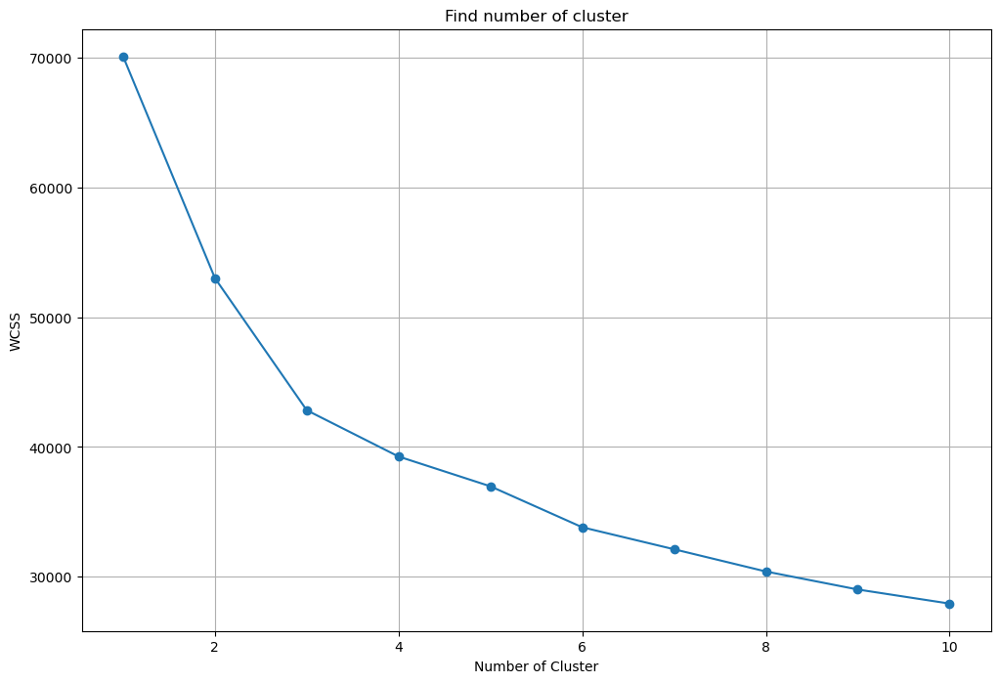

In [179]:
# plot the result

plt.figure(figsize=(12,8))
plt.plot(range(1,11),wcss_reduced,marker='o', linestyle = '-')
plt.title('Find number of cluster')
plt.xlabel('Number of Cluster')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

In [180]:
n_clusters = 3

# fit the KMeans model

kmeans = KMeans(n_clusters=n_clusters,random_state=42)
kmeans.fit(scaled_data)

# predict the cluster assignments for each row

cluster_assignments = kmeans.predict(scaled_data)

In [181]:
df =df.iloc[:,:-18]

In [182]:
df['furnishing_type'] = cluster_assignments

In [183]:
df.sample(5)[['furnishDetails','furnishing_type']]
#0 => unfurnished
#1 => semi-furnished
#2 => furnished

,furnishDetails,furnishing_type
28,NaN,2
389,NaN,2
443,NaN,2
2557,"['1 Light', 'No AC', 'No Bed', 'No Chimney', '...",2
3872,"['9 Fan', '6 Geyser', '9 Light', '6 AC', 'No B...",0


## 5. feature

In [184]:
df[['society','features']].sample(5)

,society,features
2372,eden landmark,NaN
1870,mapsko mount ville,"['Security / Fire Alarm', 'Power Back-up', 'Fe..."
3550,independent,NaN
1368,emaar mgf emerald floors premier,"['Security / Fire Alarm', 'Feng Shui / Vaastu ..."
2657,shapoorji pallonji joyville gurugram,"['Security / Fire Alarm', 'Feng Shui / Vaastu ..."


In [185]:
df['features'].isnull().sum()

676

In [186]:
app_df = pd.read_excel('real_estate_data.xlsx')
app_df.head(2)

,PropertyName,PropertySubName,NearbyLocations,LocationAdvantages,Link,PriceDetails,TopFacilities
0,Smartworld One DXP,"2, 3, 4 BHK Apartment in Sector 113, Gurgaon","['Bajghera Road', 'Palam Vihar Halt', 'DPSG Pa...","{'Bajghera Road': '800 Meter', 'Palam Vihar Ha...",https://www.99acres.com/smartworld-one-dxp-sec...,"{'2 BHK': {'building_type': 'Apartment', 'area...","['Swimming Pool', 'Salon', 'Restaurant', 'Spa'..."
1,M3M Crown,"3, 4 BHK Apartment in Sector 111, Gurgaon","['DPSG Palam Vihar Gurugram', 'The NorthCap Un...","{'DPSG Palam Vihar Gurugram': '1.4 Km', 'The N...",https://www.99acres.com/m3m-crown-sector-111-g...,"{'3 BHK': {'building_type': 'Apartment', 'area...","['Bowling Alley', 'Mini Theatre', 'Manicured G..."


In [187]:
app_df['PropertyName'] = app_df['PropertyName'].str.lower()

In [188]:
temp_df = df[df['features'].isnull()]

In [189]:
temp_df.shape

(676, 26)

In [190]:
temp_df

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,study room,5.0,NA,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",[],NaN,1345.00,NaN,NaN,0,1,0,0,0,2
5,flat,signature global infinity mall,sector 36,0.41,6269.0,654.0,Built Up area: 654 (60.76 sq.m.),2,2,3,not available,3.0,NA,Undefined,NaN,NaN,NaN,NaN,654.0,NaN,0,0,0,0,0,2
6,flat,the cocoon,sector 104,2.00,13333.0,1500.0,Super Built up area 1500(139.35 sq.m.),3,3,3,not available,5.0,NA,New Property,"['Shri Multispeciality Hospital', 'Esic Hospit...",[],NaN,1500.00,NaN,NaN,0,0,0,0,0,2
12,flat,supertech araville,sector 79,1.35,6940.0,1945.0,Carpet area: 1945 (180.7 sq.m.),3,3,3,not available,4.0,NA,Relatively New,"['Petrol Pump Indian Oil', 'Petrol Pump', 'Rao...","['1 Water Purifier', '2 Fan', '1 Geyser', '3 L...",NaN,NaN,NaN,1945.000000,0,0,0,0,0,2
13,flat,godrej,sector 33,0.95,6859.0,1385.0,Super Built up area 1385(128.67 sq.m.),2,2,3+,not available,3.0,South-East,Under Construction,NaN,NaN,NaN,1385.00,NaN,NaN,0,0,0,0,0,2
15,flat,sobha city,sector 108,3.95,16859.0,2343.0,Built Up area: 2343 (217.67 sq.m.)Carpet area:...,4,5,3,not available,25.0,NA,Undefined,"['Dwarka Sector 21', 'Dwarka Expressway', 'Vas...","['1 Light', 'No AC', 'No Bed', 'No Chimney', '...",NaN,NaN,2343.0,2300.000000,0,0,0,0,0,2
16,flat,senate court,sector 62,0.90,14084.0,639.0,Built Up area: 639 (59.37 sq.m.),1,1,0,not available,0.0,NA,Undefined,"['Radhakrishna Shani Mandir', 'Sanatan Dharm M...",NaN,NaN,NaN,639.0,NaN,0,0,0,0,0,2
22,flat,smart world gems,sector 89,0.86,7796.0,1103.0,Super Built up area 1103(102.47 sq.m.),2,3,3,not available,4.0,NA,Under Construction,"['Sant Soordas Sihi Metro Station', 'Airia Mal...",[],NaN,1103.00,NaN,NaN,0,0,0,0,0,2
25,flat,the serenas,sector 36,0.42,7910.0,531.0,Carpet area: 531 (49.33 sq.m.),2,2,1,not available,3.0,NA,Undefined,NaN,"['1 Wardrobe', '1 Fan', '1 Light', 'No AC', 'N...",NaN,NaN,NaN,531.000000,0,0,0,0,0,2
26,flat,m3m golfestate,sector 65,6.15,18331.0,3355.0,Built Up area: 3355 (311.69 sq.m.)Carpet area:...,3,4,2,not available,20.0,North-East,Undefined,"['Sector 54 Chowk Metro Station', 'Sahara Mall...",NaN,NaN,NaN,3355.0,2200.000000,0,0,0,0,0,2


In [191]:
x = temp_df.merge(app_df,left_on='society',right_on='PropertyName',how='left')['TopFacilities']

In [192]:
x.values

array([nan, nan, nan, nan, nan,
       "['Swimming Pool', 'Volley Ball Court', 'Aerobics Centre', 'Card Room', 'Barbecue', 'Sauna', 'Steam Room', 'Creche/Day care', 'Skating Rink']",
       nan,
       "['Swimming Pool', 'Lounge', 'Aerobics Centre', 'Terrace Garden', 'Piped Gas', 'Squash Court', 'Gazebo', 'Wi-Fi Connectivity', 'Sun Deck']",
       nan,
       "['Mini Theatre', 'Doctor on Call', 'Beach Volley Ball Court', 'Air Hockey', 'Automated Car Wash', 'Clinic', 'Foosball', 'Concierge Service', 'Car wash area']",
       "['Mini Theatre', 'Foosball', 'Swimming Pool', 'Flower Garden', 'Salon', 'ATM', 'Card Room', 'Piped Gas', 'Grocery Shop']",
       nan, nan,
       "['Swimming Pool', 'School', 'Sauna', 'Steam Room', 'Billiards', 'Fountain', 'Shopping Centre', 'Lawn Tennis Court', 'Earthquake Resistant']",
       nan, nan, nan,
       "['Swimming Pool', 'School', 'Jacuzzi', 'Shopping Centre', 'Multipurpose Court', 'Community Hall', '24x7 Security', 'Club House', '24/7 Power Backup']

In [193]:
df.loc[temp_df.index].shape

(676, 26)

In [194]:
df.loc[temp_df.index,'features'] = x.values

In [195]:
x.shape

(676,)

In [196]:
df['features'].isnull().sum()

520

In [197]:
from sklearn.preprocessing import MultiLabelBinarizer
import ast

In [198]:
# convert the string representation of lists in the 'features' column to actual lists

df['features_list'] = df['features'].apply(lambda x: ast.literal_eval(x) if pd.notnull(x) and x.startswith('[') else [])

# Use multilabelBinarizer to convert the features list into a binary metrix
mlb = MultiLabelBinarizer()
features_binary_metrix = mlb.fit_transform(df['features_list'])

# convert the binary metrix into Dataframe
features_binary_df = pd.DataFrame(features_binary_metrix,columns=mlb.classes_)

In [199]:
features_binary_df.sample(5)

,24/7 Power Backup,24/7 Water Supply,24x7 Security,ATM,Aerobics Centre,Air Hockey,Airy Rooms,Amphitheatre,Automated Car Wash,Badminton Court,Bank Attached Property,Banquet Hall,Bar/Chill-Out Lounge,Barbecue,Basketball Court,Beach Volley Ball Court,Billiards,Bowling Alley,Bus Shelter,Business Lounge,CCTV Camera Security,Cafeteria,Car Parking,Car wash area,Card Room,Centrally Air Conditioned,Changing Area,Children's Play Area,Cigar Lounge,Clinic,Club House,Club house / Community Center,Community Hall,Concierge Service,Conference room,Creche/Day care,Cricket Pitch,Doctor on Call,Earthquake Resistant,Entrance Lobby,False Ceiling Lighting,Feng Shui / Vaastu Compliant,Fire Fighting Systems,Fitness Centre / GYM,Flower Garden,Food Court,Foosball,Football,Fountain,Gated Community,Gazebo,Golf Course,Grocery Shop,Gymnasium,High Ceiling Height,High Speed Elevators,Infinity Pool,Intercom Facility,Internal Street Lights,Internet/wi-fi connectivity,Jacuzzi,Jogging Track,Landscape Garden,Laundry,Lawn Tennis Court,Library,Lift(s),Lounge,Low Density Society,Maintenance Staff,Manicured Garden,Medical Centre,Milk Booth,Mini Theatre,Multipurpose Court,Multipurpose Hall,Natural Light,Natural Pond,No open drainage around,Park,Party Lawn,Pergola,Piped Gas,Piped-gas,Pool Table,Power Back up Lift,Power Back-up,Private Garden / Terrace,Property Staff,RO System,Rain Water Harvesting,Reading Lounge,Recently Renovated,Reflexology Park,Restaurant,Salon,Sauna,School,Security / Fire Alarm,Security Personnel,Separate entry for servant room,Sewage Treatment Plant,Shopping Centre,Skating Rink,Solar Lighting,Solar Water Heating,Spa,Spacious Interiors,Squash Court,Steam Room,Sun Deck,Swimming Pool,Temple,Terrace Garden,Theatre,Toddler Pool,Valet Parking,Vastu Compliant,Video Door Security,Visitor Parking,Visitors Parking,Volley Ball Court,Waiting Lounge,Waste Disposal,Water Softener Plant,Water Storage,Water purifier,Water softening plant,Wi-Fi Connectivity,Yoga/Meditation Area
2925,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
250,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3693,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,0,1,1,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0
3805,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0
2860,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0


In [200]:
# Define the weights for each feature as provided
# Assigning weights based on perceived luxury contribution
weights = {
     '24/7 Power Backup': 8,
    '24/7 Water Supply': 4,
    '24x7 Security': 7,
    'ATM': 4,
    'Aerobics Centre': 6,
    'Airy Rooms': 8,
    'Amphitheatre': 7,
    'Badminton Court': 7,
    'Banquet Hall': 8,
    'Bar/Chill-Out Lounge': 9,
    'Barbecue': 7,
    'Basketball Court': 7,
    'Billiards': 7,
    'Bowling Alley': 8,
    'Business Lounge': 9,
    'CCTV Camera Security': 8,
    'Cafeteria': 6,
    'Car Parking': 6,
    'Card Room': 6,
    'Centrally Air Conditioned': 9,
    'Changing Area': 6,
    "Children's Play Area": 7,
    'Cigar Lounge': 9,
    'Clinic': 5,
    'Club House': 9,
    'Concierge Service': 9,
    'Conference room': 8,
    'Creche/Day care': 7,
    'Cricket Pitch': 7,
    'Doctor on Call': 6,
    'Earthquake Resistant': 5,
    'Entrance Lobby': 7,
    'False Ceiling Lighting': 6,
    'Feng Shui / Vaastu Compliant': 5,
    'Fire Fighting Systems': 8,
    'Fitness Centre / GYM': 8,
    'Flower Garden': 7,
    'Food Court': 6,
    'Foosball': 5,
    'Football': 7,
    'Fountain': 7,
    'Gated Community': 7,
    'Golf Course': 10,
    'Grocery Shop': 6,
    'Gymnasium': 8,
    'High Ceiling Height': 8,
    'High Speed Elevators': 8,
    'Infinity Pool': 9,
    'Intercom Facility': 7,
    'Internal Street Lights': 6,
    'Internet/wi-fi connectivity': 7,
    'Jacuzzi': 9,
    'Jogging Track': 7,
    'Landscape Garden': 8,
    'Laundry': 6,
    'Lawn Tennis Court': 8,
    'Library': 8,
    'Lounge': 8,
    'Low Density Society': 7,
    'Maintenance Staff': 6,
    'Manicured Garden': 7,
    'Medical Centre': 5,
    'Milk Booth': 4,
    'Mini Theatre': 9,
    'Multipurpose Court': 7,
    'Multipurpose Hall': 7,
    'Natural Light': 8,
    'Natural Pond': 7,
    'Park': 8,
    'Party Lawn': 8,
    'Piped Gas': 7,
    'Pool Table': 7,
    'Power Back up Lift': 8,
    'Private Garden / Terrace': 9,
    'Property Staff': 7,
    'RO System': 7,
    'Rain Water Harvesting': 7,
    'Reading Lounge': 8,
    'Restaurant': 8,
    'Salon': 8,
    'Sauna': 9,
    'Security / Fire Alarm': 9,
    'Security Personnel': 9,
    'Separate entry for servant room': 8,
    'Sewage Treatment Plant': 6,
    'Shopping Centre': 7,
    'Skating Rink': 7,
    'Solar Lighting': 6,
    'Solar Water Heating': 7,
    'Spa': 9,
    'Spacious Interiors': 9,
    'Squash Court': 8,
    'Steam Room': 9,
    'Sun Deck': 8,
    'Swimming Pool': 8,
    'Temple': 5,
    'Theatre': 9,
    'Toddler Pool': 7,
    'Valet Parking': 9,
    'Video Door Security': 9,
    'Visitor Parking': 7,
    'Water Softener Plant': 7,
    'Water Storage': 7,
    'Water purifier': 7,
    'Yoga/Meditation Area': 7
}
# Calculate luxury score for each row
luxury_score = features_binary_df[list(weights.keys())].multiply(list(weights.values())).sum(axis=1)

In [201]:
df['luxury_score'] = luxury_score

In [202]:
df['luxury_score'].fillna(0, inplace=True)

In [203]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,features_list,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,not available,4.0,West,Relatively New,"['Chintapurni Mandir', 'State bank ATM', 'Pear...","['3 Fan', '4 Light', '1 Wardrobe', 'No AC', 'N...","['Feng Shui / Vaastu Compliant', 'Security / F...",NaN,NaN,900.0,0,0,0,0,0,2,"[Feng Shui / Vaastu Compliant, Security / Fire...",28.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,not available,1.0,West,Old Property,"['Chintapurni Mandir', 'Sheetla Mata Mandir', ...","['3 Wardrobe', '4 Fan', '1 Exhaust Fan', '1 Ge...","['Security / Fire Alarm', 'Maintenance Staff',...",NaN,NaN,650.0,0,0,0,0,0,0,"[Security / Fire Alarm, Maintenance Staff, Wat...",37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,not available,12.0,NA,New Property,"['Huda City Metro', 'Golf Course extn road', '...",NaN,"['Power Back-up', 'Feng Shui / Vaastu Complian...",NaN,NaN,595.0,0,0,0,0,0,2,"[Power Back-up, Feng Shui / Vaastu Compliant, ...",36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,study room,2.0,NA,Undefined,"['Sector 55-56 Metro station', 'Bestech Centra...",NaN,"['Security / Fire Alarm', 'Private Garden / Te...",NaN,NaN,1200.0,0,1,0,0,0,2,"[Security / Fire Alarm, Private Garden / Terra...",76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,study room,5.0,NA,Under Construction,"['Yadav Clinic', 'Bangali Clinic', 'Dr. J. S. ...",[],NaN,1345.0,NaN,NaN,0,1,0,0,0,2,[],0.0


In [204]:
# cols to drap -> nearbylocations, furnishDetails, features, features_list, assitionalRoom
df.drop(columns=['nearbyLocations','furnishDetails','features','features_list','additionalRoom'], inplace=True)

In [205]:
df.sample(5)

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
2210,flat,shri ram apartments,sector 43,0.32,3368.0,950.0,Carpet area: 950 (88.26 sq.m.),2,2,1,4.0,NA,Relatively New,NaN,NaN,950.00,0,0,0,0,0,0,49.0
1084,flat,tulip violet,sector 69,1.52,9632.0,1578.0,Super Built up area 1578(146.6 sq.m.),3,3,2,4.0,South-West,Relatively New,1578.0,NaN,NaN,0,0,0,1,0,0,96.0
2123,flat,smart world orchard,sector 61,2.50,16139.0,1549.0,Built Up area: 1549 (143.91 sq.m.),3,3,1,1.0,East,Undefined,NaN,1549.0,NaN,0,0,0,0,0,2,67.0
803,flat,la vida by tata housing,sector 113,2.35,13352.0,1760.0,Super Built up area 2217(205.97 sq.m.)Built Up...,3,4,3,3.0,West,Relatively New,2217.0,1930.0,1760.00,1,0,0,0,0,2,142.0
1282,flat,sobha city,sector 108,3.95,16858.0,2343.0,Super Built up area 2343(217.67 sq.m.)Carpet a...,3,5,2,15.0,North,New Property,2343.0,NaN,1512.05,1,0,0,0,0,2,49.0


In [206]:
df.shape

(3894, 23)

In [207]:
df['luxury_score'].isnull().sum()

0

## EDA (Exploratory Data Analysis)

### Univeriant Analysis

In [208]:
df.shape

(3894, 23)

In [209]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3894 entries, 0 to 3960
Data columns (total 23 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Property_type        3894 non-null   object 
 1   society              3894 non-null   object 
 2   sector               3894 non-null   object 
 3   price                3875 non-null   float64
 4   Price_Per_sqFeets    3875 non-null   float64
 5   area                 3875 non-null   float64
 6   areaWithType         3894 non-null   object 
 7   bedRoom              3894 non-null   int32  
 8   bathroom             3894 non-null   int32  
 9   balcony              3894 non-null   object 
 10  floorNum             3873 non-null   float64
 11  facing               3894 non-null   object 
 12  agePossession        3894 non-null   object 
 13  super_built_up_area  1925 non-null   float64
 14  built_up_area        1805 non-null   float64
 15  carpet_area          1977 non-null   f

In [210]:
df.duplicated().sum()

15

In [211]:
df.drop_duplicates(inplace=True)

In [212]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,4.0,West,Relatively New,NaN,NaN,900.0,0,0,0,0,0,2,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,1.0,West,Old Property,NaN,NaN,650.0,0,0,0,0,0,0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,12.0,NA,New Property,NaN,NaN,595.0,0,0,0,0,0,2,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,2.0,NA,Undefined,NaN,NaN,1200.0,0,1,0,0,0,2,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,5.0,NA,Under Construction,1345.0,NaN,NaN,0,1,0,0,0,2,0.0


### Property_type

<Axes: >

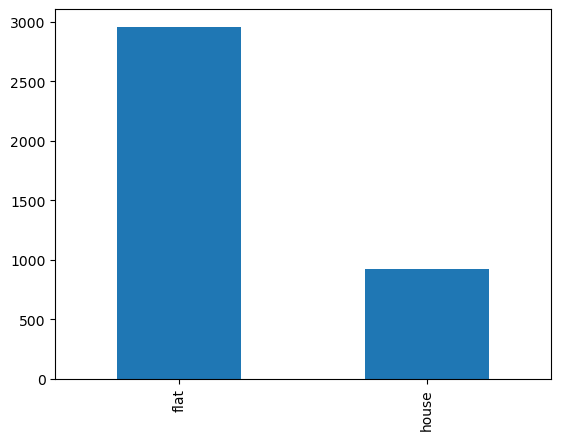

In [213]:
df['Property_type'].value_counts().plot(kind='bar')

#### Observations:
- Flats are in majority(75 percent) and there are less number of houses(~25 percent)
- No missing values

### Society

In [214]:
df['society'].value_counts().shape

(703,)

In [215]:
df['society'].value_counts()

independent                                          533
tulip violet                                          75
ss the leaf                                           74
shapoorji pallonji joyville gurugram                  45
dlf new town heights                                  42
signature global park                                 36
shree vardhman victoria                               35
smart world orchard                                   33
emaar mgf emerald floors premier                      32
paras dews                                            31
dlf the ultima                                        31
smart world gems                                      31
dlf regal gardens                                     30
m3m woodshire                                         30
shree vardhman flora                                  29
la vida by tata housing                               28
signature global solera                               27
godrej nature plus             

In [216]:
df[df['society'] != 'independent']['society'].value_counts(normalize=True).cumsum().head(75)

tulip violet                            0.022415
ss the leaf                             0.044531
shapoorji pallonji joyville gurugram    0.057980
dlf new town heights                    0.070532
signature global park                   0.081291
shree vardhman victoria                 0.091751
smart world orchard                     0.101614
emaar mgf emerald floors premier        0.111178
dlf the ultima                          0.120442
paras dews                              0.129707
smart world gems                        0.138972
dlf regal gardens                       0.147938
m3m woodshire                           0.156904
shree vardhman flora                    0.165571
la vida by tata housing                 0.173939
godrej nature plus                      0.182008
signature global solera                 0.190078
bptp terra                              0.197549
emaar gurgaon greens                    0.205021
experion the heartsong                  0.212194
tata primanti       

In [217]:
society_count = df['society'].value_counts()

#Frequency distribution for societies

frequency_bins = {
    'Very High (>100)':(society_count >100).sum(),
    'High (50-100)': (society_count>=50).sum(),
    'Average(10-49)': (society_count>=10).sum(),
    'Low (2-9)':(society_count<10).sum(),
    'Very Low (1)':(society_count == 1).sum()
}

In [218]:
frequency_bins

{'Very High (>100)': 1,
 'High (50-100)': 3,
 'Average(10-49)': 98,
 'Low (2-9)': 605,
 'Very Low (1)': 308}

<Axes: >

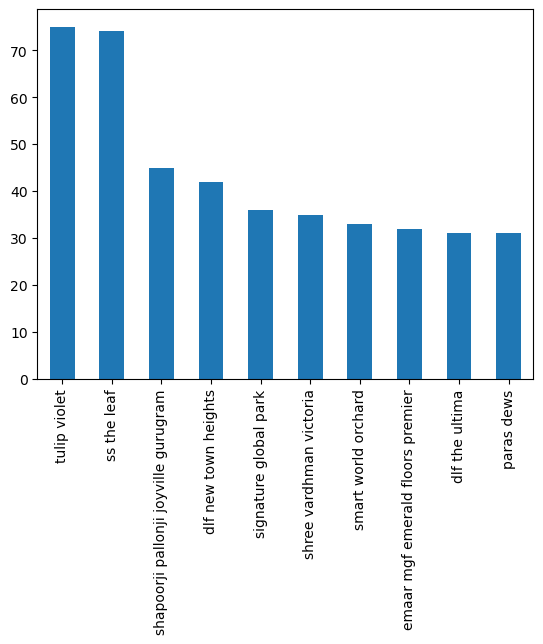

In [219]:
#Top 10 socities
df[df['society'] != 'independent']['society'].value_counts().head(10).plot(kind='bar')

In [220]:
df['society'].isnull().sum()

0

### Observations:

- Around 13% properties comes under independent tag
- There are 702 societies
- The top 75 societies have 50% of the properties and the rest of percent of the properties comes under the remaining 600 societies
    - Very High(>100): Only 1 society has more than 100 entries
    - High (50-100): 3 societies have 50-100 entries
    - Average(10-49): 98 societies have 10-49 entries
    - Low(2-9): 605 societies have 2 to 9 entries
    - Very Low (1): 308 socities have only 1 entries

### Sector

In [221]:
# unique Sectors
df['sector'].value_counts().shape

(96,)

<Axes: >

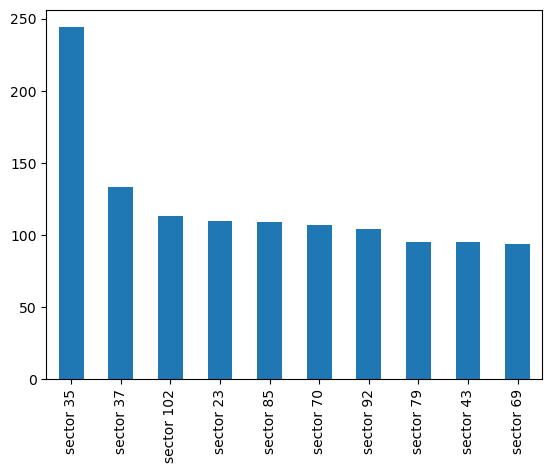

In [222]:
# Top 10 Sectors
df['sector'].value_counts().head(10).plot(kind='bar')

In [223]:
# Frequency distribution for sectors

sector_counts = df['sector'].value_counts()

sector_frequency_bins = {
    'Very High (>100)': (sector_counts > 100).sum(),
    'High (50-100)': ((sector_counts >= 50) & (sector_counts <= 100)).sum(),
    'Average (10-49)':((sector_counts >= 10) & (sector_counts < 50)).sum(),
    'Low (2-9)': ((sector_counts >=2) & (sector_counts < 10)).sum(),
    'Very Low (1)': (sector_counts == 1).sum()
}

In [224]:
sector_frequency_bins

{'Very High (>100)': 7,
 'High (50-100)': 22,
 'Average (10-49)': 51,
 'Low (2-9)': 16,
 'Very Low (1)': 0}

### Observations:

- There are total of 98 sectors in the dataset
- Frequency distribution of the sector:
    - Very High (>100): 6 sectors have more than 100 entries
    - High (50-100) : 23 sectors have entries between 50 to 100
    - Average (10-49): 52 sectors have entries between 10 to 49
    - Low (2-9): 16 sectors have entries between 2 to 9
    - Very Low (1): 1 sectors have only one entry

## Price

In [225]:
df['price'].isnull().sum()

19

In [226]:
df['price'].describe()

count    3860.000000
mean        2.497850
std         2.942454
min         0.070000
25%         0.920000
50%         1.500000
75%         2.700000
max        31.500000
Name: price, dtype: float64

<Axes: xlabel='price', ylabel='Count'>

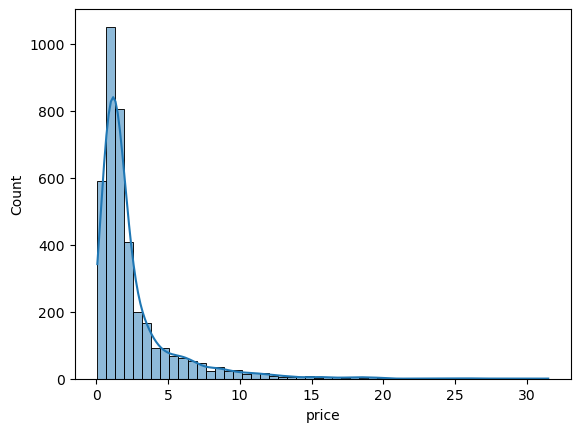

In [227]:
sns.histplot(df['price'], kde=True, bins=50)

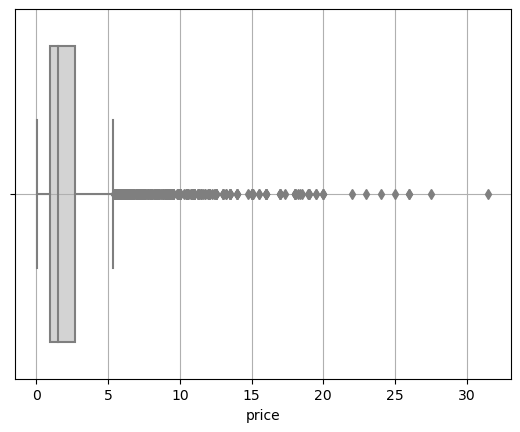

In [228]:
sns.boxplot(x=df['price'], color='lightgrey')
plt.grid()

### Descriptive Statistics:

- Count There are 3747 non-missing price listing
- Mean Price: The average price approximately 2.53 crores.
- Median Price: The median (or 50th percentile) price is 1.52 crores.
- Standard Deviation:The prices have a standard deviation of 2.98, indicating data variability in the prices.
- Range: Prices range from a minimum of 0.07 crores to a maximum of 31.5 crores.
- IQR: The Interquartile range (difference between 75th and 25th percentile) is from 0.95 crores to 2.75 crores.

### Visualizations:

- Distribution: The histogram indicates the most properties are priced in the lower range (below 5 crores), with a few proparties going beyond 10 crores.
- Box Plot: The box plot showcases the spread of the data and potential outliers. Properties priced above approximately 10 crores might be considered outliers as they lie beyond the upper whisker of the box plot.

#### Missing Values: There are 18 missing values in the price column.

In [229]:
# Skewness and Kurtosis
skewness = df['price'].skew()
kurtosis = df['price'].kurt()

print(skewness, kurtosis)

3.3114132107153655 15.25867965827364


<b>Skewness</b>:The price distribution has a skewness of approximately 3.31, indicating a positive skew. This means that the distribution tail is skewed to right, which aligns with our observation from the histogram where most properties have prices on the lower end  with a few high-priced properties.

<b>Kurtosis</b>: The kurtosis value is approximately 15.25. A kurtosis value greater than 3 indicates distribution with heavier tails and more outliers compared to a normal distribution.

In [230]:
# Quantile Analysis
quantiles = df['price'].quantile([0.01, 0.05, 0.95, 0.99])

quantiles

0.01     0.2500
0.05     0.3700
0.95     8.4805
0.99    15.0410
Name: price, dtype: float64

### Quantile Analysis:

- 1% Quantile: Only 1% of properties are priced below 0.25 crores.
- 5% Quantile: 5% of properties are priced below 0.37 crores.
- 95% Quantile: 95% of properties are priced below 8.48 crores.
- 99% Quantile: 99% of properties are priced below 15.04 crores, indicating that very few properties are priced above this value.

In [231]:
# Identify potential outliers using IQR method

Q1 = df['price'].describe()['25%']
Q3 = df['price'].describe()['75%']

IQR = Q3-Q1
IQR

1.7800000000000002

In [232]:
lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR

print(lower_bound, upper_bound)

-1.7500000000000004 5.370000000000001


In [233]:
outliers = df[(df['price'] <lower_bound) | (df['price'] > upper_bound)]
outliers.shape

(440, 23)

In [234]:
outliers['price'].describe()

count    440.000000
mean       9.175432
std        4.051055
min        5.400000
25%        6.375000
50%        8.000000
75%       10.552500
max       31.500000
Name: price, dtype: float64

### Outliers Analysis (using IQR method):

- Based on the IQR method, there are 440 properties considered as outliers.
- These outliers have an average price of approximately 9.17 crores.
- The range for these outliers is from 6.44 crores to 31.5 crores

<Axes: >

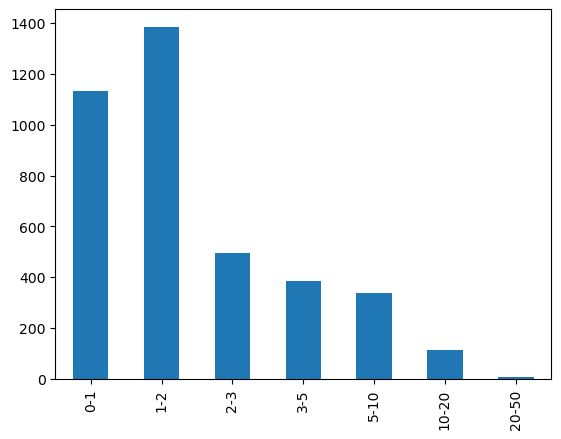

In [235]:
# price binning
bins = [0, 1, 2, 3, 5, 10, 20, 50]
bin_labels = ['0-1', '1-2', '2-3', '3-5', '5-10', '10-20', '20-50']
pd.cut(df['price'],bins=bins, labels=bin_labels, right=True).value_counts().sort_index().plot(kind='bar')

- The majority of properties are priced in the '1-2 crores' and '2-3 crores' ranges
- There's a significant drop in the number of properties priced above '5 crores'

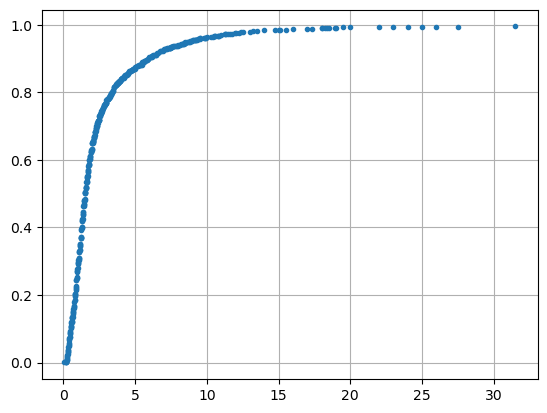

In [236]:
# ecdf plot
ecdf = df['price'].value_counts().sort_index().cumsum()/len(df['price'])
plt.plot(ecdf.index, ecdf, marker='.', linestyle='none')
plt.grid()

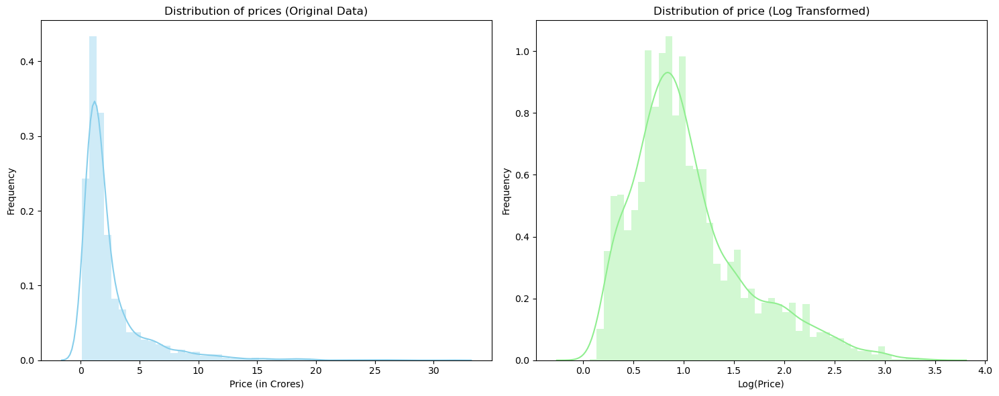

In [237]:
plt.figure(figsize=(15, 6))

# Distribution plot without log transformation
plt.subplot(1, 2, 1)
sns.distplot(df['price'], kde=True, bins=50,color='skyblue')
plt.title('Distribution of prices (Original Data)')
plt.xlabel('Price (in Crores)')
plt.ylabel('Frequency')

# Distribution plot with log transformation
plt.subplot(1,2,2)
sns.distplot(np.log1p(df['price']), kde=True, bins=50, color='lightgreen')
plt.title('Distribution of price (Log Transformed)')
plt.xlabel('Log(Price)')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

np.log1p(x). This function computes the natural logarithm of 1+x. It's designed to provide more accurate results for values of x that are very close to zero.

Using np.log1p helps in transforming the price column while ensuring the any any value (including zero, if present) is handed appropriately.When we need to reverse the transformation, we can use np.expm1 which is computes e^x-1.

In [238]:
skewness = np.log1p(df['price']).skew()
kurtosis = np.log1p(df['price']).kurt()

print(skewness, kurtosis)

1.083205459994121 1.0064127704777497


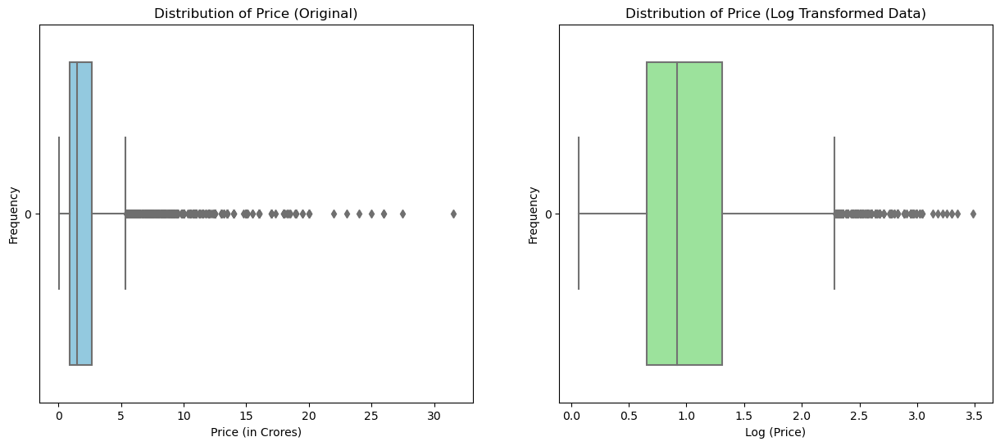

In [239]:
## Box Plot with log transformed data

plt.figure(figsize=(15, 6))

# Distribution plot without log transformation
plt.subplot(1, 2, 1)
sns.boxplot(df['price'], color='skyblue',orient='h')
plt.title('Distribution of Price (Original)')
plt.xlabel('Price (in Crores)')
plt.ylabel('Frequency')

# Distribution plot with Log transformation
plt.subplot(1, 2, 2)
sns.boxplot(np.log1p(df['price']), color='lightgreen',orient='h')
plt.title('Distribution of Price (Log Transformed Data)')
plt.xlabel('Log (Price)')
plt.ylabel('Frequency')

# plt.tight_layout()
plt.show()

### Price_per_sqFeets

In [240]:
df['Price_Per_sqFeets'].isnull().sum()

19

In [241]:
df['Price_Per_sqFeets'].describe()

count      3860.000000
mean      13898.733938
std       23131.263707
min           4.000000
25%        6810.250000
50%        9004.500000
75%       13801.750000
max      600000.000000
Name: Price_Per_sqFeets, dtype: float64

<Axes: xlabel='Price_Per_sqFeets', ylabel='Count'>

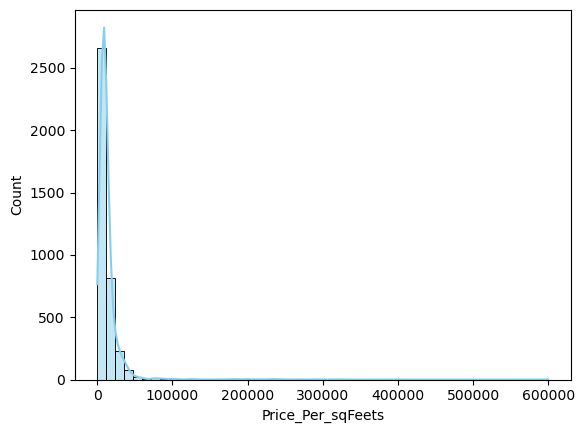

In [242]:
sns.histplot(df['Price_Per_sqFeets'], bins=50, color='skyblue', kde=True)

Most properties have a price_per_sqFeets ranging between approximately 0 and 40,000. There is a significant concentration in the lower range, with few properties having exceptionally high price_per_sqfeets.

<Axes: >

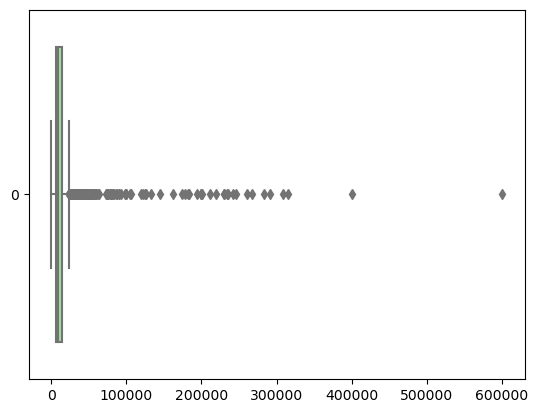

In [243]:
sns.boxplot(df['Price_Per_sqFeets'], color='lightgreen', orient='h')

The box plot clearly shows several outliers, especially on the higher side. The interquartile range (IQR) is relativaly compact, but there are many data point beyond the 'whiskers' of the box plot, indicating potential outliers

### Observation:

- Potential Outliers
- Right skewed data
- 19 missing values

## bedRoom

In [244]:
df['bedRoom'].isnull().sum()

0

<Axes: >

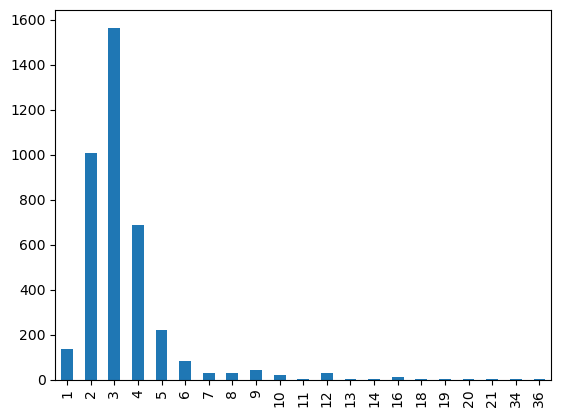

In [245]:
df['bedRoom'].value_counts().sort_index().plot(kind='bar')

<Axes: ylabel='bedRoom'>

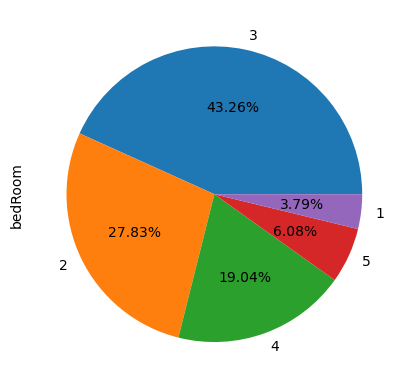

In [246]:
df['bedRoom'].value_counts(normalize=True).head().plot(kind='pie',autopct='%0.2f%%')

### Bathroom

In [247]:
df['bathroom'].isnull().sum()

0

In [248]:
df['bathroom'].value_counts()

3     1136
2     1129
4      848
5      303
1      166
6      121
7       43
9       42
8       27
12      22
10      11
16       8
18       4
11       4
13       4
17       3
20       3
14       2
21       1
36       1
34       1
Name: bathroom, dtype: int64

<Axes: >

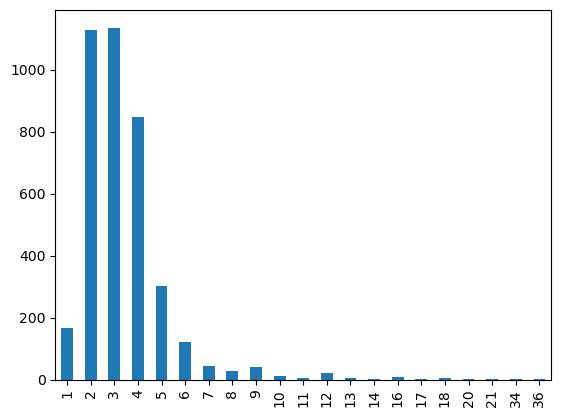

In [249]:
df['bathroom'].value_counts().sort_index().plot(kind='bar')

<Axes: ylabel='bathroom'>

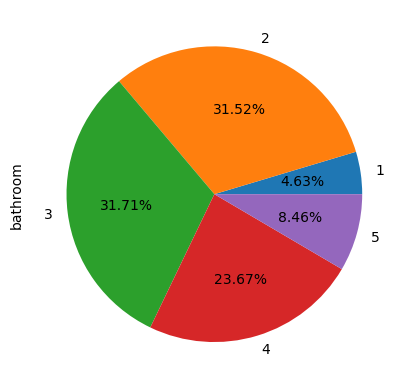

In [250]:
df['bathroom'].value_counts(normalize=True).sort_index().head().plot(kind='pie',autopct='%0.2f%%')

In [251]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,4.0,West,Relatively New,NaN,NaN,900.0,0,0,0,0,0,2,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,1.0,West,Old Property,NaN,NaN,650.0,0,0,0,0,0,0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,12.0,NA,New Property,NaN,NaN,595.0,0,0,0,0,0,2,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,2.0,NA,Undefined,NaN,NaN,1200.0,0,1,0,0,0,2,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,5.0,NA,Under Construction,1345.0,NaN,NaN,0,1,0,0,0,2,0.0


In [252]:
df['balcony'].isnull().sum()

0

In [253]:
df['balcony'].value_counts()

3+    1211
3     1119
2      955
1      401
0      193
Name: balcony, dtype: int64

<Axes: >

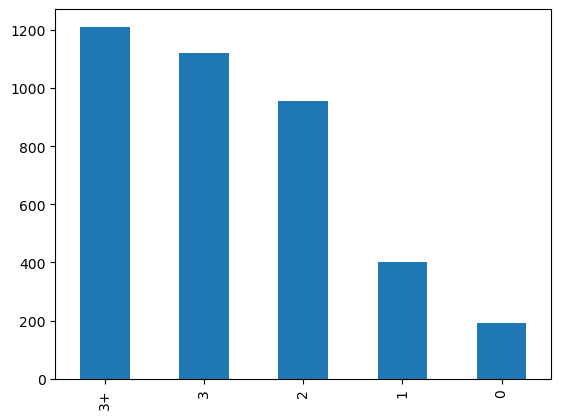

In [254]:
df['balcony'].value_counts().head().plot(kind='bar')

<Axes: ylabel='balcony'>

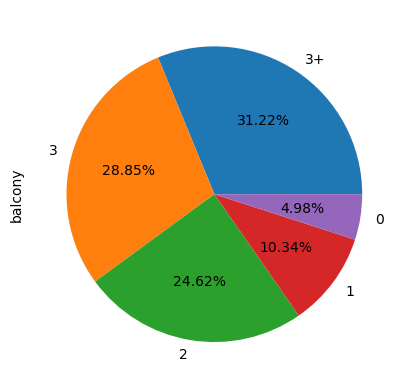

In [255]:
df['balcony'].value_counts(normalize=True).plot(kind='pie', autopct= '%0.2f%%')

## floornum

In [256]:
df['floorNum'].isnull().sum()

21

In [257]:
df['floorNum'].describe()

count    3858.000000
mean        6.719803
std         5.997150
min         0.000000
25%         2.000000
50%         5.000000
75%        10.000000
max        51.000000
Name: floorNum, dtype: float64

<Axes: >

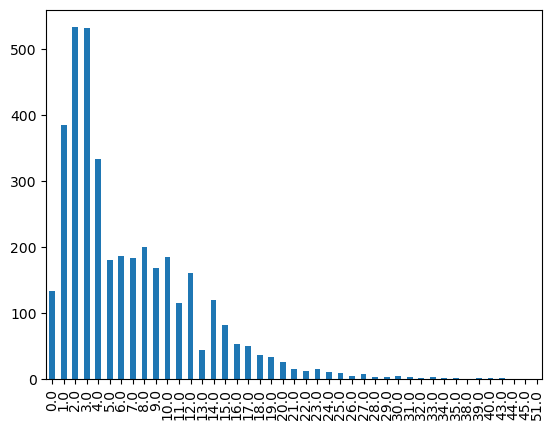

In [258]:
df['floorNum'].value_counts().sort_index().plot(kind='bar')

<Axes: >

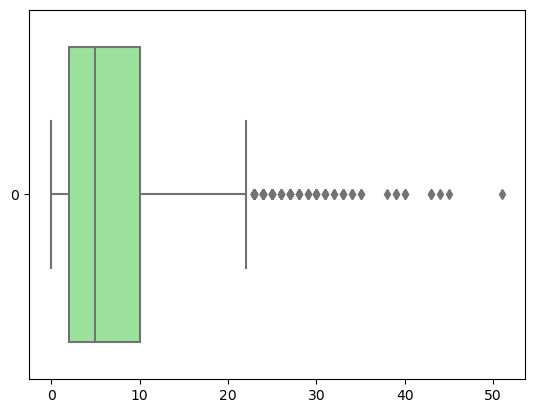

In [259]:
sns.boxplot(df['floorNum'],color='lightgreen',orient='h')

### Observations:

- The majority of the properties lie between the ground floor (0) and the 25th floor
- Floors 1 to 4 are particularly common, with the 3rd floor being the most frequent.
- There are a few proparties located at higher floors, but their frequency is much lower
- The box plot reveal that the majority of the properties are concertrated around the lower floors. The interquartile range (IQR) lies between approximately the 2nd and 10th floors.
- Data points beyond the 'whiskers' of the box plot, especially on the higher side, indicate potential outliers.

### Facing

In [260]:
df['facing'].isnull().sum()

0

In [261]:
df['facing'].fillna('NA',inplace=True)

In [262]:
df['facing'].value_counts()

NA            1137
North-East     657
East           653
North          404
West           254
South          236
North-West     202
South-East     178
South-West     158
Name: facing, dtype: int64

### agePossession

In [263]:
df['agePossession'].isnull().sum()

0

In [264]:
df['agePossession'].value_counts()

Relatively New        1686
New Property           635
Moderately Old         599
Undefined              495
Old Property           333
Under Construction     131
Name: agePossession, dtype: int64

### areas

In [265]:
# super build up area
df['super_built_up_area'].isnull().sum()

1957

In [266]:
df['super_built_up_area'].describe()

count     1922.000000
mean      1918.915999
std        768.595547
min         89.000000
25%       1457.000000
50%       1827.250000
75%       2215.000000
max      10000.000000
Name: super_built_up_area, dtype: float64

<Axes: xlabel='super_built_up_area', ylabel='Count'>

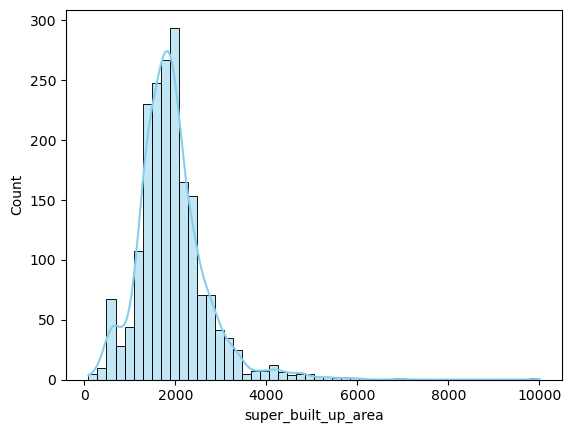

In [267]:
sns.histplot(df['super_built_up_area'].dropna(), bins=50, color='skyblue',kde= True)

<Axes: >

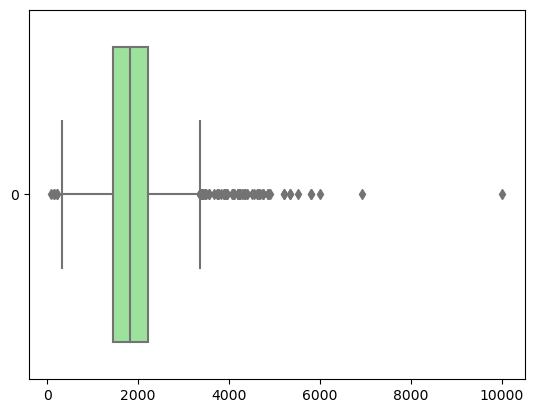

In [268]:
sns.boxplot(df['super_built_up_area'], color='lightgreen',orient='h')

#### Observation:
- Most properties have a super built-up area ranging between approximately 1,000 sq. feets and 2500 sq.feets.
- There are a few properties with a significantly larger area, leading to a right skewed distribution.
- The Interquartile Range (IQR) is a between roughly 1,480 sq. feets and 2,215 sq. feets, indicating that the middle 50% of the properties fall within this range.
- There are serval data points beyond the upper "whisker" of box plot, indicating potential outliers. These are properties with an unusually large super built-up area

In [269]:
# built-up area
df['built_up_area'].isnull().sum()

2078

In [270]:
df['built_up_area'].describe()

count      1801.000000
mean       2329.756229
std       17393.032029
min           2.000000
25%        1070.000000
50%        1628.000000
75%        2367.000000
max      737147.000000
Name: built_up_area, dtype: float64

<Axes: xlabel='built_up_area', ylabel='Count'>

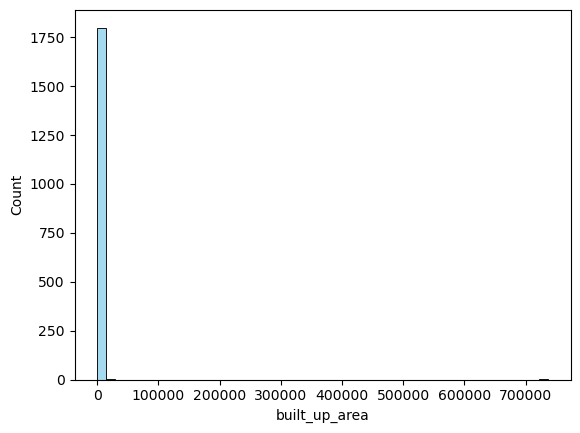

In [271]:
sns.histplot(df['built_up_area'].dropna(), bins=50, color='skyblue', kde=False)

<Axes: >

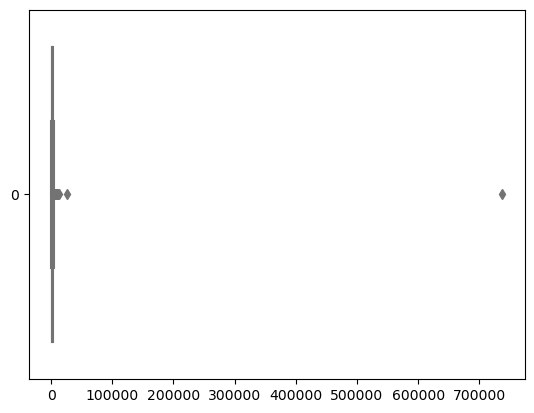

In [272]:
sns.boxplot(df['built_up_area'],color='lightgreen',orient='h')

#### Observation:
- Most properties have a built-up area ranging roughly between 500 sq.feets and 3,500 sq feets.
- There are very few properties with a much larger built-up area leading to a highly right skewed distribution.
- The box plot confirms the presence of significant outliers on the higher side. The data's interquantile range (IQR) is relatively compact but the "whiskers" of the box plot are streched due to outliers.

The presence of extreme values, especially on the higher side, suggests that there may be outliers or data error. This could also be due to some properties being exceptionaly large, like a commercial complex or an entire building being listed.

In [273]:
# carpet area
df['carpet_area'].isnull().sum()

1912

In [274]:
df['carpet_area'].describe()

count      1967.000000
mean       2466.131626
std       22244.600434
min          15.000000
25%         822.000000
50%        1280.000000
75%        1775.000000
max      607936.000000
Name: carpet_area, dtype: float64

<Axes: xlabel='carpet_area', ylabel='Count'>

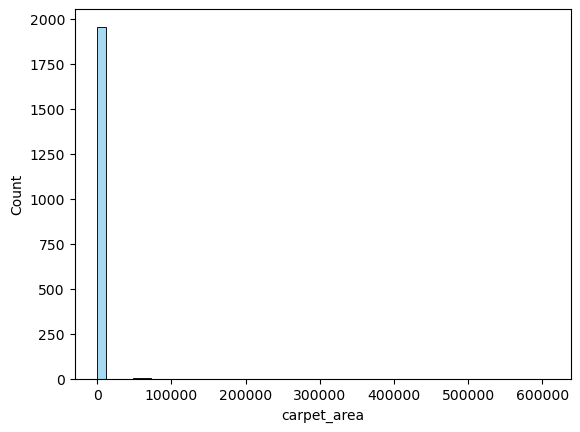

In [275]:
sns.histplot(df['carpet_area'].dropna(), bins=50, color='skyblue',kde=False)

<Axes: >

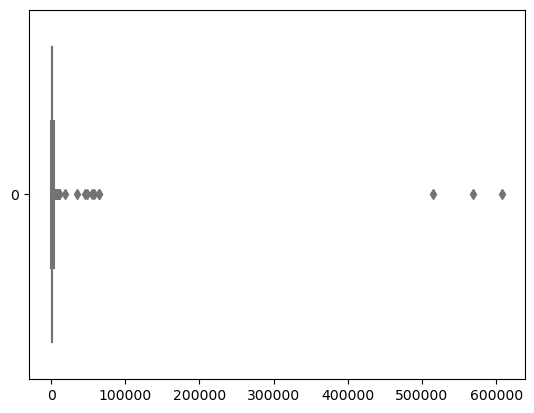

In [276]:
sns.boxplot(df['carpet_area'], color='lightgreen',orient='h')

In [277]:
df.iloc[:,16:]

,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,0,0,0,0,0,2,28.0
1,0,0,0,0,0,0,37.0
2,0,0,0,0,0,2,36.0
3,0,1,0,0,0,2,76.0
4,0,1,0,0,0,2,0.0
5,0,0,0,0,0,2,0.0
6,0,0,0,0,0,2,0.0
7,0,0,0,0,0,2,60.0
8,0,1,0,0,0,2,58.0
9,1,0,0,0,0,2,100.0


### Additional rooms

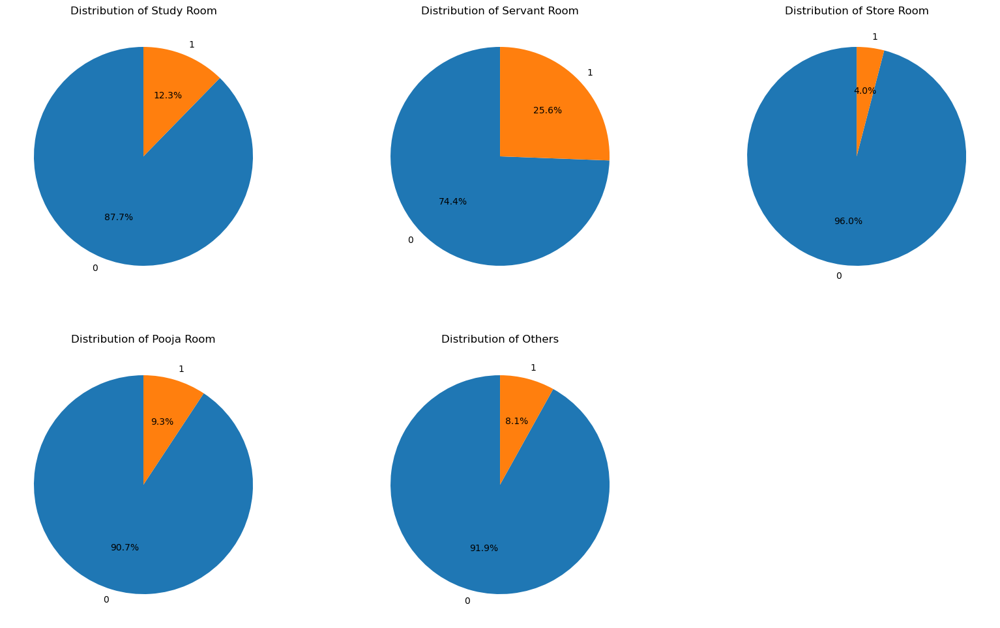

In [278]:
plt.figure(figsize=(20,12))

#create a subplot of pie charts for each room type
for idx, room in enumerate(['study room', 'servant room', 'store room', 'pooja room', 'others'],1):
    ax = plt.subplot(2,3,idx)
    df[room].value_counts().plot(kind='pie',autopct='%1.1f%%',startangle=90, ax=ax)
    plt.title(f'Distribution of {room.title()}')
    plt.ylabel('')
    
plt.show()

### furnishing_type

In [279]:
df['furnishing_type'].isnull().sum()

0

In [280]:
df['furnishing_type'].value_counts()

2    2567
0    1092
1     220
Name: furnishing_type, dtype: int64

<Axes: ylabel='furnishing_type'>

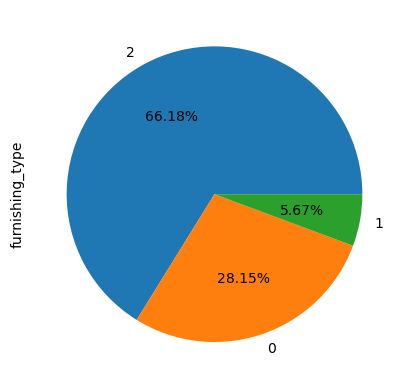

In [281]:
df['furnishing_type'].value_counts().plot(kind='pie', autopct='%0.2f%%')

    => 2 is unfurnished
    => 1 is semi-furnished
    => 0 is unfurnished

### luxury score

In [282]:
df['luxury_score'].isnull().sum()

0

In [283]:
df['luxury_score'].describe()

count    3879.000000
mean       69.424336
std        53.204132
min         0.000000
25%        28.000000
50%        56.000000
75%       108.000000
max       174.000000
Name: luxury_score, dtype: float64

<Axes: xlabel='luxury_score', ylabel='Count'>

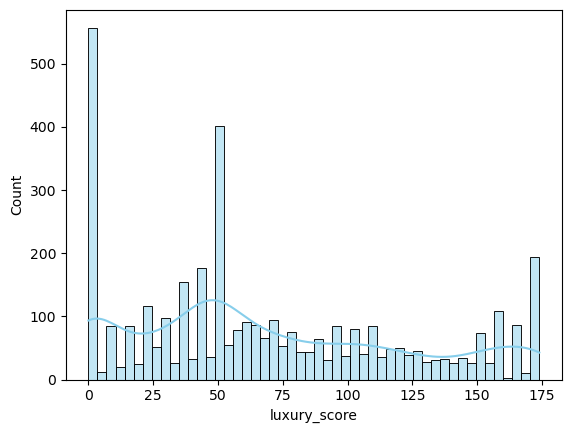

In [284]:
sns.histplot(df['luxury_score'], bins=50, color='skyblue',kde=True)

<Axes: >

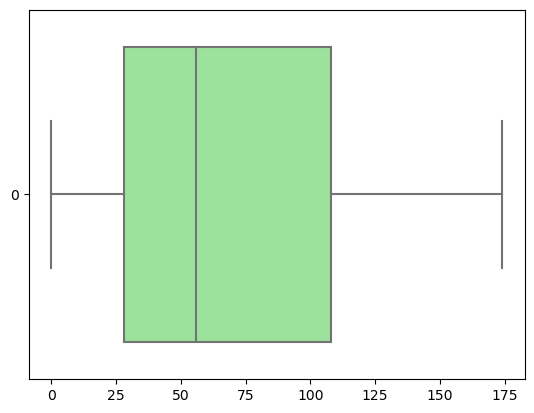

In [285]:
sns.boxplot(df['luxury_score'], color='lightgreen', orient='h')

The luxury score distribution has multiple peeks, suggesting a multi-mode distribution. There's significant number of properties with lower luxury scrores (around 0-50), and other peak is observed around the 110-130 range.

The box plot reveals that the majority of the properties have luxury scores between approximately 30 and 110. The interquantile range (IQR) lies between these values.

### Multivariant Analysis

In [286]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,4.0,West,Relatively New,NaN,NaN,900.0,0,0,0,0,0,2,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,1.0,West,Old Property,NaN,NaN,650.0,0,0,0,0,0,0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,12.0,NA,New Property,NaN,NaN,595.0,0,0,0,0,0,2,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,2.0,NA,Undefined,NaN,NaN,1200.0,0,1,0,0,0,2,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,5.0,NA,Under Construction,1345.0,NaN,NaN,0,1,0,0,0,2,0.0


## property_type vs price

<Axes: xlabel='Property_type', ylabel='price'>

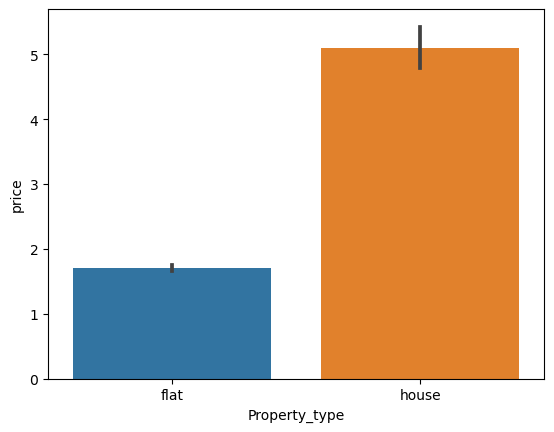

In [287]:
sns.barplot(x=df['Property_type'],y=df['price'])

<Axes: xlabel='Property_type', ylabel='price'>

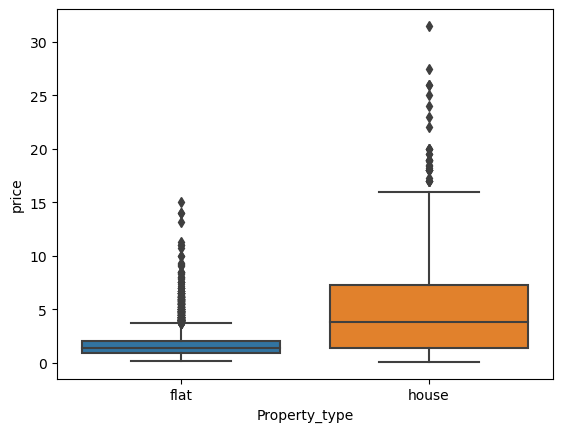

In [288]:
sns.boxplot(x=df['Property_type'], y=df['price'])

### Property_type vs Area

<Axes: xlabel='Property_type', ylabel='area'>

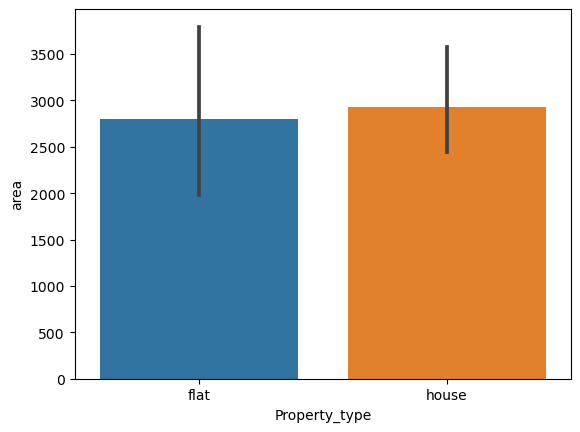

In [289]:
sns.barplot(x=df['Property_type'], y=df['area'])

In [290]:
df['area'].max()

875000.0

In [291]:
# remove crazy outliers

df = df[df['area'] <= 14500.0]

<Axes: xlabel='Property_type', ylabel='area'>

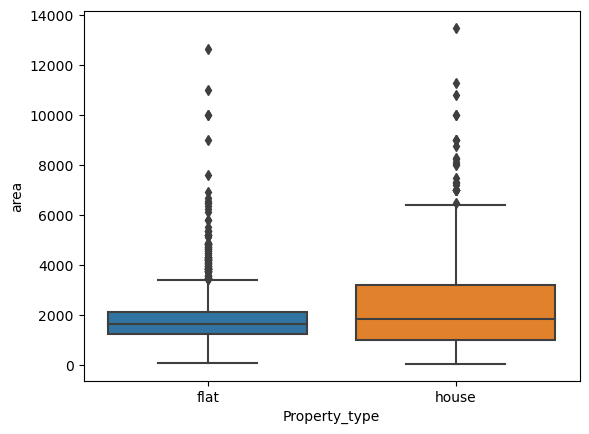

In [292]:
sns.boxplot(x=df['Property_type'], y=df['area'])

### Property_type vs price_persqfeets

<Axes: xlabel='Property_type', ylabel='Price_Per_sqFeets'>

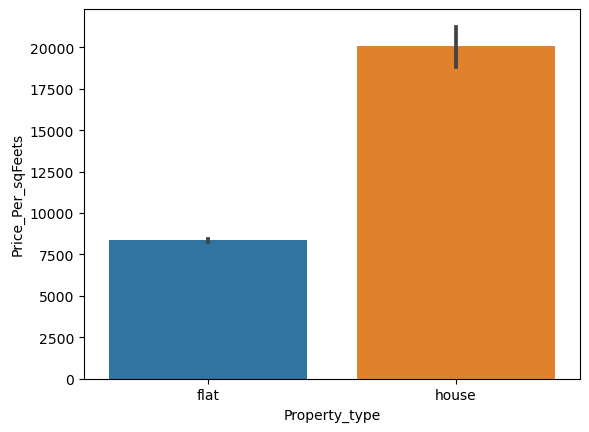

In [293]:
sns.barplot(x=df['Property_type'], y=df['Price_Per_sqFeets'], estimator=np.median)

<Axes: xlabel='Property_type', ylabel='Price_Per_sqFeets'>

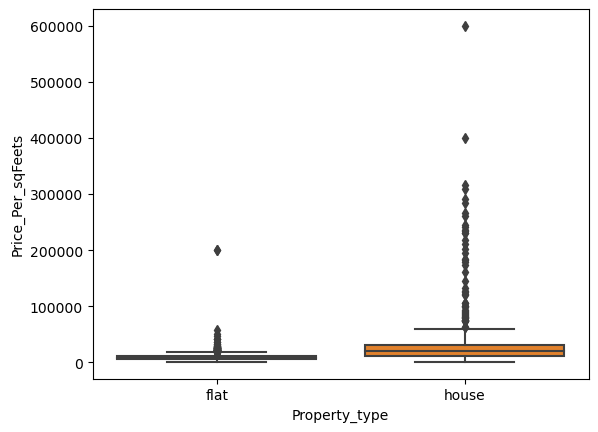

In [294]:
sns.boxplot(x=df['Property_type'], y=df['Price_Per_sqFeets'])

<Axes: xlabel='bedRoom', ylabel='Property_type'>

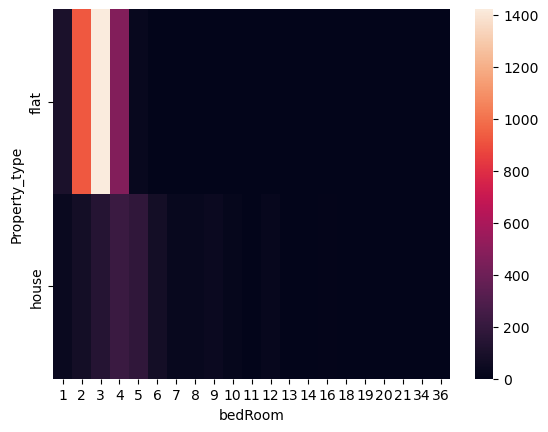

In [295]:
sns.heatmap(pd.crosstab(df['Property_type'],df['bedRoom']))

<Axes: xlabel='Property_type', ylabel='floorNum'>

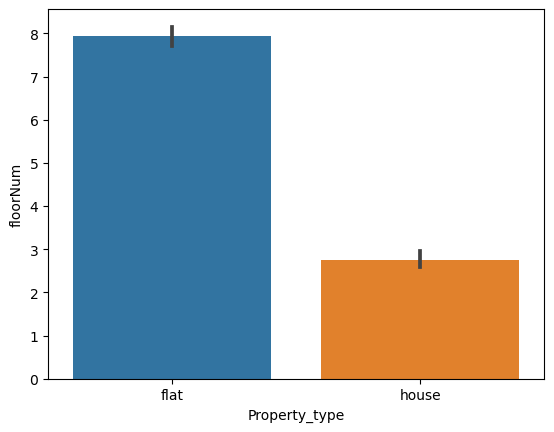

In [296]:
sns.barplot(x=df['Property_type'],y=df['floorNum'])

<Axes: xlabel='Property_type', ylabel='floorNum'>

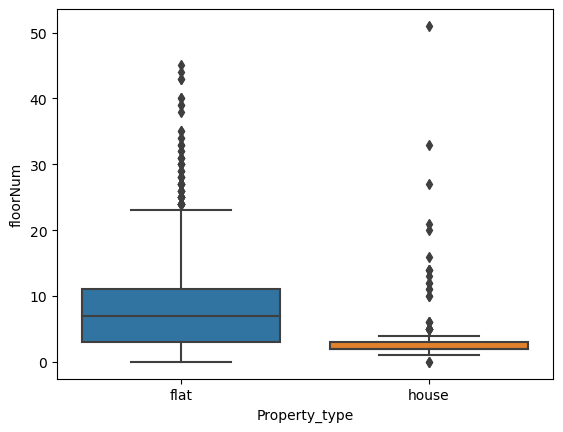

In [297]:
sns.boxplot(x=df['Property_type'],y=df['floorNum'])

In [298]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,4.0,West,Relatively New,NaN,NaN,900.0,0,0,0,0,0,2,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,1.0,West,Old Property,NaN,NaN,650.0,0,0,0,0,0,0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,12.0,NA,New Property,NaN,NaN,595.0,0,0,0,0,0,2,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,2.0,NA,Undefined,NaN,NaN,1200.0,0,1,0,0,0,2,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,5.0,NA,Under Construction,1345.0,NaN,NaN,0,1,0,0,0,2,0.0


<Axes: xlabel='agePossession', ylabel='Property_type'>

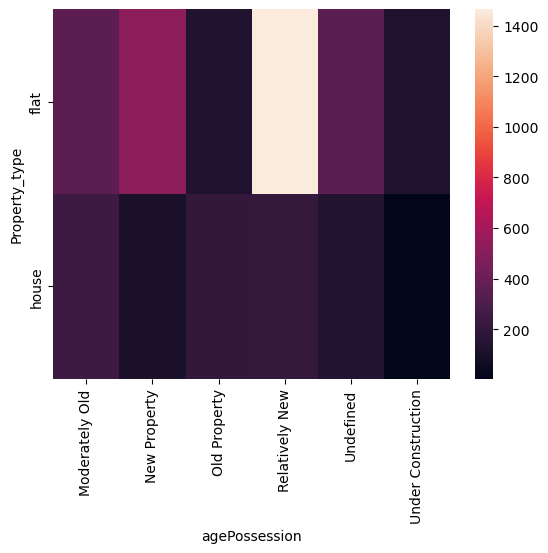

In [299]:
sns.heatmap(pd.crosstab(df['Property_type'], df['agePossession']))

<Axes: xlabel='agePossession', ylabel='Property_type'>

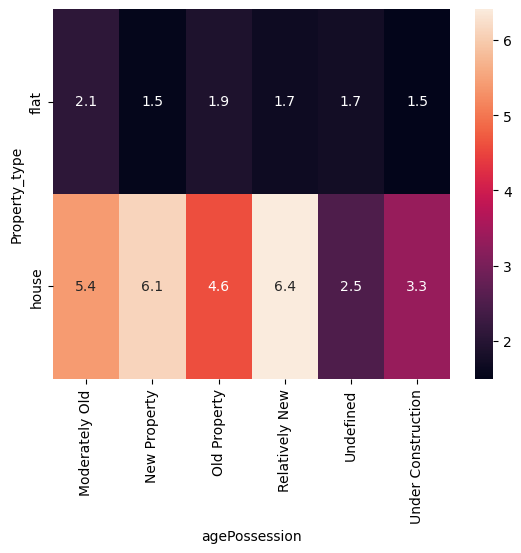

In [300]:
sns.heatmap(pd.pivot_table(df, index='Property_type',columns='agePossession', values='price', aggfunc='mean'), annot=True)

<Axes: xlabel='bedRoom', ylabel='Property_type'>

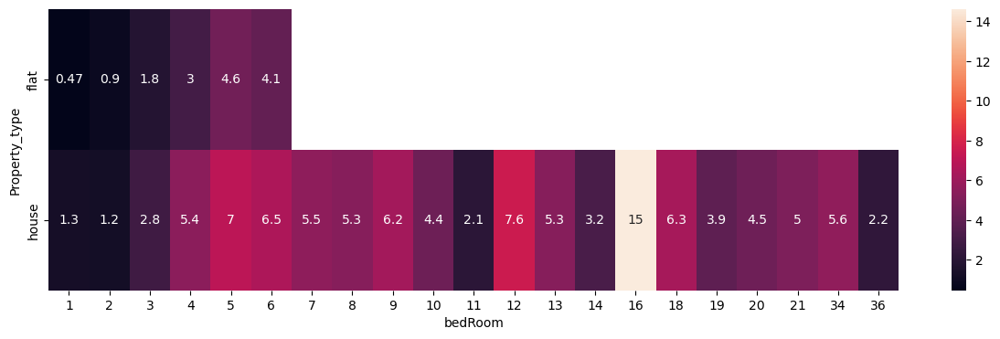

In [301]:
plt.figure(figsize=(15,4))
sns.heatmap(pd.pivot_table(df, index='Property_type', columns='bedRoom', values='price', aggfunc='mean'),annot=True)

<Axes: xlabel='furnishing_type', ylabel='Property_type'>

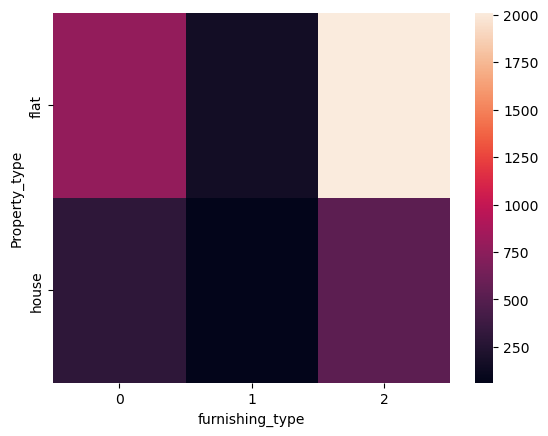

In [302]:
sns.heatmap(pd.crosstab(df['Property_type'], df['furnishing_type']))

<Axes: xlabel='furnishing_type', ylabel='Property_type'>

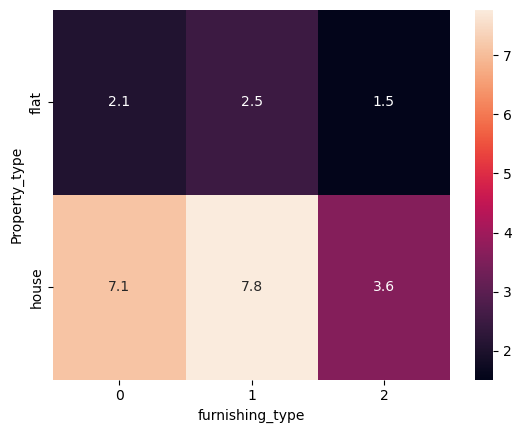

In [303]:
sns.heatmap(pd.pivot_table(df, index='Property_type', columns='furnishing_type', values='price'), annot=True)

<Axes: xlabel='Property_type', ylabel='luxury_score'>

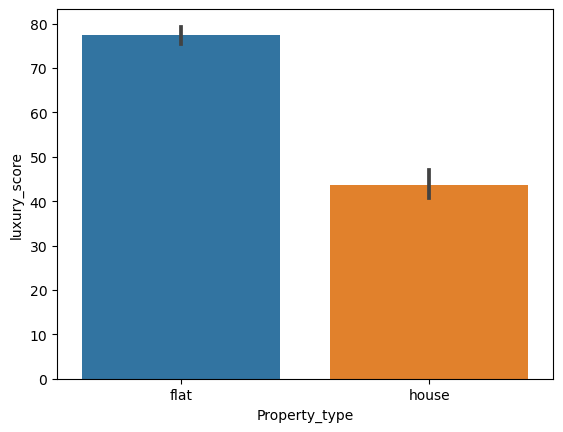

In [304]:
sns.barplot(x=df['Property_type'],y=df['luxury_score'])

<Axes: xlabel='Property_type', ylabel='luxury_score'>

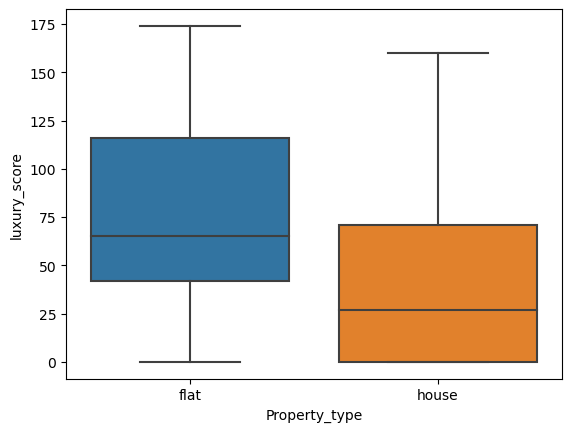

In [305]:
sns.boxplot(x=df['Property_type'], y= df['luxury_score'])

<Axes: xlabel='sector', ylabel='Property_type'>

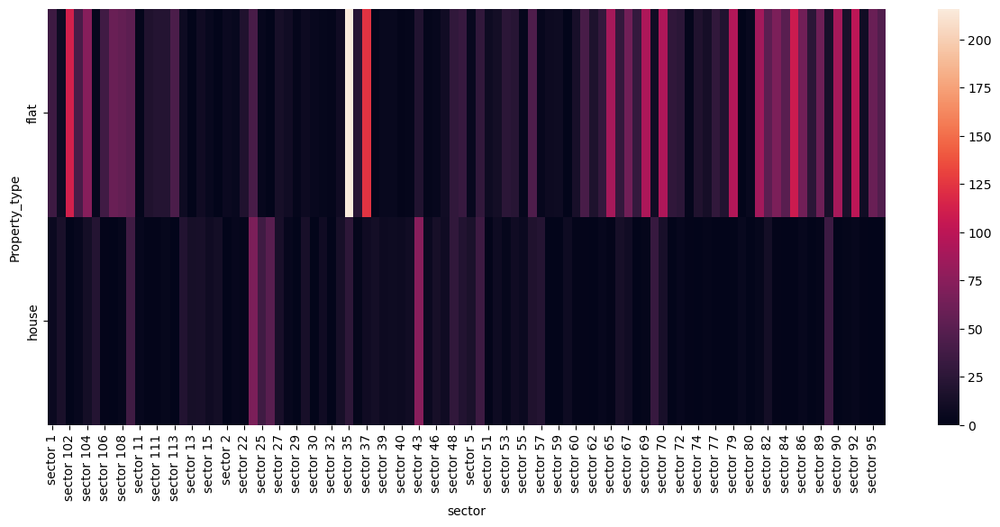

In [306]:
# sector analysis
plt.figure(figsize=(15,6))
sns.heatmap(pd.crosstab(df['Property_type'], df['sector']))

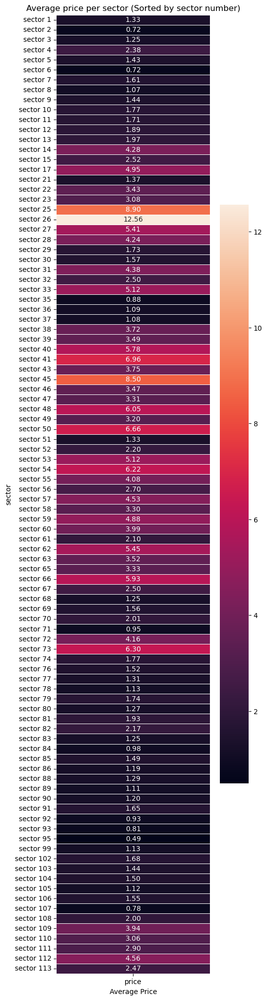

In [307]:
# sector analysis
import re
# Group by 'sector' and calculate the average price
avg_price_per_sector = df.groupby('sector')['price'].mean().reset_index()

# Function to extract sector numbers
def extract_sector_number(sector_name):
    match = re.search(r'\d+', sector_name)
    if match:
        return int(match.group())
    else:
        return float('inf') # Return a Large number for non-numbered sectors
    
avg_price_per_sector['sector_number'] = avg_price_per_sector['sector'].apply(extract_sector_number)

# sort by sector number
avg_price_per_sector_sorted_by_sector = avg_price_per_sector.sort_values(by='sector_number')

# Plote the heat map
plt.figure(figsize=(5,25))
sns.heatmap(avg_price_per_sector_sorted_by_sector.set_index('sector')[['price']],annot=True, fmt='.2f',linewidths=.5)
plt.title('Average price per sector (Sorted by sector number)')
plt.xlabel('Average Price')
plt.ylabel('sector')
plt.show()

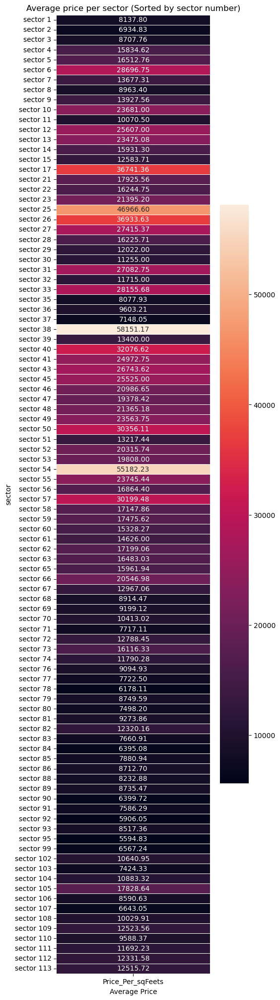

In [308]:
import re
# Group by 'sector' and calculate the average price
avg_price_per_sector = df.groupby('sector')['Price_Per_sqFeets'].mean().reset_index()

# Function to extract sector numbers
def extract_sector_number(sector_name):
    match = re.search(r'\d+', sector_name)
    if match:
        return int(match.group())
    else:
        return float('inf') # Return a Large number for non-numbered sectors
    
avg_price_per_sector['sector_number'] = avg_price_per_sector['sector'].apply(extract_sector_number)

# sort by sector number
avg_price_per_sector_sorted_by_sector = avg_price_per_sector.sort_values(by='sector_number')

# Plote the heat map
plt.figure(figsize=(5,25))
sns.heatmap(avg_price_per_sector_sorted_by_sector.set_index('sector')[['Price_Per_sqFeets']],annot=True, fmt='.2f',linewidths=.5)
plt.title('Average price per sector (Sorted by sector number)')
plt.xlabel('Average Price')
plt.ylabel('sector')
plt.show()

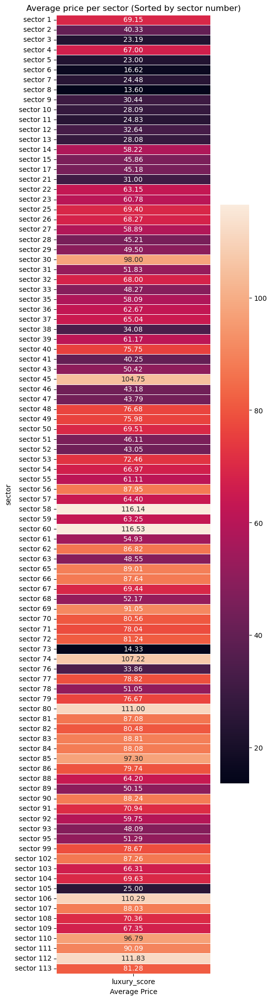

In [309]:
# Group by 'sector' and calculate the average luxury score
avg_price_per_sector = df.groupby('sector')['luxury_score'].mean().reset_index()

# Function to extract sector numbers
def extract_sector_number(sector_name):
    match = re.search(r'\d+', sector_name)
    if match:
        return int(match.group())
    else:
        return float('inf') # Return a Large number for non-numbered sectors
    
avg_price_per_sector['sector_number'] = avg_price_per_sector['sector'].apply(extract_sector_number)

# sort by sector number
avg_price_per_sector_sorted_by_sector = avg_price_per_sector.sort_values(by='sector_number')

# Plote the heat map
plt.figure(figsize=(5,25))
sns.heatmap(avg_price_per_sector_sorted_by_sector.set_index('sector')[['luxury_score']],annot=True, fmt='.2f',linewidths=.5)
plt.title('Average price per sector (Sorted by sector number)')
plt.xlabel('Average Price')
plt.ylabel('sector')
plt.show()

### Price

<Axes: xlabel='area', ylabel='price'>

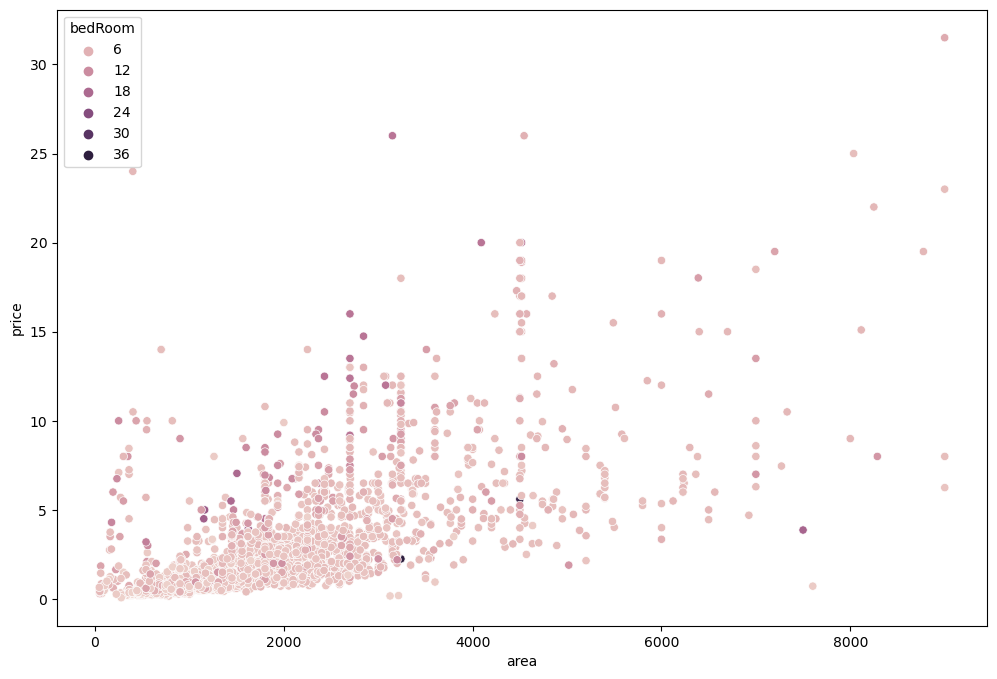

In [310]:
plt.figure(figsize=(12,8))
sns.scatterplot(x=df[df['area']<10000]['area'],y=df['price'],hue=df['bedRoom'])

### Outliers Treated

In [311]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2,2,1,4.0,West,Relatively New,NaN,NaN,900.0,0,0,0,0,0,2,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2,2,1,1.0,West,Old Property,NaN,NaN,650.0,0,0,0,0,0,0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2,2,3,12.0,NA,New Property,NaN,NaN,595.0,0,0,0,0,0,2,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2,2,2,2.0,NA,Undefined,NaN,NaN,1200.0,0,1,0,0,0,2,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2,2,3,5.0,NA,Under Construction,1345.0,NaN,NaN,0,1,0,0,0,2,0.0


In [312]:
df.shape

(3839, 23)

In [313]:
df.columns

Index(['Property_type', 'society', 'sector', 'price', 'Price_Per_sqFeets',
       'area', 'areaWithType', 'bedRoom', 'bathroom', 'balcony', 'floorNum',
       'facing', 'agePossession', 'super_built_up_area', 'built_up_area',
       'carpet_area', 'servant room', 'study room', 'others', 'pooja room',
       'store room', 'furnishing_type', 'luxury_score'],
      dtype='object')

<Axes: xlabel='price', ylabel='Density'>

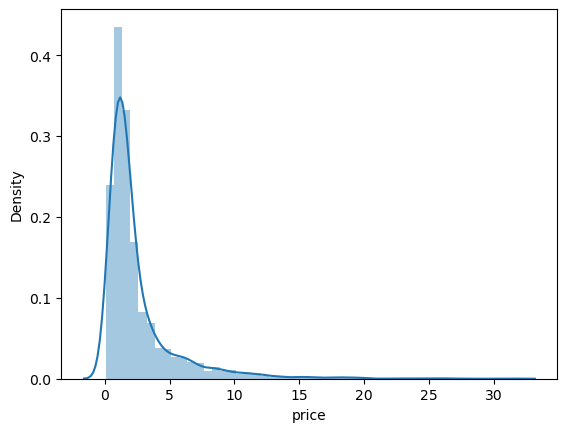

In [314]:
sns.distplot(df['price'])

<Axes: xlabel='price'>

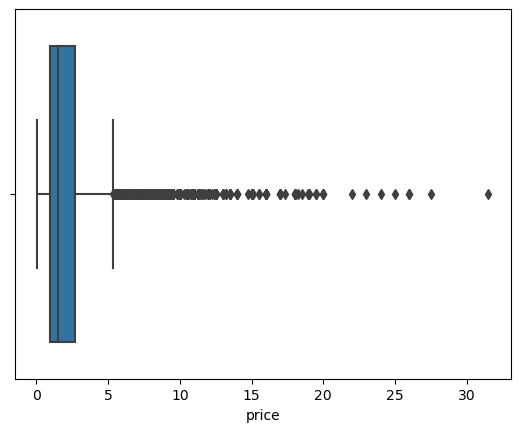

In [315]:
sns.boxplot(x=df['price'])

In [316]:
# Calculate the IQR for the 'price' column

Q1 = df['price'].quantile(0.25)
Q3 = df['price'].quantile(0.75)
IQR = Q3-Q1

# defind boundries
lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR

# Identify Outliers
outliers = df[(df['price'] < lower_bound) |(df['price'] > upper_bound)]

# Display the number of outliers and some statistics
num_outliers = outliers.shape[0]
outliers_price_stats =outliers['price'].describe()

num_outliers, outliers_price_stats

(435,
 count    435.000000
 mean       9.161241
 std        4.041472
 min        5.350000
 25%        6.350000
 50%        8.000000
 75%       10.550000
 max       31.500000
 Name: price, dtype: float64)

In [317]:
outliers.sort_values('price',ascending=False).head(20)

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
3869,house,arjun marg/ sector- 26 phase- 1/ golf course road,sector 26,31.50,35000.0,9000.0,Plot area 1000(836.13 sq.m.),7,9,3+,3.0,North-East,Moderately Old,NaN,9000.0,NaN,0,0,0,0,0,1,43.0
3630,house,independent,sector 43,27.50,24366.0,11286.0,Plot area 1254(1048.5 sq.m.),6,7,3+,3.0,North-East,Relatively New,NaN,11286.0,NaN,0,0,0,0,0,0,0.0
3663,house,dlf city plots,sector 26,26.00,57206.0,4545.0,Plot area 505(422.24 sq.m.),6,7,3+,2.0,North-East,New Property,NaN,4545.0,NaN,0,0,0,0,0,0,45.0
3621,house,independent,sector 26,26.00,82540.0,3150.0,Plot area 402(336.12 sq.m.)Built Up area: 400 ...,16,16,3+,4.0,North-West,New Property,NaN,400.0,350.0,0,0,0,0,0,1,160.0
3808,house,suncity township,sector 54,25.00,31111.0,8036.0,Plot area 1000(836.13 sq.m.),4,4,3+,2.0,North,Moderately Old,NaN,1000.0,NaN,0,0,0,0,0,2,160.0
3586,house,emaar the palm springs,sector 54,24.00,600000.0,400.0,Plot area 400(37.16 sq.m.),5,5,2,1.0,North-East,Old Property,NaN,400.0,NaN,0,0,0,0,0,0,38.0
3794,house,independent,sector 26,23.00,25556.0,9000.0,Plot area 1000(836.13 sq.m.),4,4,3+,2.0,South-West,Relatively New,NaN,9000.0,NaN,0,0,0,0,0,0,103.0
3604,house,vipul tatvam villa,sector 48,22.00,26667.0,8250.0,Plot area 1000(836.13 sq.m.),5,6,3,3.0,NA,Moderately Old,NaN,1000.0,NaN,0,0,0,0,0,2,160.0
3579,house,dlf city plots,sector 26,20.00,44265.0,4518.0,Plot area 502(419.74 sq.m.),16,20,3+,4.0,North-East,New Property,NaN,4518.0,NaN,0,0,0,0,0,0,160.0
3004,house,luxury dlf city floors,sector 26,20.00,48889.0,4091.0,Plot area 500(418.06 sq.m.),16,16,3+,4.0,NA,New Property,NaN,500.0,NaN,0,0,0,0,0,0,103.0


In [318]:
# on the basis of price column is a genuanin data point

### Price_per_sqFeets

<Axes: xlabel='Price_Per_sqFeets', ylabel='Density'>

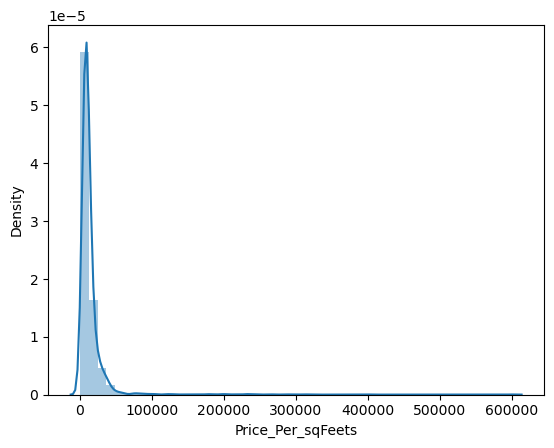

In [319]:
sns.distplot(df['Price_Per_sqFeets'])

<Axes: xlabel='Price_Per_sqFeets'>

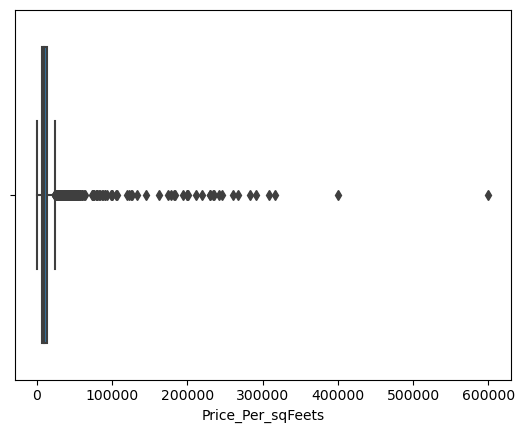

In [320]:
sns.boxplot(x=df['Price_Per_sqFeets'])

In [321]:
# find Outliers using IQR method
Q1 = df['Price_Per_sqFeets'].quantile(0.25)
Q3 = df['Price_Per_sqFeets'].quantile(0.75)
IQR = Q3 - Q1

# Find boudries
lower_bound_pf = Q1 - 1.5*IQR
upper_bound_pf = Q3 + 1.5*IQR

outliers_price_sqfeets = df[(df['Price_Per_sqFeets'] < lower_bound_pf) | (df['Price_Per_sqFeets'] > upper_bound_pf)]

# Display the outliers and some statistics and description
num_outliers_pf = outliers_price_sqfeets.shape[0]
outliers_price_stats_pf = outliers_price_sqfeets['Price_Per_sqFeets'].describe()

num_outliers_pf, outliers_price_stats_pf

(368,
 count       368.000000
 mean      53411.486413
 std       60926.048536
 min       24455.000000
 25%       28224.750000
 50%       33808.000000
 75%       42433.000000
 max      600000.000000
 Name: Price_Per_sqFeets, dtype: float64)

In [322]:
outliers_price_sqfeets['area'] = outliers_price_sqfeets['area'].apply(lambda x:x*9 if x<1000 else x)

In [323]:
outliers_price_sqfeets['Price_Per_sqFeets'] = round((outliers_price_sqfeets['price']*10000000)/outliers_price_sqfeets['area'])

In [324]:
outliers_price_sqfeets.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
30,flat,ompee k s residency,sector 23,1.60,2993.0,5346.0,Carpet area: 66 (55.18 sq.m.),2,2,2,1.0,NA,Relatively New,NaN,NaN,66.00000,0,0,0,0,0,2,0.0
249,flat,tulip monsella,sector 53,8.25,28004.0,2946.0,Super Built up area 2940(273.13 sq.m.),3,4,3,8.0,NA,Undefined,2940.0,NaN,NaN,1,0,0,0,0,1,38.0
254,flat,emaar digihomes,sector 62,4.25,26562.0,1600.0,Carpet area: 1600 (148.64 sq.m.),3,3,3,8.0,NA,Under Construction,NaN,NaN,1600.00000,0,1,0,0,0,2,0.0
281,flat,dlf the grove,sector 54,5.70,41245.0,1382.0,Built Up area: 1382 (128.39 sq.m.),3,3,3,1.0,East,Undefined,NaN,1382.0,NaN,0,0,0,0,0,2,59.0
306,flat,puri the aravallis,sector 61,3.90,33220.0,1174.0,Carpet area: 1249.65 (116.1 sq.m.),3,4,3+,33.0,South,Undefined,NaN,NaN,1249.68879,1,0,0,0,0,2,119.0


In [325]:
outliers_price_sqfeets['Price_Per_sqFeets'].describe()

count      368.000000
mean     28934.383152
std      12549.952560
min       2723.000000
25%      25259.500000
50%      29636.000000
75%      35503.000000
max      82540.000000
Name: Price_Per_sqFeets, dtype: float64

In [326]:
df.update(outliers_price_sqfeets)

<Axes: xlabel='Price_Per_sqFeets', ylabel='Density'>

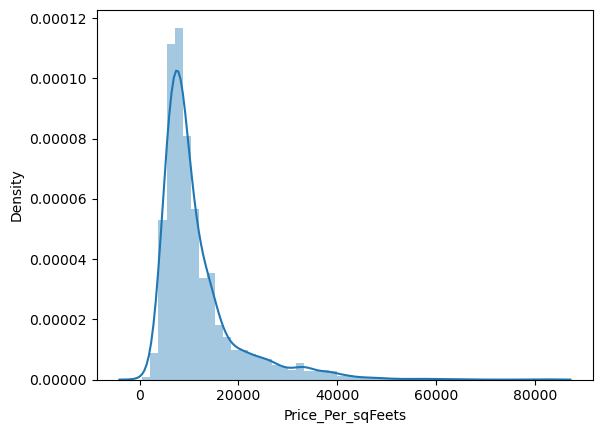

In [327]:
sns.distplot(df['Price_Per_sqFeets'])

<Axes: xlabel='Price_Per_sqFeets'>

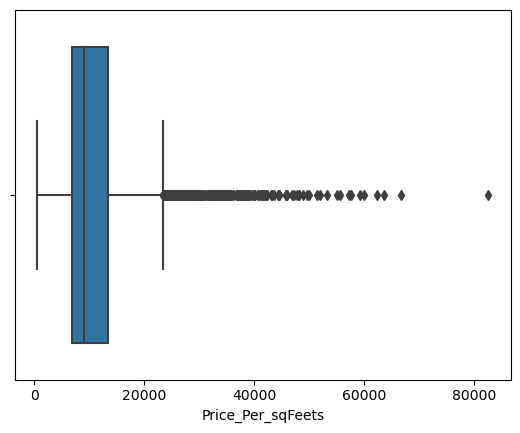

In [328]:
sns.boxplot(x=df['Price_Per_sqFeets'])

In [329]:
df = df[df['Price_Per_sqFeets'] < 50000]

<Axes: xlabel='Price_Per_sqFeets'>

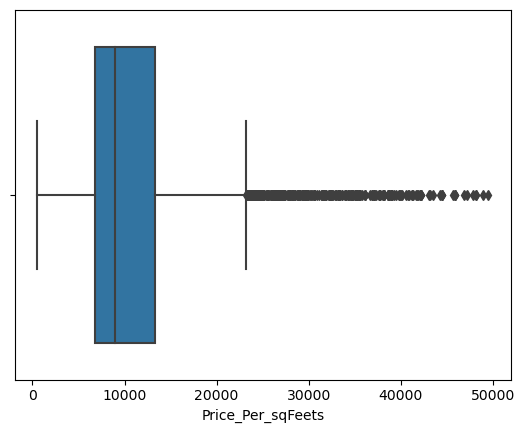

In [330]:
sns.boxplot(x=df['Price_Per_sqFeets'])

### Area

<Axes: xlabel='area', ylabel='Density'>

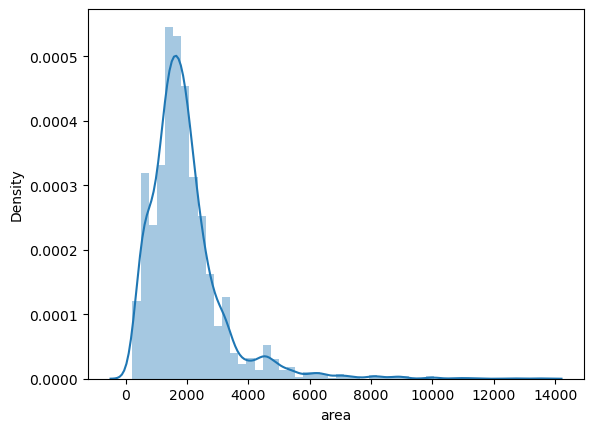

In [331]:
sns.distplot(df['area'])

<Axes: xlabel='area'>

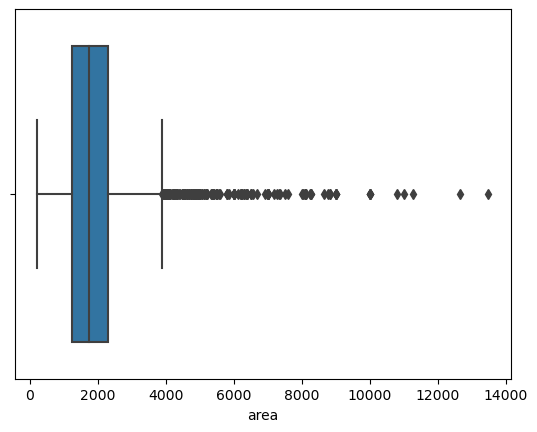

In [332]:
sns.boxplot(x=df['area'])

In [333]:
df['area'].describe()

count     3825.000000
mean      1939.956078
std       1234.701299
min        225.000000
25%       1245.000000
50%       1736.000000
75%       2302.000000
max      13492.000000
Name: area, dtype: float64

In [334]:
df[df['area'] > 100000].shape

(0, 23)

In [335]:
df = df[df['area']<100000]

<Axes: xlabel='area', ylabel='Density'>

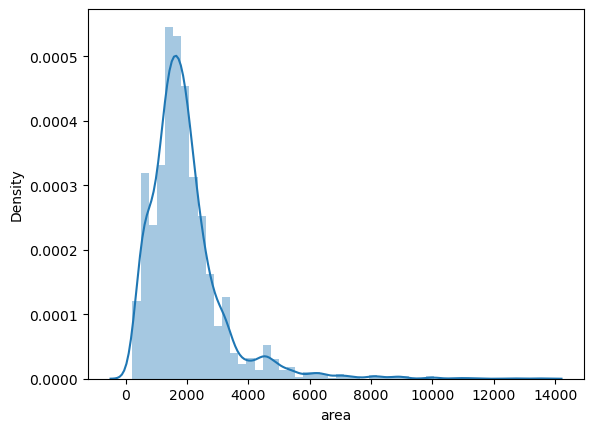

In [336]:
sns.distplot(df['area'])

<Axes: xlabel='area'>

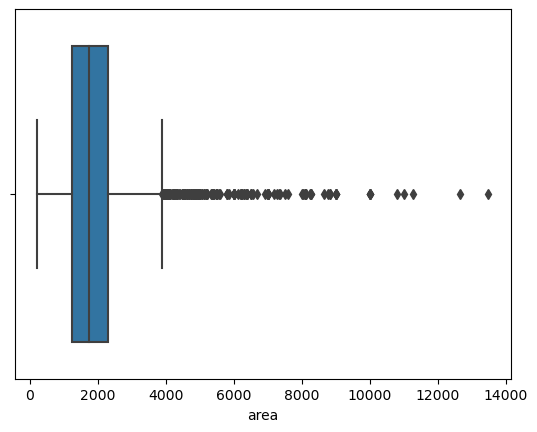

In [337]:
sns.boxplot(x=df['area'])

In [338]:
df[df['area'] > 10000].sort_values('area', ascending=False)

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
3102,house,independent,sector 43,0.85,630.0,13492.0,Plot area 1500(1254.19 sq.m.),3.0,3.0,1,1.0,North,Relatively New,NaN,13500.0,NaN,0.0,0.0,0.0,0.0,0.0,2.0,8.0
2852,flat,godrej icon,sector 88,1.75,1384.0,12645.0,Carpet area: 1175.11,3.0,3.0,3+,6.0,NA,New Property,NaN,NaN,1175.11,0.0,0.0,0.0,0.0,0.0,2.0,115.0
3630,house,independent,sector 43,27.50,24366.0,11286.0,Plot area 1254(1048.5 sq.m.),6.0,7.0,3+,3.0,North-East,Relatively New,NaN,11286.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1639,flat,m3m golfestate,sector 65,13.20,12000.0,11000.0,Carpet area: 11000 (1021.93 sq.m.),4.0,4.0,3,13.0,North,Moderately Old,NaN,NaN,11000.00,1.0,0.0,0.0,0.0,0.0,2.0,174.0
3564,house,independent,sector 35,5.50,5093.0,10799.0,Plot area 1200(1003.35 sq.m.)Built Up area: 35...,3.0,3.0,3+,2.0,West,Moderately Old,NaN,3500.0,NaN,0.0,0.0,0.0,0.0,0.0,2.0,56.0


In [339]:
df.drop(index=[3102, 2852, 1639, 3564, 3630], inplace=True)

In [340]:
df.drop(index=[3641], inplace=True)

In [341]:
df[df['area'] > 10000].sort_values('area',ascending=False)

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score


In [342]:
df.loc[3283, 'area'] = 115*9
df.loc[3359, 'area'] = 7250
df.loc[3552, 'area'] = 5800
df.loc[3085, 'area'] = 2660
df.loc[3092, 'area'] = 2160
df.loc[2832, 'area'] = 1175
df.loc[3500, 'area'] = 3500

In [343]:
df.loc[3614, 'area'] = 2850

<Axes: xlabel='area', ylabel='Density'>

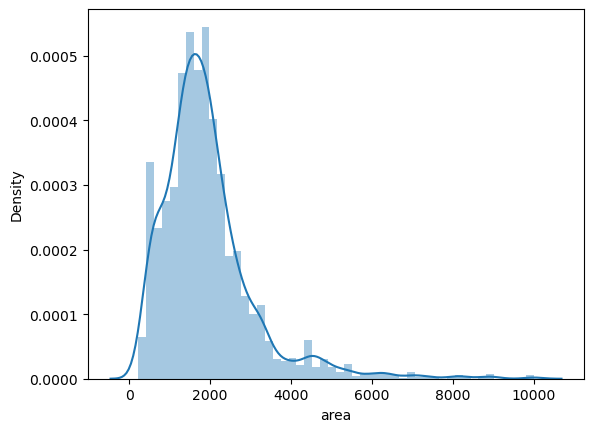

In [344]:
sns.distplot(df['area'])

<Axes: xlabel='area'>

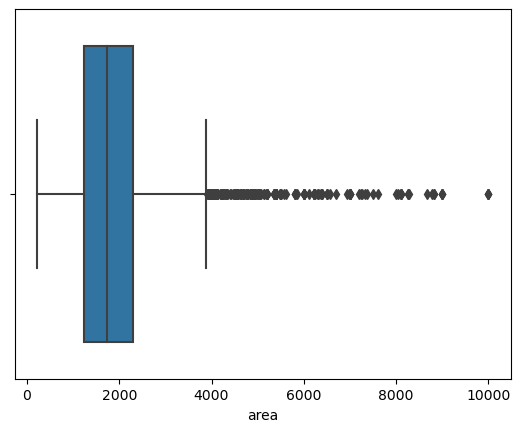

In [345]:
sns.boxplot(x=df['area'])

In [346]:
df['area'].describe()

count     3819.000000
mean      1931.154753
std       1186.493264
min        225.000000
25%       1245.000000
50%       1738.000000
75%       2303.500000
max      10000.000000
Name: area, dtype: float64

### BedRoom

<Axes: xlabel='bedRoom', ylabel='Density'>

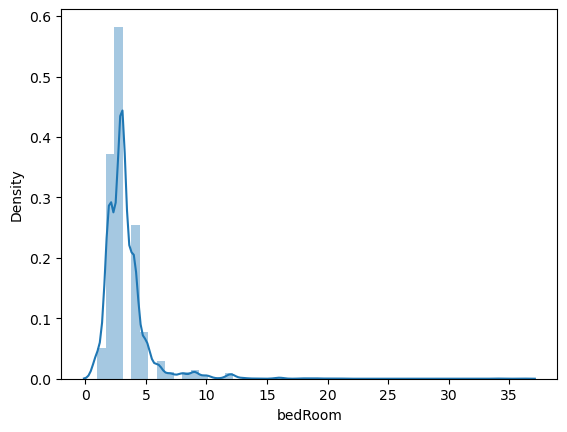

In [347]:
sns.distplot(df['bedRoom'])

<Axes: xlabel='bedRoom'>

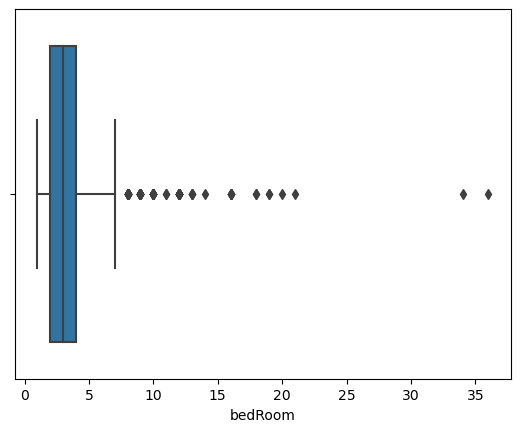

In [348]:
sns.boxplot(x=df['bedRoom'])

In [349]:
df['bedRoom'].describe()

count    3819.000000
mean        3.322598
std         1.931824
min         1.000000
25%         2.000000
50%         3.000000
75%         4.000000
max        36.000000
Name: bedRoom, dtype: float64

In [350]:
df[df['bedRoom'] > 10].shape

(47, 23)

In [351]:
df = df[df['bedRoom'] <= 10]

In [352]:
df.shape

(3772, 23)

In [353]:
df['bedRoom'].describe()

count    3772.000000
mean        3.183457
std         1.374566
min         1.000000
25%         2.000000
50%         3.000000
75%         4.000000
max        10.000000
Name: bedRoom, dtype: float64

<Axes: xlabel='bedRoom', ylabel='Density'>

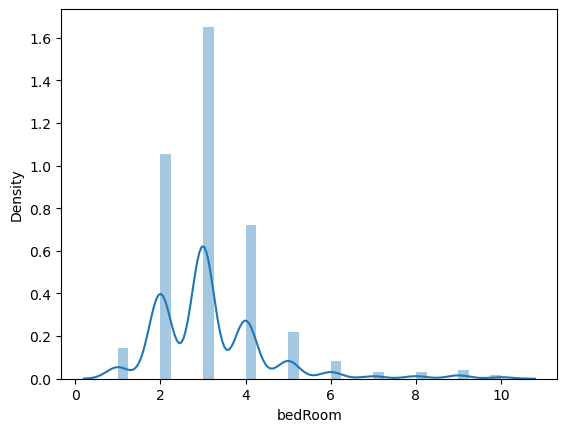

In [354]:
sns.distplot(df['bedRoom'])

<Axes: xlabel='bedRoom'>

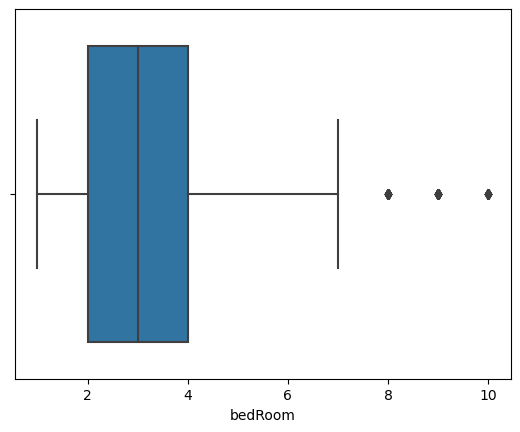

In [355]:
sns.boxplot(x=df['bedRoom'])

<Axes: xlabel='bathroom', ylabel='Density'>

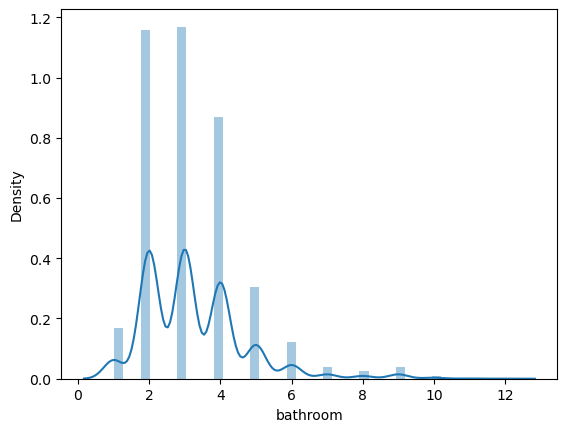

In [356]:
sns.distplot(df['bathroom'])

<Axes: xlabel='bathroom'>

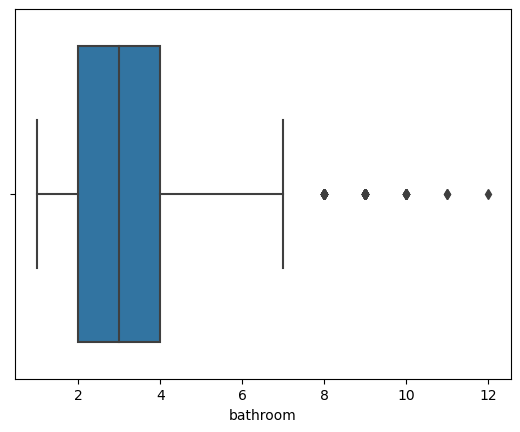

In [357]:
sns.boxplot(x=df['bathroom'])

In [358]:
df[df['bathroom'] > 10].sort_values('bathroom', ascending=False)

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
3513,house,adani brahma samsara,sector 60,18.02,28200.0,6390.0,Built Up area: 6390 (593.65 sq.m.),9.0,12.0,3+,3.0,North-East,Relatively New,NaN,6390.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,144.0
3446,house,independent,sector 39,7.00,10000.0,7000.0,Plot area 350(32.52 sq.m.)Built Up area: 7000 ...,10.0,11.0,3+,4.0,South-East,Relatively New,NaN,7000.0,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3512,house,independent,sector 23,11.00,28902.0,3806.0,Plot area 3806.45(353.63 sq.m.)Built Up area: ...,8.0,11.0,3+,3.0,East,Old Property,NaN,5000.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [359]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2.0,2.0,1,4.0,West,Relatively New,NaN,NaN,900.0,0.0,0.0,0.0,0.0,0.0,2.0,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2.0,2.0,1,1.0,West,Old Property,NaN,NaN,650.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2.0,2.0,3,12.0,NA,New Property,NaN,NaN,595.0,0.0,0.0,0.0,0.0,0.0,2.0,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2.0,2.0,2,2.0,NA,Undefined,NaN,NaN,1200.0,0.0,1.0,0.0,0.0,0.0,2.0,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2.0,2.0,3,5.0,NA,Under Construction,1345.0,NaN,NaN,0.0,1.0,0.0,0.0,0.0,2.0,0.0


### Super built up area

<Axes: xlabel='super_built_up_area', ylabel='Density'>

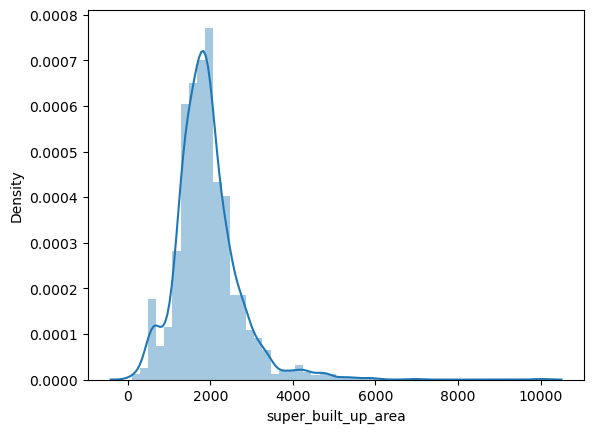

In [360]:
sns.distplot(df['super_built_up_area'])

<Axes: xlabel='super_built_up_area'>

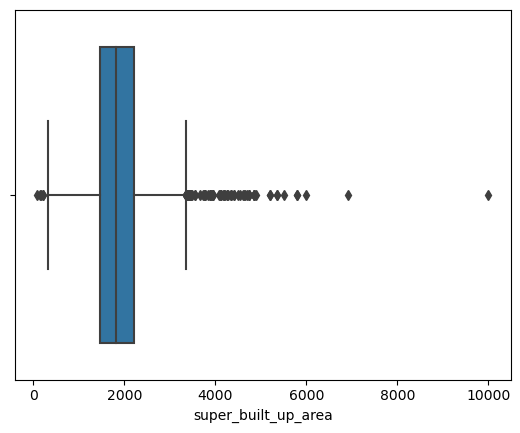

In [361]:
sns.boxplot(x=df['super_built_up_area'])

In [362]:
df['super_built_up_area'].describe()

count     1922.000000
mean      1918.915999
std        768.595547
min         89.000000
25%       1457.000000
50%       1827.250000
75%       2215.000000
max      10000.000000
Name: super_built_up_area, dtype: float64

In [363]:
df[df['super_built_up_area'] > 6000]

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
672,flat,krrish provence estate,sector 79,7.5,7500.0,10000.0,Super Built up area 10000(929.03 sq.m.),5.0,6.0,3+,23.0,North-East,Relatively New,10000.0,NaN,NaN,1.0,0.0,1.0,1.0,0.0,2.0,165.0
1545,flat,bestech park view grand spa,sector 81,4.7,6786.0,6926.0,Super Built up area 6926(643.45 sq.m.),4.0,4.0,3+,19.0,North,Relatively New,6926.0,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,67.0


### built up area

<Axes: xlabel='built_up_area', ylabel='Density'>

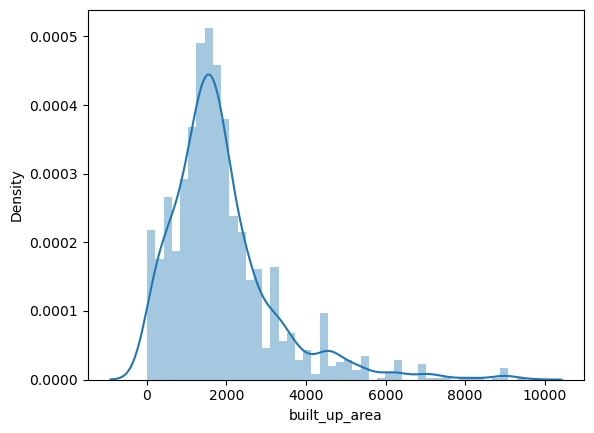

In [364]:
sns.distplot(df['built_up_area'])

<Axes: xlabel='built_up_area'>

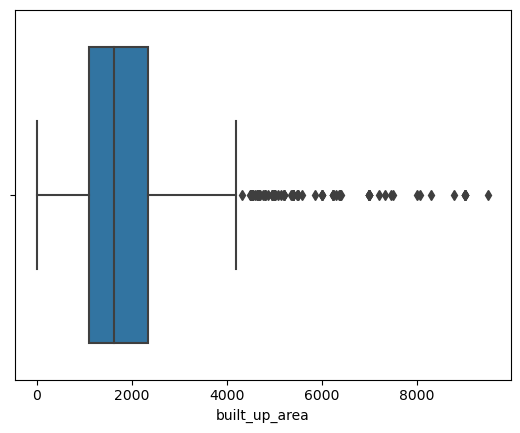

In [365]:
sns.boxplot(x=df['built_up_area'])

In [366]:
df = df[(df['built_up_area'] != 13500) | (df['built_up_area'] != 26000)]

In [367]:
df.shape

(3772, 23)

### carpet area

<Axes: xlabel='carpet_area', ylabel='Density'>

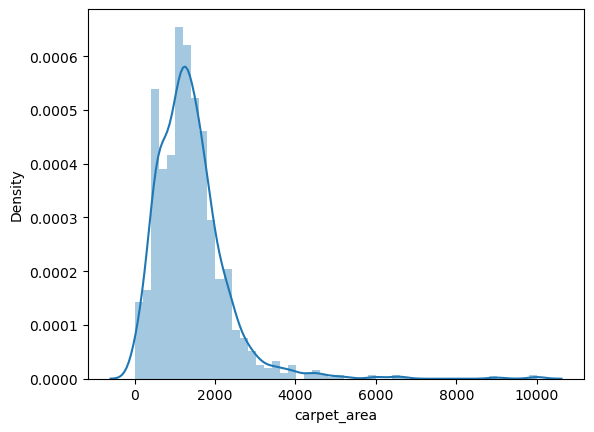

In [368]:
sns.distplot(df['carpet_area'])

<Axes: xlabel='carpet_area'>

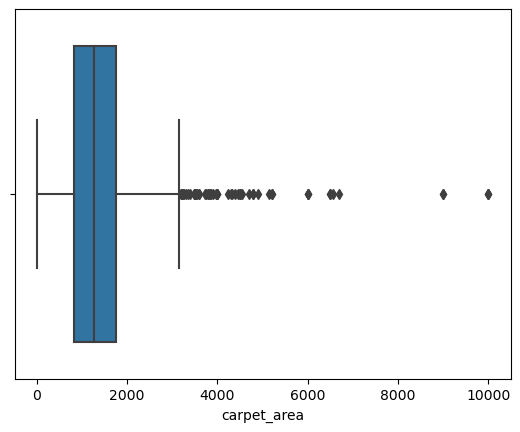

In [369]:
sns.boxplot(x=df['carpet_area'])

In [370]:
df = df[df['carpet_area'] != 18122]

In [371]:
df.shape

(3772, 23)

<Axes: xlabel='carpet_area', ylabel='Density'>

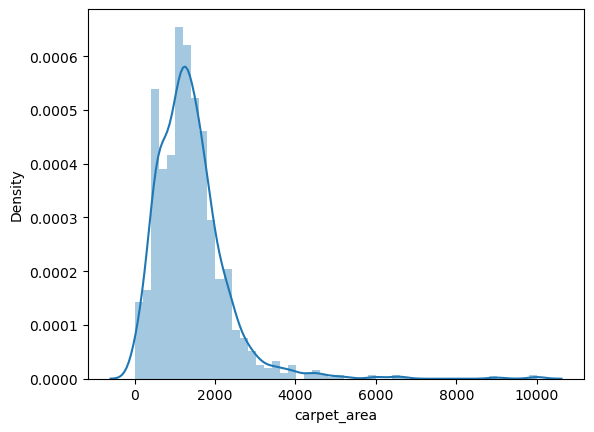

In [372]:
sns.distplot(df['carpet_area'])

<Axes: xlabel='luxury_score', ylabel='Density'>

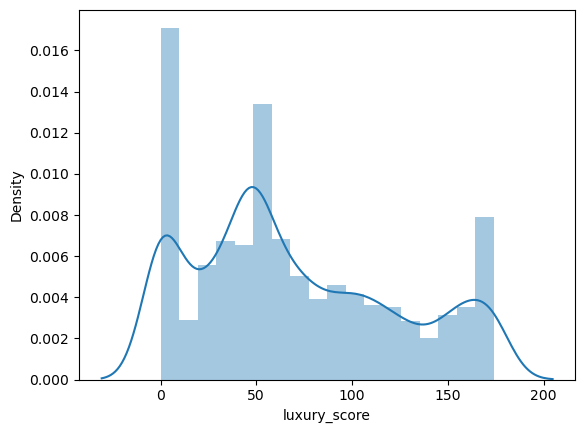

In [373]:
sns.distplot(df['luxury_score'])

<Axes: xlabel='luxury_score'>

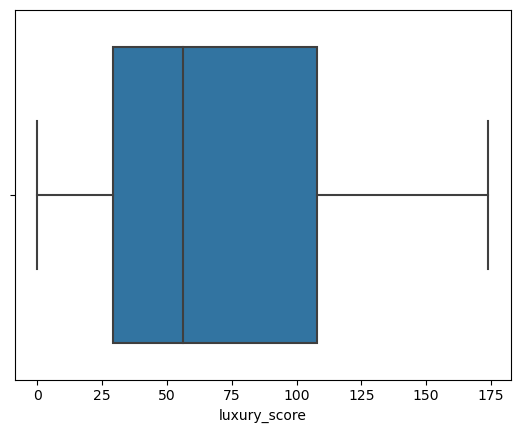

In [374]:
sns.boxplot(x=df['luxury_score'])

In [375]:
df.shape

(3772, 23)

In [376]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2.0,2.0,1,4.0,West,Relatively New,NaN,NaN,900.0,0.0,0.0,0.0,0.0,0.0,2.0,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2.0,2.0,1,1.0,West,Old Property,NaN,NaN,650.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6722.0,595.0,Carpet area: 595 (55.28 sq.m.),2.0,2.0,3,12.0,NA,New Property,NaN,NaN,595.0,0.0,0.0,0.0,0.0,0.0,2.0,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2.0,2.0,2,2.0,NA,Undefined,NaN,NaN,1200.0,0.0,1.0,0.0,0.0,0.0,2.0,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2.0,2.0,3,5.0,NA,Under Construction,1345.0,NaN,NaN,0.0,1.0,0.0,0.0,0.0,2.0,0.0


In [377]:
df['Price_Per_sqFeets']= round((df['price']*10000000)/df['area'])

In [378]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2.0,2.0,1,4.0,West,Relatively New,NaN,NaN,900.0,0.0,0.0,0.0,0.0,0.0,2.0,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2.0,2.0,1,1.0,West,Old Property,NaN,NaN,650.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6723.0,595.0,Carpet area: 595 (55.28 sq.m.),2.0,2.0,3,12.0,NA,New Property,NaN,NaN,595.0,0.0,0.0,0.0,0.0,0.0,2.0,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2.0,2.0,2,2.0,NA,Undefined,NaN,NaN,1200.0,0.0,1.0,0.0,0.0,0.0,2.0,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2.0,2.0,3,5.0,NA,Under Construction,1345.0,NaN,NaN,0.0,1.0,0.0,0.0,0.0,2.0,0.0


<Axes: xlabel='Price_Per_sqFeets', ylabel='Density'>

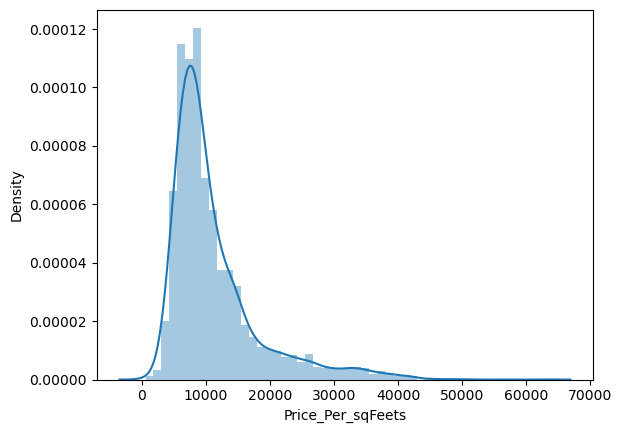

In [379]:
sns.distplot(df['Price_Per_sqFeets'])

<Axes: xlabel='Price_Per_sqFeets'>

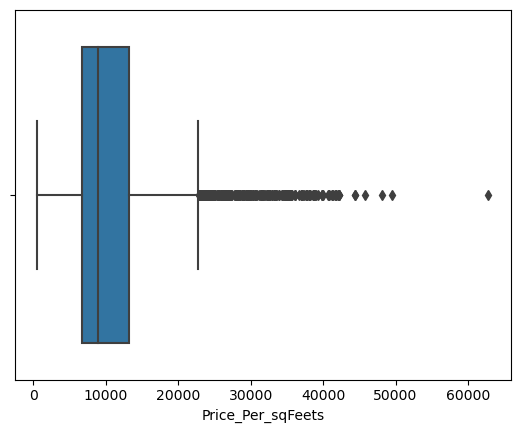

In [380]:
sns.boxplot(x=df['Price_Per_sqFeets'])

In [381]:
x = df[df['Price_Per_sqFeets'] <= 20000]
(x['area']/x['bedRoom']).quantile(0.05)

250.0

In [382]:
df[(df['area']/df['bedRoom']) < 250]

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
119,flat,czar mahira homes 63a,sector 63,0.42,7407.0,567.0,Carpet area: 567 (52.68 sq.m.),3.0,2.0,2,1.0,NA,Undefined,NaN,NaN,567.000000,0.0,0.0,0.0,0.0,0.0,2.0,0.0
132,flat,mvn athens,sector 35,0.26,5394.0,482.0,Carpet area: 481.74 (44.76 sq.m.),2.0,2.0,1,2.0,NA,Relatively New,NaN,NaN,481.792164,0.0,0.0,0.0,0.0,0.0,2.0,37.0
208,flat,supertech basera,sector 79,0.36,7643.0,471.0,Built Up area: 546 (50.73 sq.m.)Carpet area: 4...,2.0,2.0,1,4.0,NA,New Property,NaN,546.00,471.000000,0.0,0.0,0.0,0.0,0.0,2.0,45.0
347,flat,mvn athens,sector 35,0.27,5895.0,458.0,Carpet area: 457.81 (42.53 sq.m.),2.0,2.0,1,4.0,South-East,Relatively New,NaN,NaN,457.788667,0.0,0.0,1.0,0.0,0.0,0.0,68.0
575,flat,signature global solera,sector 107,0.27,5521.0,489.0,Carpet area: 489 (45.43 sq.m.),2.0,2.0,2,0.0,North-East,Relatively New,NaN,NaN,489.000000,0.0,0.0,0.0,0.0,0.0,2.0,68.0
576,flat,signature global solera,sector 107,0.28,5680.0,493.0,Carpet area: 489 (45.43 sq.m.),2.0,2.0,2,6.0,West,Relatively New,NaN,NaN,489.000000,0.0,0.0,0.0,0.0,0.0,2.0,174.0
719,flat,signature global solera,sector 107,0.50,7752.0,645.0,Carpet area: 645 (59.92 sq.m.),3.0,2.0,2,6.0,South-East,Relatively New,NaN,NaN,645.000000,0.0,0.0,1.0,0.0,0.0,2.0,165.0
720,flat,signature global solera,sector 107,0.52,8062.0,645.0,Carpet area: 645 (59.92 sq.m.),3.0,2.0,2,5.0,East,Relatively New,NaN,NaN,645.000000,0.0,0.0,1.0,0.0,0.0,2.0,88.0
721,flat,signature global solera,sector 107,0.28,5726.0,489.0,Carpet area: 489 (45.43 sq.m.),2.0,2.0,2,6.0,West,Relatively New,NaN,NaN,489.000000,0.0,0.0,0.0,0.0,0.0,2.0,90.0
722,flat,signature global solera,sector 107,0.29,5930.0,489.0,Carpet area: 489 (45.43 sq.m.),2.0,2.0,2,3.0,East,Relatively New,NaN,NaN,489.000000,0.0,0.0,0.0,0.0,0.0,2.0,94.0


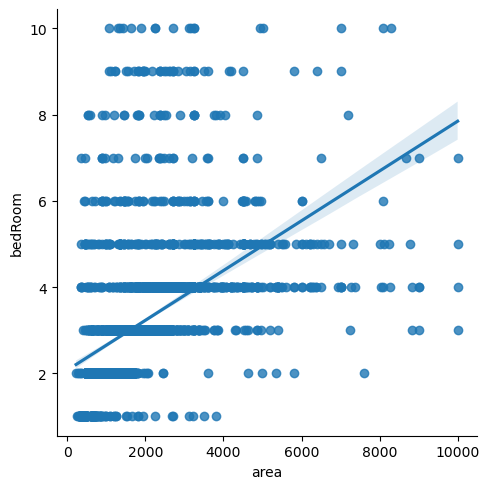

In [383]:
sns.lmplot(data=df, x='area', y='bedRoom')

In [384]:
df['area_room_ratio'] = df['area']/df['bedRoom']

In [385]:
(df[df['area_room_ratio'] < 250])['bedRoom'].value_counts()

2.0     48
3.0     36
5.0     30
6.0     22
4.0     20
9.0     16
8.0     13
7.0      9
10.0     8
Name: bedRoom, dtype: int64

In [386]:
df = df[df['area_room_ratio'] > 100]

In [387]:
outliers_df = df[(df['area_room_ratio'] < 250) & (df['bedRoom'] >3)]

In [388]:
outliers_df['bedRoom'] = round(outliers_df['bedRoom']/outliers_df['floorNum'])

In [389]:
df.update(outliers_df)

In [390]:
df['area_room_ratio'] = df['area']/df['bedRoom']

In [391]:
df[(df['area_room_ratio'] < 250) & (df['bedRoom'] > 4)]

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score,area_room_ratio
3148,house,independent,sector 1,1.10,6173.0,1782.0,Plot area 1782(165.55 sq.m.),8.0,8.0,0,1.0,NA,New Property,NaN,1782.0,NaN,0.0,0.0,0.0,0.0,0.0,2.0,15.0,222.750000
3157,house,independent,sector 1,0.80,6667.0,1200.0,Plot area 1200(111.48 sq.m.),8.0,8.0,2,1.0,NA,Relatively New,NaN,1200.0,NaN,0.0,0.0,0.0,0.0,0.0,2.0,0.0,150.000000
3161,house,shivpuri,sector 9,2.80,12444.0,2250.0,Plot area 2250(209.03 sq.m.),10.0,7.0,3,1.0,NA,Old Property,NaN,2250.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,225.000000
3165,house,independent,sector 7,1.16,11717.0,990.0,Carpet area: 110 (91.97 sq.m.),5.0,4.0,2,1.0,North-East,Undefined,NaN,NaN,110.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,198.000000
3212,house,independent,sector 5,1.65,8333.0,1980.0,Built Up area: 220 (20.44 sq.m.),9.0,9.0,0,1.0,NA,New Property,NaN,220.0,NaN,0.0,0.0,0.0,0.0,0.0,2.0,0.0,220.000000
3228,house,independent,sector 10,2.50,13889.0,1800.0,Plot area 1800(167.23 sq.m.),9.0,5.0,2,1.0,South-East,Old Property,NaN,1800.0,NaN,0.0,0.0,0.0,0.0,0.0,2.0,53.0,200.000000
3237,house,"bhim nagar, sector 6",sector 6,0.85,14096.0,603.0,Plot area 67(6.22 sq.m.),5.0,2.0,2,1.0,NA,Old Property,NaN,67.0,NaN,0.0,0.0,0.0,0.0,0.0,2.0,21.0,120.600000
3301,house,independent,sector 37,1.10,10000.0,1100.0,Built Up area: 1100 (102.19 sq.m.)Carpet area:...,5.0,4.0,2,1.0,East,Undefined,NaN,1100.0,900.0,0.0,0.0,0.0,0.0,0.0,2.0,14.0,220.000000
3335,house,independent,sector 67,0.65,6500.0,1000.0,Carpet area: 1000 (92.9 sq.m.),6.0,2.0,3,1.0,NA,Undefined,NaN,NaN,1000.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,166.666667
3351,house,independent,sector 105,1.10,12222.0,900.0,Carpet area: 900 (83.61 sq.m.),6.0,4.0,1,1.0,South-West,Undefined,NaN,NaN,900.0,0.0,0.0,0.0,0.0,0.0,2.0,22.0,150.000000


In [392]:
df[(df['area_room_ratio'] < 250) & (df['bedRoom'] > 4)].shape

(13, 24)

In [393]:
df = df[~((df['area_room_ratio'] < 250) & (df['bedRoom'] > 4))]

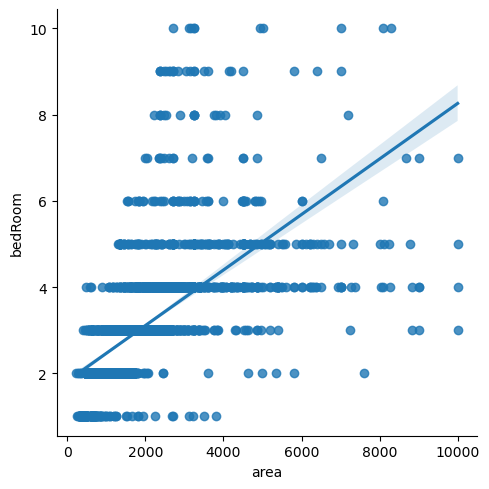

In [394]:
sns.lmplot(data=df, x='area', y='bedRoom')

In [395]:
df.shape

(3739, 24)

### Missing Values Handle

In [396]:
df.shape

(3739, 24)

In [397]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score,area_room_ratio
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2.0,2.0,1,4.0,West,Relatively New,NaN,NaN,900.0,0.0,0.0,0.0,0.0,0.0,2.0,28.0,450.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2.0,2.0,1,1.0,West,Old Property,NaN,NaN,650.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0,325.0
2,flat,tulsiani easy in homes,sector 35,0.40,6723.0,595.0,Carpet area: 595 (55.28 sq.m.),2.0,2.0,3,12.0,NA,New Property,NaN,NaN,595.0,0.0,0.0,0.0,0.0,0.0,2.0,36.0,297.5
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2.0,2.0,2,2.0,NA,Undefined,NaN,NaN,1200.0,0.0,1.0,0.0,0.0,0.0,2.0,76.0,600.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2.0,2.0,3,5.0,NA,Under Construction,1345.0,NaN,NaN,0.0,1.0,0.0,0.0,0.0,2.0,0.0,672.5


In [398]:
df.isnull().sum()

Property_type             0
society                   0
sector                    0
price                     0
Price_Per_sqFeets         0
area                      0
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
floorNum                 19
facing                    0
agePossession             0
super_built_up_area    1817
built_up_area          2054
carpet_area            1814
servant room              0
study room                0
others                    0
pooja room                0
store room                0
furnishing_type           0
luxury_score              0
area_room_ratio           0
dtype: int64

### Built up area

<Axes: xlabel='built_up_area', ylabel='super_built_up_area'>

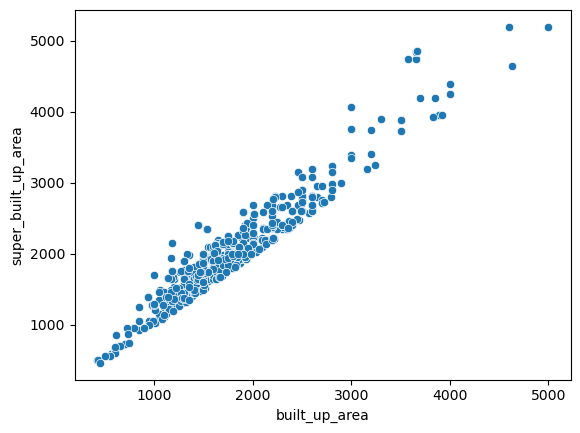

In [399]:
sns.scatterplot(x=df['built_up_area'],y=df['super_built_up_area'])

<Axes: xlabel='built_up_area', ylabel='carpet_area'>

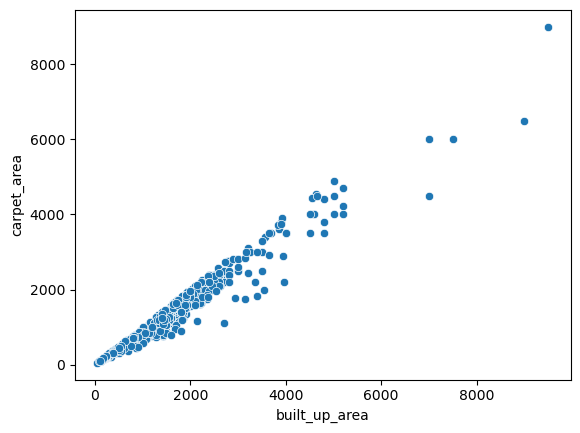

In [400]:
sns.scatterplot(x=df['built_up_area'],y=df['carpet_area'])

In [401]:
all_present_df = df[~((df['super_built_up_area'].isnull()) | (df['built_up_area'].isnull()) | (df['carpet_area'].isnull()))]

In [402]:
all_present_df.shape

(537, 24)

In [403]:
super_to_built_up_ratio = (all_present_df['super_built_up_area']/all_present_df['built_up_area']).median()

In [404]:
carpet_to_built_up_ratio = (all_present_df['carpet_area']/all_present_df['built_up_area']).median()

In [405]:
print(super_to_built_up_ratio,carpet_to_built_up_ratio)

1.1045454545454545 0.9


In [406]:
# both present built up null

sbc_df = df[~(df['super_built_up_area'].isnull()) & (df['built_up_area'].isnull()) & ~(df['carpet_area'].isnull())]

In [407]:
sbc_df['built_up_area'].fillna(round(((sbc_df['super_built_up_area']/1.105) + (sbc_df['carpet_area']/0.9))/2), inplace=True)

In [408]:
sbc_df

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score,area_room_ratio
31,flat,bhawna cghs,sector 43,3.25,10156.0,3200.0,Super Built up area 3200(297.29 sq.m.)Carpet a...,4.0,4.0,3+,12.0,NA,Moderately Old,3200.00,3115.0,3000.00,0.0,0.0,0.0,1.0,0.0,0.0,119.0,800.000000
36,flat,chintels paradiso,sector 109,1.80,8867.0,2030.0,Super Built up area 2030(188.59 sq.m.)Carpet a...,3.0,3.0,2,0.0,East,Moderately Old,2030.00,1910.0,1785.00,1.0,0.0,0.0,0.0,0.0,2.0,83.0,676.666667
37,flat,breez global hill view,sector 35,0.30,5405.0,555.0,Super Built up area 655(60.85 sq.m.)Carpet are...,2.0,2.0,2,6.0,North-East,New Property,655.00,605.0,555.00,0.0,0.0,0.0,0.0,0.0,2.0,109.0,277.500000
59,flat,"gokuldham society, bahadurgarh",sector 7,0.50,5556.0,900.0,Super Built up area 900(83.61 sq.m.)Carpet are...,2.0,2.0,2,2.0,NA,Moderately Old,900.00,824.0,750.00,0.0,0.0,0.0,0.0,1.0,2.0,0.0,450.000000
60,flat,silverglades the melia,sector 35,1.01,6999.0,1443.0,Super Built up area 1450(134.71 sq.m.)Carpet a...,2.0,2.0,3,12.0,NA,Undefined,1450.00,1184.0,950.00,0.0,1.0,0.0,0.0,0.0,2.0,80.0,721.500000
62,flat,umang winter hills,sector 77,0.99,7857.0,1260.0,Super Built up area 1260(117.06 sq.m.)Carpet a...,2.0,2.0,2,1.0,North,Relatively New,1260.00,1126.0,1000.00,0.0,0.0,0.0,0.0,0.0,2.0,97.0,630.000000
72,flat,pareena laxmi apartments,sector 99,0.32,5517.0,580.0,Super Built up area 575(53.42 sq.m.)Carpet are...,2.0,2.0,1,2.0,NA,New Property,575.00,577.0,570.17,0.0,0.0,0.0,0.0,0.0,2.0,43.0,290.000000
85,flat,puri the aravallis,sector 61,3.87,17200.0,2250.0,Super Built up area 2250(209.03 sq.m.)Carpet a...,3.0,4.0,3+,21.0,East,Undefined,2250.00,1712.0,1249.65,1.0,0.0,0.0,0.0,0.0,2.0,58.0,750.000000
99,flat,godrej oasis,sector 88,1.29,7799.0,1654.0,Super Built up area 1629(151.34 sq.m.)Carpet a...,3.0,3.0,3,5.0,NA,New Property,1629.00,1642.0,1628.00,0.0,1.0,1.0,0.0,0.0,2.0,65.0,551.333333
107,flat,ramsons kshitij,sector 95,0.32,4501.0,711.0,Super Built up area 700(65.03 sq.m.)Carpet are...,2.0,2.0,1,8.0,NA,Relatively New,700.00,563.0,443.32,0.0,0.0,1.0,0.0,0.0,1.0,28.0,355.500000


In [409]:
df.update(sbc_df)

In [410]:
df.isnull().sum()

Property_type             0
society                   0
sector                    0
price                     0
Price_Per_sqFeets         0
area                      0
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
floorNum                 19
facing                    0
agePossession             0
super_built_up_area    1817
built_up_area          1623
carpet_area            1814
servant room              0
study room                0
others                    0
pooja room                0
store room                0
furnishing_type           0
luxury_score              0
area_room_ratio           0
dtype: int64

In [411]:
# super built up area present, Carpet_area is null, bult_up_area is null
sb_df = df[~(df['super_built_up_area'].isnull()) & (df['built_up_area'].isnull()) & (df['carpet_area'].isnull())]

In [412]:
sb_df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score,area_room_ratio
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2.0,2.0,3,5.0,NA,Under Construction,1345.0,NaN,NaN,0.0,1.0,0.0,0.0,0.0,2.0,0.0,672.5
6,flat,the cocoon,sector 104,2.00,13333.0,1500.0,Super Built up area 1500(139.35 sq.m.),3.0,3.0,3,5.0,NA,New Property,1500.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,2.0,0.0,500.0
13,flat,godrej,sector 33,0.95,6859.0,1385.0,Super Built up area 1385(128.67 sq.m.),2.0,2.0,3+,3.0,South-East,Under Construction,1385.0,NaN,NaN,0.0,0.0,0.0,0.0,0.0,2.0,0.0,692.5
14,flat,shree vardhman flora,sector 90,0.70,5385.0,1300.0,Super Built up area 1300(120.77 sq.m.),2.0,2.0,3,13.0,NA,New Property,1300.0,NaN,NaN,0.0,1.0,0.0,0.0,0.0,2.0,15.0,650.0
19,flat,central park flower valley,sector 35,2.20,10476.0,2100.0,Super Built up area 2100(195.1 sq.m.),3.0,3.0,3,12.0,North-East,New Property,2100.0,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,49.0,700.0


In [413]:
sb_df['built_up_area'].fillna(round(sb_df['super_built_up_area']/1.105), inplace=True)

In [414]:
df.update(sb_df)

In [415]:
df.isnull().sum()

Property_type             0
society                   0
sector                    0
price                     0
Price_Per_sqFeets         0
area                      0
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
floorNum                 19
facing                    0
agePossession             0
super_built_up_area    1817
built_up_area           720
carpet_area            1814
servant room              0
study room                0
others                    0
pooja room                0
store room                0
furnishing_type           0
luxury_score              0
area_room_ratio           0
dtype: int64

In [416]:
ca_df = df[(df['super_built_up_area'].isnull()) & (df['built_up_area'].isnull()) & ~(df['carpet_area'].isnull())]

In [417]:
ca_df

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score,area_room_ratio
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2.0,2.0,1,4.0,West,Relatively New,NaN,NaN,900.000000,0.0,0.0,0.0,0.0,0.0,2.0,28.0,450.000000
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2.0,2.0,1,1.0,West,Old Property,NaN,NaN,650.000000,0.0,0.0,0.0,0.0,0.0,0.0,37.0,325.000000
2,flat,tulsiani easy in homes,sector 35,0.40,6723.0,595.0,Carpet area: 595 (55.28 sq.m.),2.0,2.0,3,12.0,NA,New Property,NaN,NaN,595.000000,0.0,0.0,0.0,0.0,0.0,2.0,36.0,297.500000
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2.0,2.0,2,2.0,NA,Undefined,NaN,NaN,1200.000000,0.0,1.0,0.0,0.0,0.0,2.0,76.0,600.000000
7,flat,ats triumph,sector 104,1.80,7860.0,2290.0,Carpet area: 2290 (212.75 sq.m.),3.0,4.0,3,14.0,NA,New Property,NaN,NaN,2290.000000,0.0,0.0,0.0,0.0,0.0,2.0,60.0,763.333333
10,flat,signature global city 81,sector 81,0.96,9766.0,983.0,Carpet area: 1075 (99.87 sq.m.),2.0,2.0,2,1.0,NA,Undefined,NaN,NaN,1075.000000,0.0,0.0,0.0,0.0,0.0,2.0,49.0,491.500000
11,flat,hcbs sports ville,sector 35,0.29,5588.0,519.0,Carpet area: 519 (48.22 sq.m.),2.0,2.0,1,4.0,NA,Relatively New,NaN,NaN,519.000000,0.0,0.0,0.0,0.0,0.0,2.0,44.0,259.500000
12,flat,supertech araville,sector 79,1.35,6941.0,1945.0,Carpet area: 1945 (180.7 sq.m.),3.0,3.0,3,4.0,NA,Relatively New,NaN,NaN,1945.000000,0.0,0.0,0.0,0.0,0.0,2.0,0.0,648.333333
17,flat,shapoorji pallonji joyville gurugram,sector 102,1.05,11475.0,915.0,Carpet area: 915 (85.01 sq.m.),2.0,2.0,2,0.0,NA,Undefined,NaN,NaN,915.000000,0.0,0.0,0.0,0.0,0.0,2.0,49.0,457.500000
20,flat,smart world gems,sector 89,1.01,9157.0,1103.0,Carpet area: 1103 (102.47 sq.m.),2.0,2.0,2,4.0,NA,Undefined,NaN,NaN,1103.000000,0.0,1.0,0.0,0.0,0.0,2.0,38.0,551.500000


In [418]:
ca_df['built_up_area'].fillna(round(ca_df['carpet_area']/0.9), inplace=True)

In [419]:
ca_df

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score,area_room_ratio
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2.0,2.0,1,4.0,West,Relatively New,NaN,1000.0,900.000000,0.0,0.0,0.0,0.0,0.0,2.0,28.0,450.000000
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2.0,2.0,1,1.0,West,Old Property,NaN,722.0,650.000000,0.0,0.0,0.0,0.0,0.0,0.0,37.0,325.000000
2,flat,tulsiani easy in homes,sector 35,0.40,6723.0,595.0,Carpet area: 595 (55.28 sq.m.),2.0,2.0,3,12.0,NA,New Property,NaN,661.0,595.000000,0.0,0.0,0.0,0.0,0.0,2.0,36.0,297.500000
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2.0,2.0,2,2.0,NA,Undefined,NaN,1333.0,1200.000000,0.0,1.0,0.0,0.0,0.0,2.0,76.0,600.000000
7,flat,ats triumph,sector 104,1.80,7860.0,2290.0,Carpet area: 2290 (212.75 sq.m.),3.0,4.0,3,14.0,NA,New Property,NaN,2544.0,2290.000000,0.0,0.0,0.0,0.0,0.0,2.0,60.0,763.333333
10,flat,signature global city 81,sector 81,0.96,9766.0,983.0,Carpet area: 1075 (99.87 sq.m.),2.0,2.0,2,1.0,NA,Undefined,NaN,1194.0,1075.000000,0.0,0.0,0.0,0.0,0.0,2.0,49.0,491.500000
11,flat,hcbs sports ville,sector 35,0.29,5588.0,519.0,Carpet area: 519 (48.22 sq.m.),2.0,2.0,1,4.0,NA,Relatively New,NaN,577.0,519.000000,0.0,0.0,0.0,0.0,0.0,2.0,44.0,259.500000
12,flat,supertech araville,sector 79,1.35,6941.0,1945.0,Carpet area: 1945 (180.7 sq.m.),3.0,3.0,3,4.0,NA,Relatively New,NaN,2161.0,1945.000000,0.0,0.0,0.0,0.0,0.0,2.0,0.0,648.333333
17,flat,shapoorji pallonji joyville gurugram,sector 102,1.05,11475.0,915.0,Carpet area: 915 (85.01 sq.m.),2.0,2.0,2,0.0,NA,Undefined,NaN,1017.0,915.000000,0.0,0.0,0.0,0.0,0.0,2.0,49.0,457.500000
20,flat,smart world gems,sector 89,1.01,9157.0,1103.0,Carpet area: 1103 (102.47 sq.m.),2.0,2.0,2,4.0,NA,Undefined,NaN,1226.0,1103.000000,0.0,1.0,0.0,0.0,0.0,2.0,38.0,551.500000


In [420]:
df.update(ca_df)

In [421]:
df.isnull().sum()

Property_type             0
society                   0
sector                    0
price                     0
Price_Per_sqFeets         0
area                      0
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
floorNum                 19
facing                    0
agePossession             0
super_built_up_area    1817
built_up_area             0
carpet_area            1814
servant room              0
study room                0
others                    0
pooja room                0
store room                0
furnishing_type           0
luxury_score              0
area_room_ratio           0
dtype: int64

<Axes: xlabel='built_up_area', ylabel='price'>

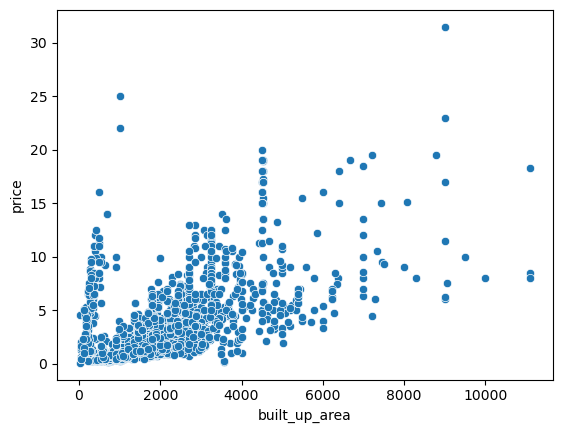

In [422]:
sns.scatterplot(x=df['built_up_area'],y=df['price'])

In [423]:
anamoly_df = df[(df['built_up_area'] < 2000) & (df['price'] > 2.5)][['price','area','built_up_area']]

In [424]:
anamoly_df.shape

(289, 3)

In [425]:
anamoly_df['built_up_area'] = anamoly_df['area']

In [426]:
anamoly_df

,price,area,built_up_area
49,2.80,1650.0,1650.0
77,2.70,2159.0,2159.0
85,3.87,2250.0,2250.0
100,2.85,1828.0,1828.0
159,2.80,1867.0,1867.0
207,2.65,1433.0,1433.0
216,3.00,1667.0,1667.0
217,3.67,2040.0,2040.0
219,3.29,1828.0,1828.0
221,2.79,1969.0,1969.0


In [427]:
df.update(anamoly_df)

<Axes: xlabel='built_up_area', ylabel='price'>

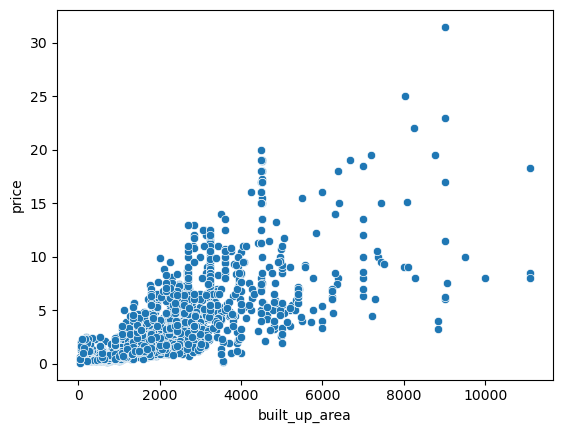

In [428]:
sns.scatterplot(x = df['built_up_area'], y= df['price'])

In [429]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,area,areaWithType,bedRoom,bathroom,balcony,floorNum,facing,agePossession,super_built_up_area,built_up_area,carpet_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score,area_room_ratio
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,900.0,Carpet area: 900 (83.61 sq.m.),2.0,2.0,1,4.0,West,Relatively New,NaN,1000.0,900.0,0.0,0.0,0.0,0.0,0.0,2.0,28.0,450.0
1,flat,apna enclave,sector 5,0.50,7692.0,650.0,Carpet area: 650 (60.39 sq.m.),2.0,2.0,1,1.0,West,Old Property,NaN,722.0,650.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0,325.0
2,flat,tulsiani easy in homes,sector 35,0.40,6723.0,595.0,Carpet area: 595 (55.28 sq.m.),2.0,2.0,3,12.0,NA,New Property,NaN,661.0,595.0,0.0,0.0,0.0,0.0,0.0,2.0,36.0,297.5
3,flat,smart world orchard,sector 61,1.47,12250.0,1200.0,Carpet area: 1200 (111.48 sq.m.),2.0,2.0,2,2.0,NA,Undefined,NaN,1333.0,1200.0,0.0,1.0,0.0,0.0,0.0,2.0,76.0,600.0
4,flat,parkwood westend,sector 92,0.70,5204.0,1345.0,Super Built up area 1345(124.95 sq.m.),2.0,2.0,3,5.0,NA,Under Construction,1345.0,1217.0,NaN,0.0,1.0,0.0,0.0,0.0,2.0,0.0,672.5


In [430]:
df.drop(columns=['area','areaWithType','super_built_up_area','carpet_area','area_room_ratio'], inplace=True)

In [431]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,bedRoom,bathroom,balcony,floorNum,facing,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,2.0,2.0,1,4.0,West,Relatively New,1000.0,0.0,0.0,0.0,0.0,0.0,2.0,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,2.0,2.0,1,1.0,West,Old Property,722.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6723.0,2.0,2.0,3,12.0,NA,New Property,661.0,0.0,0.0,0.0,0.0,0.0,2.0,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,2.0,2.0,2,2.0,NA,Undefined,1333.0,0.0,1.0,0.0,0.0,0.0,2.0,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,2.0,2.0,3,5.0,NA,Under Construction,1217.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0


In [432]:
df.isnull().sum()

Property_type         0
society               0
sector                0
price                 0
Price_Per_sqFeets     0
bedRoom               0
bathroom              0
balcony               0
floorNum             19
facing                0
agePossession         0
built_up_area         0
servant room          0
study room            0
others                0
pooja room            0
store room            0
furnishing_type       0
luxury_score          0
dtype: int64

In [433]:
df[df['floorNum'].isnull()]

,Property_type,society,sector,price,Price_Per_sqFeets,bedRoom,bathroom,balcony,floorNum,facing,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
180,flat,experion heartsong,sector 104,1.08,6150.0,3.0,3.0,0,NaN,NA,Under Construction,1758.0,0.0,0.0,0.0,0.0,0.0,2.0,53.0
2758,flat,nan,sector 78,0.60,3692.0,2.0,2.0,0,NaN,NA,Under Construction,1625.0,0.0,0.0,0.0,0.0,0.0,2.0,31.0
3020,house,vipul tatvam villa,sector 48,8.50,26235.0,4.0,4.0,2,NaN,East,Moderately Old,3240.0,0.0,0.0,0.0,0.0,0.0,2.0,160.0
3048,house,independent,sector 23,5.60,17284.0,8.0,6.0,3+,NaN,South-West,Moderately Old,3240.0,0.0,0.0,0.0,0.0,0.0,2.0,146.0
3125,house,independent,sector 23,1.45,2984.0,3.0,3.0,1,NaN,NA,Old Property,540.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
3174,house,independent,sector 5,1.50,10288.0,3.0,3.0,0,NaN,NA,Old Property,210.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
3192,house,independent,sector 43,4.12,8889.0,2.0,1.0,3+,NaN,NA,Moderately Old,4635.0,0.0,0.0,0.0,0.0,0.0,2.0,8.0
3203,house,independent,sector 23,2.50,5472.0,3.0,2.0,1,NaN,NA,Old Property,4000.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
3264,house,independent,sector 43,0.65,11111.0,4.0,2.0,2,NaN,NA,Moderately Old,585.0,0.0,0.0,0.0,0.0,0.0,2.0,59.0
3287,house,ansal sushant lok plots,sector 43,3.30,26570.0,1.0,1.0,0,NaN,NA,Under Construction,1242.0,0.0,0.0,0.0,0.0,0.0,2.0,38.0


In [434]:
df[df['Property_type'] == 'house']['floorNum'].median()

2.0

In [435]:
df['floorNum'].fillna(2.0, inplace=True)

In [436]:
df.isnull().sum()

Property_type        0
society              0
sector               0
price                0
Price_Per_sqFeets    0
bedRoom              0
bathroom             0
balcony              0
floorNum             0
facing               0
agePossession        0
built_up_area        0
servant room         0
study room           0
others               0
pooja room           0
store room           0
furnishing_type      0
luxury_score         0
dtype: int64

### Facing

<Axes: ylabel='facing'>

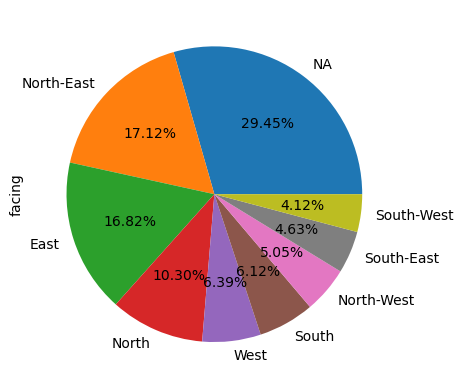

In [437]:
df['facing'].value_counts().plot(kind='pie',autopct='%0.2f%%')

In [438]:
df.drop(columns=['facing'], inplace=True)

In [439]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,bedRoom,bathroom,balcony,floorNum,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,2.0,2.0,1,4.0,Relatively New,1000.0,0.0,0.0,0.0,0.0,0.0,2.0,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,2.0,2.0,1,1.0,Old Property,722.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6723.0,2.0,2.0,3,12.0,New Property,661.0,0.0,0.0,0.0,0.0,0.0,2.0,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,2.0,2.0,2,2.0,Undefined,1333.0,0.0,1.0,0.0,0.0,0.0,2.0,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,2.0,2.0,3,5.0,Under Construction,1217.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0


In [440]:
df.isnull().sum()

Property_type        0
society              0
sector               0
price                0
Price_Per_sqFeets    0
bedRoom              0
bathroom             0
balcony              0
floorNum             0
agePossession        0
built_up_area        0
servant room         0
study room           0
others               0
pooja room           0
store room           0
furnishing_type      0
luxury_score         0
dtype: int64

In [441]:
df.isnull().sum()

Property_type        0
society              0
sector               0
price                0
Price_Per_sqFeets    0
bedRoom              0
bathroom             0
balcony              0
floorNum             0
agePossession        0
built_up_area        0
servant room         0
study room           0
others               0
pooja room           0
store room           0
furnishing_type      0
luxury_score         0
dtype: int64

In [442]:
df[df['agePossession'] == 'Undefined']

,Property_type,society,sector,price,Price_Per_sqFeets,bedRoom,bathroom,balcony,floorNum,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
3,flat,smart world orchard,sector 61,1.47,12250.0,2.0,2.0,2,2.0,Undefined,1333.0,0.0,1.0,0.0,0.0,0.0,2.0,76.0
5,flat,signature global infinity mall,sector 36,0.41,6269.0,2.0,2.0,3,3.0,Undefined,654.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
9,flat,raheja revanta,sector 78,4.75,16886.0,3.0,3.0,2,31.0,Undefined,2813.0,1.0,0.0,0.0,0.0,0.0,2.0,100.0
10,flat,signature global city 81,sector 81,0.96,9766.0,2.0,2.0,2,1.0,Undefined,1194.0,0.0,0.0,0.0,0.0,0.0,2.0,49.0
15,flat,sobha city,sector 108,3.95,16859.0,4.0,5.0,3,25.0,Undefined,2343.0,0.0,0.0,0.0,0.0,0.0,2.0,59.0
16,flat,senate court,sector 62,0.90,14085.0,1.0,1.0,0,0.0,Undefined,639.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
17,flat,shapoorji pallonji joyville gurugram,sector 102,1.05,11475.0,2.0,2.0,2,0.0,Undefined,1017.0,0.0,0.0,0.0,0.0,0.0,2.0,49.0
20,flat,smart world gems,sector 89,1.01,9157.0,2.0,2.0,2,4.0,Undefined,1226.0,0.0,1.0,0.0,0.0,0.0,2.0,38.0
25,flat,the serenas,sector 36,0.42,7910.0,2.0,2.0,1,3.0,Undefined,590.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
26,flat,m3m golfestate,sector 65,6.15,18331.0,3.0,4.0,2,20.0,Undefined,3355.0,0.0,0.0,0.0,0.0,0.0,2.0,34.0


In [443]:
def mode_based_imputation(row):
    if row['agePossession'] == 'Undefined':
        mode_value = df[(df['sector'] == row['sector']) & (df['Property_type'] == row['Property_type'])]['agePossession'].mode()
        if not mode_value.empty:
            return mode_value.iloc[0]
        else:
            return np.nan
    else:
        return row['agePossession']

In [444]:
df['agePossession'] = df.apply(mode_based_imputation,axis=1)

In [445]:
df['agePossession'].value_counts()

Relatively New        1858
New Property           675
Moderately Old         625
Old Property           363
Under Construction     131
Undefined               87
Name: agePossession, dtype: int64

In [446]:
def mode_based_imputation2(row):
    if row['agePossession'] == 'Undefined':
        mode_value = df[(df['sector'] == row['sector'])]['agePossession'].mode()
        if not mode_value.empty:
            return mode_value.iloc[0]
        else:
            return np.nan
    else:
        return row['agePossession']

In [447]:
df['agePossession'] = df.apply(mode_based_imputation2, axis=1)

In [448]:
df['agePossession'].value_counts()

Relatively New        1878
New Property           682
Moderately Old         632
Old Property           368
Under Construction     131
Undefined               48
Name: agePossession, dtype: int64

In [449]:
def mode_based_imputation3(row):
    if row['agePossession'] == 'Undefined':
        mode_value = df[(df['Property_type'] == row['Property_type'])]['agePossession'].mode()
        if not mode_value.empty:
            return mode_value.iloc[0]
        else:
            return np.nan
    else:
        return row['agePossession']

In [450]:
df['agePossession'] = df.apply(mode_based_imputation3,axis=1)

In [451]:
df['agePossession'].value_counts()

Relatively New        1901
New Property           682
Moderately Old         657
Old Property           368
Under Construction     131
Name: agePossession, dtype: int64

In [452]:
df.isnull().sum()

Property_type        0
society              0
sector               0
price                0
Price_Per_sqFeets    0
bedRoom              0
bathroom             0
balcony              0
floorNum             0
agePossession        0
built_up_area        0
servant room         0
study room           0
others               0
pooja room           0
store room           0
furnishing_type      0
luxury_score         0
dtype: int64

### Feature Selection

In [453]:
df.shape

(3739, 18)

In [454]:
df.head()

,Property_type,society,sector,price,Price_Per_sqFeets,bedRoom,bathroom,balcony,floorNum,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,maa bhagwati residency,sector 7,0.45,5000.0,2.0,2.0,1,4.0,Relatively New,1000.0,0.0,0.0,0.0,0.0,0.0,2.0,28.0
1,flat,apna enclave,sector 5,0.50,7692.0,2.0,2.0,1,1.0,Old Property,722.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0
2,flat,tulsiani easy in homes,sector 35,0.40,6723.0,2.0,2.0,3,12.0,New Property,661.0,0.0,0.0,0.0,0.0,0.0,2.0,36.0
3,flat,smart world orchard,sector 61,1.47,12250.0,2.0,2.0,2,2.0,New Property,1333.0,0.0,1.0,0.0,0.0,0.0,2.0,76.0
4,flat,parkwood westend,sector 92,0.70,5204.0,2.0,2.0,3,5.0,Under Construction,1217.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0


In [455]:
train_df = df.drop(columns=['society','Price_Per_sqFeets'])

In [456]:
train_df.head()

,Property_type,sector,price,bedRoom,bathroom,balcony,floorNum,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,sector 7,0.45,2.0,2.0,1,4.0,Relatively New,1000.0,0.0,0.0,0.0,0.0,0.0,2.0,28.0
1,flat,sector 5,0.50,2.0,2.0,1,1.0,Old Property,722.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0
2,flat,sector 35,0.40,2.0,2.0,3,12.0,New Property,661.0,0.0,0.0,0.0,0.0,0.0,2.0,36.0
3,flat,sector 61,1.47,2.0,2.0,2,2.0,New Property,1333.0,0.0,1.0,0.0,0.0,0.0,2.0,76.0
4,flat,sector 92,0.70,2.0,2.0,3,5.0,Under Construction,1217.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0


<Axes: >

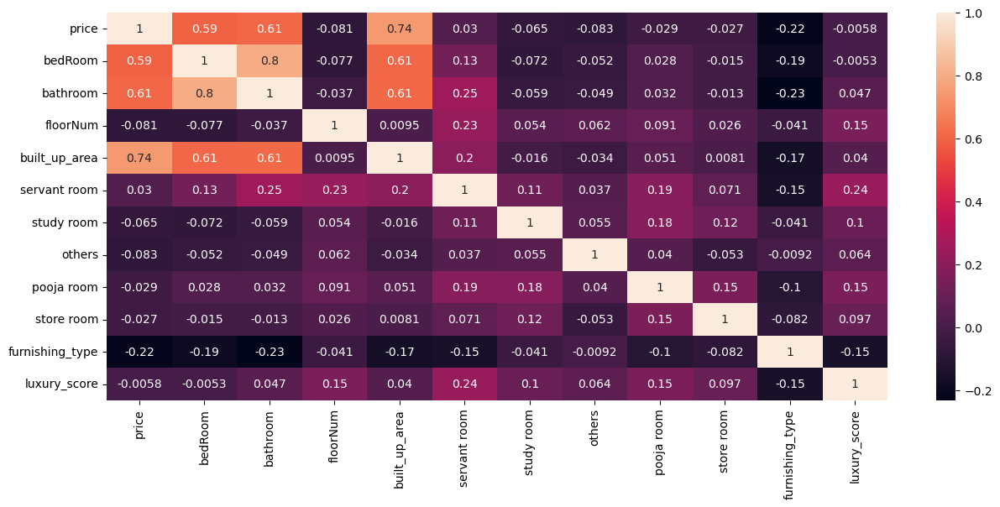

In [457]:
plt.figure(figsize=(15,6))
sns.heatmap(train_df.corr(), annot=True)

In [458]:
train_df.corr()['price'].sort_values(ascending=False)

price              1.000000
built_up_area      0.743406
bathroom           0.608828
bedRoom            0.593226
servant room       0.030008
luxury_score      -0.005784
store room        -0.027214
pooja room        -0.028510
study room        -0.065093
floorNum          -0.080989
others            -0.083325
furnishing_type   -0.220254
Name: price, dtype: float64

### luxury score

<Axes: >

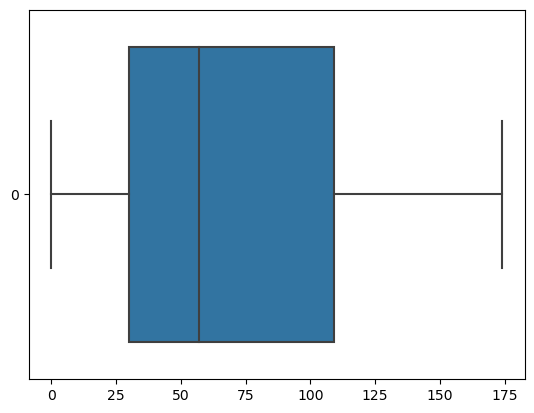

In [459]:
sns.boxplot(df['luxury_score'], orient='h')

In [460]:
def categorize_luxury(score):
    if 0 <= score <50:
        return "Low"
    elif 50 <= score < 150:
        return "Medium"
    elif 150 <= score <= 175:
        return "High"
    else:
        return None

In [461]:
train_df['luxury_score'] = train_df['luxury_score'].apply(categorize_luxury)

In [462]:
train_df.head()

,Property_type,sector,price,bedRoom,bathroom,balcony,floorNum,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score
0,flat,sector 7,0.45,2.0,2.0,1,4.0,Relatively New,1000.0,0.0,0.0,0.0,0.0,0.0,2.0,Low
1,flat,sector 5,0.50,2.0,2.0,1,1.0,Old Property,722.0,0.0,0.0,0.0,0.0,0.0,0.0,Low
2,flat,sector 35,0.40,2.0,2.0,3,12.0,New Property,661.0,0.0,0.0,0.0,0.0,0.0,2.0,Low
3,flat,sector 61,1.47,2.0,2.0,2,2.0,New Property,1333.0,0.0,1.0,0.0,0.0,0.0,2.0,Medium
4,flat,sector 92,0.70,2.0,2.0,3,5.0,Under Construction,1217.0,0.0,1.0,0.0,0.0,0.0,2.0,Low


### floorNum

<Axes: >

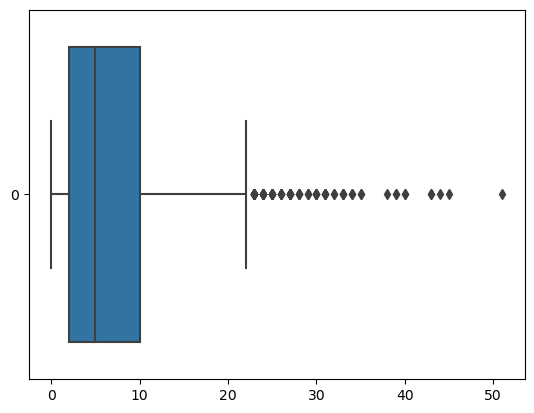

In [463]:
sns.boxplot(df['floorNum'], orient='h')

In [464]:
df['floorNum'].value_counts()

2.0     535
3.0     502
1.0     361
4.0     286
8.0     199
6.0     184
7.0     183
10.0    183
5.0     174
9.0     169
12.0    160
0.0     132
14.0    120
11.0    115
15.0     82
16.0     53
17.0     51
13.0     41
18.0     37
19.0     33
20.0     26
21.0     16
23.0     15
22.0     13
24.0     11
25.0      9
27.0      8
26.0      5
30.0      5
33.0      4
28.0      4
31.0      4
29.0      3
43.0      2
35.0      2
32.0      2
39.0      2
34.0      2
40.0      2
38.0      1
45.0      1
44.0      1
51.0      1
Name: floorNum, dtype: int64

In [465]:
def categorize_floor(floor):
    if 0 <= floor <=2:
        return "Low Floor"
    elif 3 <= floor <= 10:
        return "Mid Floor"
    elif 11 <= floor <= 51:
        return "High Floor"
    else:
        return None

In [466]:
train_df['floor_category'] = train_df['floorNum'].apply(categorize_floor)

In [467]:
train_df.head()

,Property_type,sector,price,bedRoom,bathroom,balcony,floorNum,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,luxury_score,floor_category
0,flat,sector 7,0.45,2.0,2.0,1,4.0,Relatively New,1000.0,0.0,0.0,0.0,0.0,0.0,2.0,Low,Mid Floor
1,flat,sector 5,0.50,2.0,2.0,1,1.0,Old Property,722.0,0.0,0.0,0.0,0.0,0.0,0.0,Low,Low Floor
2,flat,sector 35,0.40,2.0,2.0,3,12.0,New Property,661.0,0.0,0.0,0.0,0.0,0.0,2.0,Low,High Floor
3,flat,sector 61,1.47,2.0,2.0,2,2.0,New Property,1333.0,0.0,1.0,0.0,0.0,0.0,2.0,Medium,Low Floor
4,flat,sector 92,0.70,2.0,2.0,3,5.0,Under Construction,1217.0,0.0,1.0,0.0,0.0,0.0,2.0,Low,Mid Floor


In [468]:
train_df.drop(columns=['floorNum','luxury_score'], inplace=True)

In [469]:
train_df.head()

,Property_type,sector,price,bedRoom,bathroom,balcony,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,floor_category
0,flat,sector 7,0.45,2.0,2.0,1,Relatively New,1000.0,0.0,0.0,0.0,0.0,0.0,2.0,Mid Floor
1,flat,sector 5,0.50,2.0,2.0,1,Old Property,722.0,0.0,0.0,0.0,0.0,0.0,0.0,Low Floor
2,flat,sector 35,0.40,2.0,2.0,3,New Property,661.0,0.0,0.0,0.0,0.0,0.0,2.0,High Floor
3,flat,sector 61,1.47,2.0,2.0,2,New Property,1333.0,0.0,1.0,0.0,0.0,0.0,2.0,Low Floor
4,flat,sector 92,0.70,2.0,2.0,3,Under Construction,1217.0,0.0,1.0,0.0,0.0,0.0,2.0,Mid Floor


In [470]:
from sklearn.preprocessing import OrdinalEncoder

# Create a copy of the original data for Label encoding
data_label_encoded = train_df.copy()

categorical_cols = train_df.select_dtypes(include=['object']).columns

# Apply Label encoding to categorical columns
for col in categorical_cols:
    oe = OrdinalEncoder()
    data_label_encoded[col] = oe.fit_transform(data_label_encoded[[col]])
    print(oe.categories_)
    
# Splitting the dataset into training and testing sets
x_label = data_label_encoded.drop('price', axis=1)
y_label = data_label_encoded['price']

[array(['flat', 'house'], dtype=object)]
[array(['sector 1', 'sector 10', 'sector 102', 'sector 103', 'sector 104',
       'sector 105', 'sector 106', 'sector 107', 'sector 108',
       'sector 109', 'sector 11', 'sector 110', 'sector 111',
       'sector 112', 'sector 113', 'sector 12', 'sector 13', 'sector 14',
       'sector 15', 'sector 17', 'sector 2', 'sector 21', 'sector 22',
       'sector 23', 'sector 25', 'sector 26', 'sector 27', 'sector 28',
       'sector 29', 'sector 3', 'sector 30', 'sector 31', 'sector 32',
       'sector 33', 'sector 35', 'sector 36', 'sector 37', 'sector 38',
       'sector 39', 'sector 4', 'sector 40', 'sector 41', 'sector 43',
       'sector 45', 'sector 46', 'sector 47', 'sector 48', 'sector 49',
       'sector 5', 'sector 50', 'sector 51', 'sector 52', 'sector 53',
       'sector 54', 'sector 55', 'sector 56', 'sector 57', 'sector 58',
       'sector 59', 'sector 6', 'sector 60', 'sector 61', 'sector 62',
       'sector 63', 'sector 65', 'sector 6

In [471]:
x_label

,Property_type,sector,bedRoom,bathroom,balcony,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,floor_category
0,0.0,69.0,2.0,2.0,1.0,3.0,1000.000000,0.0,0.0,0.0,0.0,0.0,2.0,2.0
1,0.0,48.0,2.0,2.0,1.0,2.0,722.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,34.0,2.0,2.0,3.0,1.0,661.000000,0.0,0.0,0.0,0.0,0.0,2.0,0.0
3,0.0,61.0,2.0,2.0,2.0,1.0,1333.000000,0.0,1.0,0.0,0.0,0.0,2.0,1.0
4,0.0,92.0,2.0,2.0,3.0,4.0,1217.000000,0.0,1.0,0.0,0.0,0.0,2.0,2.0
5,0.0,35.0,2.0,2.0,3.0,1.0,654.000000,0.0,0.0,0.0,0.0,0.0,2.0,2.0
6,0.0,4.0,3.0,3.0,3.0,1.0,1357.000000,0.0,0.0,0.0,0.0,0.0,2.0,2.0
7,0.0,4.0,3.0,4.0,3.0,1.0,2544.000000,0.0,0.0,0.0,0.0,0.0,2.0,0.0
8,0.0,87.0,2.0,4.0,4.0,4.0,1350.000000,0.0,1.0,0.0,0.0,0.0,2.0,1.0
9,0.0,77.0,3.0,3.0,2.0,0.0,2813.000000,1.0,0.0,0.0,0.0,0.0,2.0,0.0


## Feature Selection Technique-1 - Correlation Analysis

<Axes: >

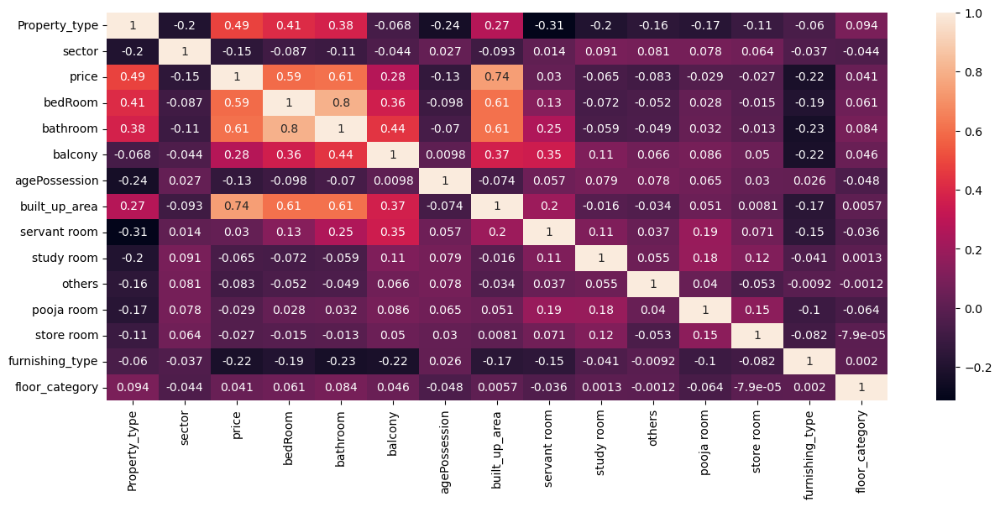

In [472]:
plt.figure(figsize=(15,6))
sns.heatmap(data_label_encoded.corr(), annot=True)

In [473]:
f1_df1 = data_label_encoded.corr()['price'].iloc[1:].to_frame().reset_index().rename(columns={'index':'feature','price':'corr_coeff'})
f1_df1

,feature,corr_coeff
0,sector,-0.149608
1,price,1.000000
2,bedRoom,0.593226
3,bathroom,0.608828
4,balcony,0.276302
5,agePossession,-0.134956
6,built_up_area,0.743406
7,servant room,0.030008
8,study room,-0.065093
9,others,-0.083325


### Technique 2 - Random Forest Feature Importance

In [474]:
from sklearn.ensemble import RandomForestRegressor

# Train a Random Forest regression on lebel encoded data
rf_label = RandomForestRegressor(n_estimators=100, random_state=42)
rf_label.fit(x_label,y_label)

# Extract feature importance scores for Label encoded data
fi_df2 = pd.DataFrame({
    'feature':x_label.columns,
    'rf_importance': rf_label.feature_importances_
}).sort_values(by='rf_importance', ascending=False)

In [475]:
fi_df2

,feature,rf_importance
6,built_up_area,0.650279
1,sector,0.124635
0,Property_type,0.106615
3,bathroom,0.031872
2,bedRoom,0.029872
4,balcony,0.017583
5,agePossession,0.017408
12,furnishing_type,0.009796
13,floor_category,0.007231
7,servant room,0.001441


### Technique 3 - Gradient Boosting Feature importances

In [476]:
from sklearn.ensemble import GradientBoostingRegressor

# Train a Gradient Boosting Regressor on Label encoded data
gb_label = GradientBoostingRegressor()
gb_label.fit(x_label,y_label)

# Extract feature importance scores for label encoded data
fi_df3 = pd.DataFrame({
    'feature': x_label.columns,
    'gb_importance': gb_label.feature_importances_
}).sort_values(by='gb_importance', ascending=False)

fi_df3

,feature,gb_importance
6,built_up_area,0.685856
1,sector,0.113228
0,Property_type,0.101239
3,bathroom,0.041516
2,bedRoom,0.039715
5,agePossession,0.007195
12,furnishing_type,0.006177
4,balcony,0.004404
7,servant room,0.000334
13,floor_category,0.000328


### Technique - 4 - Permutation Importance

In [477]:
from sklearn.inspection import permutation_importance
from sklearn.model_selection import train_test_split

x_train_label, x_test_label, y_train_label, y_test_label = train_test_split(x_label, y_label, test_size=0.2, random_state=42)

# Train a Random Forest Regrassor on label encoded data
rf_label = RandomForestRegressor(n_estimators=100, random_state=42)
rf_label.fit(x_train_label, y_train_label)

# Calculate Permutation Importance
perm_importance = permutation_importance(rf_label, x_test_label,y_test_label, n_repeats=30, random_state=42)

# Organize results into a DataFrame

fi_df4 = pd.DataFrame({
    'feature': x_label.columns,
    'permutation_importance': perm_importance.importances_mean
}).sort_values(by='permutation_importance', ascending=False)

In [478]:
fi_df4

,feature,permutation_importance
6,built_up_area,0.744556
1,sector,0.181758
0,Property_type,0.179379
2,bedRoom,0.023362
3,bathroom,0.020117
4,balcony,0.006799
7,servant room,0.002430
5,agePossession,0.002202
8,study room,0.000214
10,pooja room,0.000174


### Technique 5 - LASSO

In [479]:
from sklearn.linear_model import Lasso
from sklearn.preprocessing import StandardScaler

# Standardize the features
scaler = StandardScaler()
x_scaled = scaler.fit_transform(x_label)

# Train a LASSO regression model
# We'll use a relatively small value for alpha (the regularization strength) for demonstration purposes
lasso = Lasso(alpha=0.01, random_state=42)
lasso.fit(x_label, y_label)

#Extract coefficients
fi_df5 = pd.DataFrame({
    'feature': x_label.columns,
    'lasso_coeff': lasso.coef_
}).sort_values(by='lasso_coeff', ascending=False)

fi_df5

,feature,lasso_coeff
0,Property_type,1.494596
3,bathroom,0.276598
2,bedRoom,0.031224
4,balcony,0.023576
6,built_up_area,0.001315
8,study room,0.000000
11,store room,-0.000000
13,floor_category,-0.000000
1,sector,-0.003177
9,others,-0.020693


### Technique 6 - RFE

In [480]:
from sklearn.feature_selection import RFE

# Initialize the base estimator
estimator = RandomForestRegressor()

# Apply RFE on the label-encoded and standardized training data
selector_label = RFE(estimator, n_features_to_select=x_label.shape[1], step=1)
selector_label = selector_label.fit(x_label, y_label)

# Get the selected features based on REF
selected_features = x_label.columns[selector_label.support_]

# Extract the coefficients for the selected features from the underlying Linearregression model
selected_coefficients = selector_label.estimator_.feature_importances_

# Organize the results into a DataFrame
fi_df6 = pd.DataFrame({
    'feature': selected_features,
    'rfe_score': selected_coefficients
}).sort_values(by='rfe_score', ascending=False)

fi_df6

,feature,rfe_score
6,built_up_area,0.652088
1,sector,0.126371
0,Property_type,0.101186
2,bedRoom,0.033480
3,bathroom,0.030038
4,balcony,0.017499
5,agePossession,0.017390
12,furnishing_type,0.009830
13,floor_category,0.006853
7,servant room,0.001804


### Technique 7 - Linear Regression Weights

In [481]:
# Train a linear regression model on the Label encoded and standardized training data
from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()
lin_reg.fit(x_scaled, y_label)

# Extract coefficients
fi_df7 = pd.DataFrame({
    'feature': x_label.columns,
    'reg_coeffs': lin_reg.coef_
}).sort_values(by='reg_coeffs', ascending=False)

fi_df7

,feature,reg_coeffs
6,built_up_area,1.547393
0,Property_type,0.626635
3,bathroom,0.398583
4,balcony,0.046837
2,bedRoom,0.039820
8,study room,0.028782
11,store room,-0.011420
13,floor_category,-0.011646
9,others,-0.041685
5,agePossession,-0.047737


In [482]:
final_fi_df = f1_df1.merge(fi_df2, on='feature').merge(fi_df3, on='feature').merge(fi_df4, on='feature').merge(fi_df5, on='feature').merge(fi_df6, on='feature').merge(fi_df7, on = 'feature').set_index('feature')

In [483]:
final_fi_df

,corr_coeff,rf_importance,gb_importance,permutation_importance,lasso_coeff,rfe_score,reg_coeffs
feature,,,,,,,
sector,-0.149608,0.124635,0.113228,0.181758,-0.003177,0.126371,-0.088531
bedRoom,0.593226,0.029872,0.039715,0.023362,0.031224,0.033480,0.039820
bathroom,0.608828,0.031872,0.041516,0.020117,0.276598,0.030038,0.398583
balcony,0.276302,0.017583,0.004404,0.006799,0.023576,0.017499,0.046837
agePossession,-0.134956,0.017408,0.007195,0.002202,-0.037532,0.017390,-0.047737
built_up_area,0.743406,0.650279,0.685856,0.744556,0.001315,0.652088,1.547393
servant room,0.030008,0.001441,0.000334,0.002430,-0.352845,0.001804,-0.176805
study room,-0.065093,0.001044,0.000000,0.000214,0.000000,0.001050,0.028782
others,-0.083325,0.000884,0.000009,0.000073,-0.020693,0.001035,-0.041685


In [484]:
# normalize the score
final_fi_df = final_fi_df.divide(final_fi_df.sum(axis=0), axis=1)

In [485]:
final_fi_df[['rf_importance','gb_importance','permutation_importance','rfe_score']].mean(axis=1).sort_values(ascending=False)

feature
built_up_area      0.744134
sector             0.147907
bedRoom            0.034681
bathroom           0.033956
balcony            0.012748
agePossession      0.012271
furnishing_type    0.006733
floor_category     0.003967
servant room       0.001618
study room         0.000639
pooja room         0.000585
others             0.000556
store room         0.000205
dtype: float64

In [486]:
# to drop pooja room, study room, others
x_label

,Property_type,sector,bedRoom,bathroom,balcony,agePossession,built_up_area,servant room,study room,others,pooja room,store room,furnishing_type,floor_category
0,0.0,69.0,2.0,2.0,1.0,3.0,1000.000000,0.0,0.0,0.0,0.0,0.0,2.0,2.0
1,0.0,48.0,2.0,2.0,1.0,2.0,722.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,34.0,2.0,2.0,3.0,1.0,661.000000,0.0,0.0,0.0,0.0,0.0,2.0,0.0
3,0.0,61.0,2.0,2.0,2.0,1.0,1333.000000,0.0,1.0,0.0,0.0,0.0,2.0,1.0
4,0.0,92.0,2.0,2.0,3.0,4.0,1217.000000,0.0,1.0,0.0,0.0,0.0,2.0,2.0
5,0.0,35.0,2.0,2.0,3.0,1.0,654.000000,0.0,0.0,0.0,0.0,0.0,2.0,2.0
6,0.0,4.0,3.0,3.0,3.0,1.0,1357.000000,0.0,0.0,0.0,0.0,0.0,2.0,2.0
7,0.0,4.0,3.0,4.0,3.0,1.0,2544.000000,0.0,0.0,0.0,0.0,0.0,2.0,0.0
8,0.0,87.0,2.0,4.0,4.0,4.0,1350.000000,0.0,1.0,0.0,0.0,0.0,2.0,1.0
9,0.0,77.0,3.0,3.0,2.0,0.0,2813.000000,1.0,0.0,0.0,0.0,0.0,2.0,0.0


In [487]:
# with all the cols
from sklearn.model_selection import cross_val_score

rf = RandomForestRegressor(n_estimators=100, random_state=42)

scorrs = cross_val_score(rf, x_label, y_label, cv=5, scoring='r2')

In [488]:
scorrs.mean()

0.7661328190515793

In [489]:
scores = cross_val_score(rf, x_label.drop(columns=['pooja room','study room','others']), y_label, cv=5, scoring='r2')

In [490]:
scores.mean()

0.7663773861941803

In [492]:
final_df = train_df.drop(columns=['pooja room','study room','others'])
final_df['price'] =y_label

In [493]:
final_df

,Property_type,sector,price,bedRoom,bathroom,balcony,agePossession,built_up_area,servant room,store room,furnishing_type,floor_category
0,flat,sector 7,0.45,2.0,2.0,1,Relatively New,1000.000000,0.0,0.0,2.0,Mid Floor
1,flat,sector 5,0.50,2.0,2.0,1,Old Property,722.000000,0.0,0.0,0.0,Low Floor
2,flat,sector 35,0.40,2.0,2.0,3,New Property,661.000000,0.0,0.0,2.0,High Floor
3,flat,sector 61,1.47,2.0,2.0,2,New Property,1333.000000,0.0,0.0,2.0,Low Floor
4,flat,sector 92,0.70,2.0,2.0,3,Under Construction,1217.000000,0.0,0.0,2.0,Mid Floor
5,flat,sector 36,0.41,2.0,2.0,3,New Property,654.000000,0.0,0.0,2.0,Mid Floor
6,flat,sector 104,2.00,3.0,3.0,3,New Property,1357.000000,0.0,0.0,2.0,Mid Floor
7,flat,sector 104,1.80,3.0,4.0,3,New Property,2544.000000,0.0,0.0,2.0,High Floor
8,flat,sector 88,1.10,2.0,4.0,3+,Under Construction,1350.000000,0.0,0.0,2.0,Low Floor
9,flat,sector 78,4.75,3.0,3.0,2,Moderately Old,2813.000000,1.0,0.0,2.0,High Floor


In [494]:
final_df['luxury_category'] = df['luxury_score'].apply(categorize_luxury)

In [495]:
final_df

,Property_type,sector,price,bedRoom,bathroom,balcony,agePossession,built_up_area,servant room,store room,furnishing_type,floor_category,luxury_category
0,flat,sector 7,0.45,2.0,2.0,1,Relatively New,1000.000000,0.0,0.0,2.0,Mid Floor,Low
1,flat,sector 5,0.50,2.0,2.0,1,Old Property,722.000000,0.0,0.0,0.0,Low Floor,Low
2,flat,sector 35,0.40,2.0,2.0,3,New Property,661.000000,0.0,0.0,2.0,High Floor,Low
3,flat,sector 61,1.47,2.0,2.0,2,New Property,1333.000000,0.0,0.0,2.0,Low Floor,Medium
4,flat,sector 92,0.70,2.0,2.0,3,Under Construction,1217.000000,0.0,0.0,2.0,Mid Floor,Low
5,flat,sector 36,0.41,2.0,2.0,3,New Property,654.000000,0.0,0.0,2.0,Mid Floor,Low
6,flat,sector 104,2.00,3.0,3.0,3,New Property,1357.000000,0.0,0.0,2.0,Mid Floor,Low
7,flat,sector 104,1.80,3.0,4.0,3,New Property,2544.000000,0.0,0.0,2.0,High Floor,Medium
8,flat,sector 88,1.10,2.0,4.0,3+,Under Construction,1350.000000,0.0,0.0,2.0,Low Floor,Medium
9,flat,sector 78,4.75,3.0,3.0,2,Moderately Old,2813.000000,1.0,0.0,2.0,High Floor,Medium


In [496]:
final_df.isnull().sum()

Property_type      0
sector             0
price              0
bedRoom            0
bathroom           0
balcony            0
agePossession      0
built_up_area      0
servant room       0
store room         0
furnishing_type    0
floor_category     0
luxury_category    0
dtype: int64

### Model Train and Select

In [497]:
final_df.head()

,Property_type,sector,price,bedRoom,bathroom,balcony,agePossession,built_up_area,servant room,store room,furnishing_type,floor_category,luxury_category
0,flat,sector 7,0.45,2.0,2.0,1,Relatively New,1000.0,0.0,0.0,2.0,Mid Floor,Low
1,flat,sector 5,0.50,2.0,2.0,1,Old Property,722.0,0.0,0.0,0.0,Low Floor,Low
2,flat,sector 35,0.40,2.0,2.0,3,New Property,661.0,0.0,0.0,2.0,High Floor,Low
3,flat,sector 61,1.47,2.0,2.0,2,New Property,1333.0,0.0,0.0,2.0,Low Floor,Medium
4,flat,sector 92,0.70,2.0,2.0,3,Under Construction,1217.0,0.0,0.0,2.0,Mid Floor,Low


In [498]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3739 entries, 0 to 3960
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Property_type    3739 non-null   object 
 1   sector           3739 non-null   object 
 2   price            3739 non-null   float64
 3   bedRoom          3739 non-null   float64
 4   bathroom         3739 non-null   float64
 5   balcony          3739 non-null   object 
 6   agePossession    3739 non-null   object 
 7   built_up_area    3739 non-null   float64
 8   servant room     3739 non-null   float64
 9   store room       3739 non-null   float64
 10  furnishing_type  3739 non-null   float64
 11  floor_category   3739 non-null   object 
 12  luxury_category  3739 non-null   object 
dtypes: float64(7), object(6)
memory usage: 538.0+ KB


In [499]:
final_df['furnishing_type'].value_counts()

2.0    2496
0.0    1043
1.0     200
Name: furnishing_type, dtype: int64

In [500]:
# 2 -> unfurnished
# 0 -> semifurnished
# 1 -> furnished
final_df['furnishing_type'] = final_df['furnishing_type'].replace({2.0:'unfurnished',0.0:'semifurnished',1.0:'furnished'})

In [501]:
final_df.head()

,Property_type,sector,price,bedRoom,bathroom,balcony,agePossession,built_up_area,servant room,store room,furnishing_type,floor_category,luxury_category
0,flat,sector 7,0.45,2.0,2.0,1,Relatively New,1000.0,0.0,0.0,unfurnished,Mid Floor,Low
1,flat,sector 5,0.50,2.0,2.0,1,Old Property,722.0,0.0,0.0,semifurnished,Low Floor,Low
2,flat,sector 35,0.40,2.0,2.0,3,New Property,661.0,0.0,0.0,unfurnished,High Floor,Low
3,flat,sector 61,1.47,2.0,2.0,2,New Property,1333.0,0.0,0.0,unfurnished,Low Floor,Medium
4,flat,sector 92,0.70,2.0,2.0,3,Under Construction,1217.0,0.0,0.0,unfurnished,Mid Floor,Low


In [502]:
X = final_df.drop(columns=['price'])
y = final_df['price']

In [503]:
# Applying the log1p transformation to the target variable
y_transformed = np.log1p(y)

In [504]:
X.isnull().sum()

Property_type      0
sector             0
bedRoom            0
bathroom           0
balcony            0
agePossession      0
built_up_area      0
servant room       0
store room         0
furnishing_type    0
floor_category     0
luxury_category    0
dtype: int64

### Ordinal Encoding

In [505]:
columns_to_encode = ['Property_type','sector', 'balcony', 'agePossession', 'furnishing_type', 'luxury_category', 'floor_category']

In [506]:
# Creating a column transformer for preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['bedRoom', 'bathroom', 'built_up_area', 'servant room', 'store room']),
        ('cat', OrdinalEncoder(), columns_to_encode)
    ], 
    remainder='passthrough'
)

In [507]:
# Creating a pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

In [508]:
# K-fold cross-validation
kfold = KFold(n_splits=10, shuffle=True, random_state=42)
scores = cross_val_score(pipeline, X, y_transformed, cv=kfold, scoring='r2')

In [509]:
scores.mean(),scores.std()

(0.7224064490655878, 0.025291322728868786)

In [510]:
X_train, X_test, y_train, y_test = train_test_split(X,y_transformed,test_size=0.2,random_state=42)

In [511]:
pipeline.fit(X_train,y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num', StandardScaler(),
                                                  ['bedRoom', 'bathroom',
                                                   'built_up_area',
                                                   'servant room',
                                                   'store room']),
                                                 ('cat', OrdinalEncoder(),
                                                  ['Property_type', 'sector',
                                                   'balcony', 'agePossession',
                                                   'furnishing_type',
                                                   'luxury_category',
                                                   'floor_category'])])),
                ('regressor', LinearRegression())])

In [512]:
y_pred = pipeline.predict(X_test)

In [513]:
y_pred = np.expm1(y_pred)

In [514]:
mean_absolute_error(np.expm1(y_test),y_pred)

0.9386643134805507

In [515]:
def scorer(model_name, model):
    
    output = []
    
    output.append(model_name)
    
    pipeline = Pipeline([
        ('preprocessor', preprocessor),
        ('regressor', model)
    ])
    
    # K-fold cross-validation
    kfold = KFold(n_splits=10, shuffle=True, random_state=42)
    scores = cross_val_score(pipeline, X, y_transformed, cv=kfold, scoring='r2')
    
    output.append(scores.mean())
    
    X_train, X_test, y_train, y_test = train_test_split(X,y_transformed,test_size=0.2,random_state=42)
    
    pipeline.fit(X_train,y_train)
    
    y_pred = pipeline.predict(X_test)
    
    y_pred = np.expm1(y_pred)
    
    output.append(mean_absolute_error(np.expm1(y_test),y_pred))
    
    return output
    

In [516]:
model_dict = {
    'linear_reg':LinearRegression(),
    'svr':SVR(),
    'ridge':Ridge(),
    'LASSO':Lasso(),
    'decision tree': DecisionTreeRegressor(),
    'random forest':RandomForestRegressor(),
    'extra trees': ExtraTreesRegressor(),
    'gradient boosting': GradientBoostingRegressor(),
    'adaboost': AdaBoostRegressor(),
    'mlp': MLPRegressor(),
    'xgboost':XGBRegressor()
}

In [517]:
model_output = []
for model_name,model in model_dict.items():
    model_output.append(scorer(model_name, model))

In [518]:
model_output

[['linear_reg', 0.7224064490655878, 0.9386643134805507],
 ['svr', 0.7474794689453401, 0.8886334691407951],
 ['ridge', 0.7224094133712946, 0.9386736161950735],
 ['LASSO', 0.013513418277838352, 1.5656048842661239],
 ['decision tree', 0.7868007852482625, 0.750065841643673],
 ['random forest', 0.8827456110466722, 0.5575213891847124],
 ['extra trees', 0.8687670625749288, 0.5887254181963031],
 ['gradient boosting', 0.8697467251508526, 0.6015845813847359],
 ['adaboost', 0.7419784402358447, 0.9343828133011157],
 ['mlp', 0.7909957078916541, 0.7321176776675897],
 ['xgboost', 0.884592109280127, 0.5417583086050768]]

In [519]:
model_df = pd.DataFrame(model_output, columns=['name','r2','mae'])

In [520]:
model_df.sort_values(['mae'])

,name,r2,mae
10,xgboost,0.884592,0.541758
5,random forest,0.882746,0.557521
6,extra trees,0.868767,0.588725
7,gradient boosting,0.869747,0.601585
9,mlp,0.790996,0.732118
4,decision tree,0.786801,0.750066
1,svr,0.747479,0.888633
8,adaboost,0.741978,0.934383
0,linear_reg,0.722406,0.938664
2,ridge,0.722409,0.938674


### OneHotEncoding

In [521]:
# Creating a column transformer for preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['bedRoom', 'bathroom', 'built_up_area', 'servant room', 'store room']),
        ('cat', OrdinalEncoder(), columns_to_encode),
        ('cat1',OneHotEncoder(drop='first'),['sector','agePossession','furnishing_type'])
    ], 
    remainder='passthrough'
)

In [522]:
# Creating a pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

In [523]:
# K-fold cross-validation
kfold = KFold(n_splits=10, shuffle=True, random_state=42)
scores = cross_val_score(pipeline, X, y_transformed, cv=kfold, scoring='r2')

In [524]:
scores.mean()

0.8363984717598978

In [525]:
scores.std()

0.022124668842335642

In [526]:
X_train, X_test, y_train, y_test = train_test_split(X,y_transformed,test_size=0.2,random_state=42)

In [527]:
pipeline.fit(X_train,y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num', StandardScaler(),
                                                  ['bedRoom', 'bathroom',
                                                   'built_up_area',
                                                   'servant room',
                                                   'store room']),
                                                 ('cat', OrdinalEncoder(),
                                                  ['Property_type', 'sector',
                                                   'balcony', 'agePossession',
                                                   'furnishing_type',
                                                   'luxury_category',
                                                   'floor_category']),
                                                 ('cat1',
                                                  OneHotEncoder(drop='first'),
                                                  ['sector', 'agePossession',
                                                   'furnishing_type'])])),
                ('regressor', LinearRegression())])

In [528]:
y_pred = pipeline.predict(X_test)

In [529]:
y_pred = np.expm1(y_pred)

In [530]:
mean_absolute_error(np.expm1(y_test),y_pred)

0.7187607205903108

In [531]:
def scorer(model_name, model):
    
    output = []
    
    output.append(model_name)
    
    pipeline = Pipeline([
        ('preprocessor', preprocessor),
        ('regressor', model)
    ])
    
    # K-fold cross-validation
    kfold = KFold(n_splits=10, shuffle=True, random_state=42)
    scores = cross_val_score(pipeline, X, y_transformed, cv=kfold, scoring='r2')
    
    output.append(scores.mean())
    
    X_train, X_test, y_train, y_test = train_test_split(X,y_transformed,test_size=0.2,random_state=42)
    
    pipeline.fit(X_train,y_train)
    
    y_pred = pipeline.predict(X_test)
    
    y_pred = np.expm1(y_pred)
    
    output.append(mean_absolute_error(np.expm1(y_test),y_pred))
    
    return output
    

In [532]:
model_dict = {
    'linear_reg':LinearRegression(),
    'svr':SVR(),
    'ridge':Ridge(),
    'LASSO':Lasso(),
    'decision tree': DecisionTreeRegressor(),
    'random forest':RandomForestRegressor(),
    'extra trees': ExtraTreesRegressor(),
    'gradient boosting': GradientBoostingRegressor(),
    'adaboost': AdaBoostRegressor(),
    'mlp': MLPRegressor(),
    'xgboost':XGBRegressor()
}

In [533]:
model_output = []
for model_name,model in model_dict.items():
    model_output.append(scorer(model_name, model))

In [534]:
model_df = pd.DataFrame(model_output, columns=['name','r2','mae'])

In [535]:
model_df.sort_values(['mae'])

,name,r2,mae
6,extra trees,0.893406,0.489532
10,xgboost,0.891484,0.519229
5,random forest,0.888878,0.521628
7,gradient boosting,0.869651,0.607110
9,mlp,0.857675,0.636111
4,decision tree,0.795211,0.657041
0,linear_reg,0.836398,0.718761
2,ridge,0.835579,0.721942
1,svr,0.757229,0.872651
8,adaboost,0.745993,0.880629


### OneHotEncoding With PCA

In [536]:
# Creating a column transformer for preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['bedRoom', 'bathroom', 'built_up_area', 'servant room', 'store room']),
        ('cat', OrdinalEncoder(), columns_to_encode),
        ('cat1',OneHotEncoder(drop='first',sparse_output=False),['sector','agePossession'])
    ], 
    remainder='passthrough'
)

In [537]:
# Creating a pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('pca', PCA(n_components=0.95)),
    ('regressor', LinearRegression())
])

In [538]:
# K-fold cross-validation
kfold = KFold(n_splits=10, shuffle=True, random_state=42)
scores = cross_val_score(pipeline, X, y_transformed, cv=kfold, scoring='r2')

In [539]:
scores.mean()

0.017376679917363025

In [540]:
scores.std()

0.01386875112686208

In [541]:
def scorer(model_name, model):
    
    output = []
    
    output.append(model_name)
    
    pipeline = Pipeline([
        ('preprocessor', preprocessor),
        ('pca', PCA(n_components=0.95)),
        ('regressor', model)
    ])
    
    # K-fold cross-validation
    kfold = KFold(n_splits=10, shuffle=True, random_state=42)
    scores = cross_val_score(pipeline, X, y_transformed, cv=kfold, scoring='r2')
    
    output.append(scores.mean())
    
    X_train, X_test, y_train, y_test = train_test_split(X,y_transformed,test_size=0.2,random_state=42)
    
    pipeline.fit(X_train,y_train)
    
    y_pred = pipeline.predict(X_test)
    
    y_pred = np.expm1(y_pred)
    
    output.append(mean_absolute_error(np.expm1(y_test),y_pred))
    
    return output
    

In [542]:
model_dict = {
    'linear_reg':LinearRegression(),
    'svr':SVR(),
    'ridge':Ridge(),
    'LASSO':Lasso(),
    'decision tree': DecisionTreeRegressor(),
    'random forest':RandomForestRegressor(),
    'extra trees': ExtraTreesRegressor(),
    'gradient boosting': GradientBoostingRegressor(),
    'adaboost': AdaBoostRegressor(),
    'mlp': MLPRegressor(),
    'xgboost':XGBRegressor()
}

In [543]:
model_output = []
for model_name,model in model_dict.items():
    model_output.append(scorer(model_name, model))

In [544]:
model_df = pd.DataFrame(model_output, columns=['name','r2','mae'])

In [545]:
model_df.sort_values(['mae'])

,name,r2,mae
5,random forest,0.710645,0.844893
6,extra trees,0.681305,0.877061
4,decision tree,0.618328,0.966693
10,xgboost,0.554613,1.046309
7,gradient boosting,0.573839,1.099164
1,svr,0.176037,1.404385
8,adaboost,0.230211,1.428455
9,mlp,0.122579,1.468413
2,ridge,0.017377,1.564356
0,linear_reg,0.017377,1.564356


### Target Encoder

In [546]:
import category_encoders as ce

columns_to_encode = ['Property_type','sector', 'balcony', 'agePossession', 'furnishing_type', 'luxury_category', 'floor_category']

# Creating a column transformer for preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['bedRoom', 'bathroom', 'built_up_area', 'servant room', 'store room']),
        ('cat', OrdinalEncoder(), columns_to_encode),
        ('cat1',OneHotEncoder(drop='first',sparse_output=False),['agePossession']),
        ('target_enc', ce.TargetEncoder(), ['sector'])
    ], 
    remainder='passthrough'
)

In [547]:
#!pip install category_encoders

In [548]:
# Creating a pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

In [549]:
model_dict = {
    'linear_reg':LinearRegression(),
    'svr':SVR(),
    'ridge':Ridge(),
    'LASSO':Lasso(),
    'decision tree': DecisionTreeRegressor(),
    'random forest':RandomForestRegressor(),
    'extra trees': ExtraTreesRegressor(),
    'gradient boosting': GradientBoostingRegressor(),
    'adaboost': AdaBoostRegressor(),
    'mlp': MLPRegressor(),
    'xgboost':XGBRegressor()
}

In [550]:
def scorer(model_name, model):
    
    output = []
    
    output.append(model_name)
    
    pipeline = Pipeline([
        ('preprocessor', preprocessor),
        ('regressor', model)
    ])
    
    # K-fold cross-validation
    kfold = KFold(n_splits=10, shuffle=True, random_state=42)
    scores = cross_val_score(pipeline, X, y=y_transformed, cv=kfold, scoring='r2')
    
    output.append(scores.mean())
    
    X_train, X_test, y_train, y_test = train_test_split(X,y_transformed,test_size=0.2,random_state=42)
    
    pipeline.fit(X_train,y_train)
    
    y_pred = pipeline.predict(X_test)
    
    y_pred = np.expm1(y_pred)
    
    output.append(mean_absolute_error(np.expm1(y_test),y_pred))
    
    return output
    

In [551]:
# K-fold cross-validation
kfold = KFold(n_splits=10, shuffle=True, random_state=42)
scores = cross_val_score(pipeline, X, y_transformed, cv=kfold, scoring='r2')

In [552]:
scores.mean(),scores.std()

(0.8091078356402466, 0.02117830199908631)

In [553]:
model_output = []
for model_name,model in model_dict.items():
    model_output.append(scorer(model_name, model))

In [554]:
model_df = pd.DataFrame(model_output, columns=['name','r2','mae'])

In [555]:
model_df.sort_values(['mae'])

,name,r2,mae
5,random forest,0.899361,0.513685
6,extra trees,0.899856,0.521250
10,xgboost,0.897013,0.533438
7,gradient boosting,0.879536,0.607997
4,decision tree,0.814695,0.632712
9,mlp,0.837189,0.705535
2,ridge,0.809125,0.785264
0,linear_reg,0.809108,0.785318
8,adaboost,0.803603,0.816578
1,svr,0.770907,0.860313


### Hyperparameter Tuning

In [556]:
from sklearn.model_selection import GridSearchCV

In [557]:
param_grid = {
    'regressor__n_estimators': [50, 100, 200, 300],
    'regressor__max_depth': [None, 10, 20, 30],
    'regressor__max_samples':[0.1, 0.25, 0.5, 1.0],
    'regressor__max_features': ['auto', 'sqrt']
}

In [558]:
columns_to_encode = ['Property_type','sector', 'balcony', 'agePossession', 'furnishing_type', 'luxury_category', 'floor_category']

# Creating a column transformer for preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['bedRoom', 'bathroom', 'built_up_area', 'servant room', 'store room']),
        ('cat', OrdinalEncoder(), columns_to_encode),
        ('cat1',OneHotEncoder(drop='first',sparse_output=False),['agePossession']),
        ('target_enc', ce.TargetEncoder(), ['sector'])
    ], 
    remainder='passthrough'
)

In [559]:
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', RandomForestRegressor())
])

In [560]:
kfold = KFold(n_splits=10, shuffle=True, random_state=42)

In [561]:
search = GridSearchCV(pipeline, param_grid, cv=kfold, scoring='r2', n_jobs=-1, verbose=4)

In [562]:
search.fit(X, y_transformed)

Fitting 10 folds for each of 128 candidates, totalling 1280 fits


GridSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('num',
                                                                         StandardScaler(),
                                                                         ['bedRoom',
                                                                          'bathroom',
                                                                          'built_up_area',
                                                                          'servant '
                                                                          'room',
                                                                          'store '
                                                                          'room']),
                                                                        ('cat',
                                                                         OrdinalEncoder(),
                                                                         ['Property_type',
                                                                          'sector',
                                                                          'balcony',
                                                                          'agePossession',
                                                                          'furnishing_type',...
                                                                         OneHotEncoder(drop='first',
                                                                                       sparse_output=False),
                                                                         ['agePossession']),
                                                                        ('target_enc',
                                                                         TargetEncoder(),
                                                                         ['sector'])])),
                                       ('regressor', RandomForestRegressor())]),
             n_jobs=-1,
             param_grid={'regressor__max_depth': [None, 10, 20, 30],
                         'regressor__max_features': ['auto', 'sqrt'],
                         'regressor__max_samples': [0.1, 0.25, 0.5, 1.0],
                         'regressor__n_estimators': [50, 100, 200, 300]},
             scoring='r2', verbose=4)

In [563]:
final_pipe = search.best_estimator_

In [564]:
search.best_params_

{'regressor__max_depth': None,
 'regressor__max_features': 'sqrt',
 'regressor__max_samples': 1.0,
 'regressor__n_estimators': 200}

In [565]:
search.best_score_

0.8986359990103645

In [566]:
final_pipe.fit(X,y_transformed)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num', StandardScaler(),
                                                  ['bedRoom', 'bathroom',
                                                   'built_up_area',
                                                   'servant room',
                                                   'store room']),
                                                 ('cat', OrdinalEncoder(),
                                                  ['Property_type', 'sector',
                                                   'balcony', 'agePossession',
                                                   'furnishing_type',
                                                   'luxury_category',
                                                   'floor_category']),
                                                 ('cat1',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  ['agePossession']),
                                                 ('target_enc', TargetEncoder(),
                                                  ['sector'])])),
                ('regressor',
                 RandomForestRegressor(max_features='sqrt', max_samples=1.0,
                                       n_estimators=200))])

### Exporting the model

In [567]:
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), ['bedRoom', 'bathroom', 'built_up_area', 'servant room', 'store room']),
        ('cat', OrdinalEncoder(), columns_to_encode),
        ('cat1',OneHotEncoder(drop='first',sparse_output=False),['sector','agePossession'])
    ], 
    remainder='passthrough'
)

In [568]:
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', RandomForestRegressor(n_estimators=500))
])

In [569]:
pipeline.fit(X,y_transformed)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num', StandardScaler(),
                                                  ['bedRoom', 'bathroom',
                                                   'built_up_area',
                                                   'servant room',
                                                   'store room']),
                                                 ('cat', OrdinalEncoder(),
                                                  ['Property_type', 'sector',
                                                   'balcony', 'agePossession',
                                                   'furnishing_type',
                                                   'luxury_category',
                                                   'floor_category']),
                                                 ('cat1',
                                                  OneHotEncoder(drop='first',
                                                                sparse_output=False),
                                                  ['sector',
                                                   'agePossession'])])),
                ('regressor', RandomForestRegressor(n_estimators=500))])

In [570]:
import pickle

with open('pipeline.pkl', 'wb') as file:
    pickle.dump(pipeline, file)

In [571]:
with open('df.pkl', 'wb') as file:
    pickle.dump(X, file)

In [572]:
X

,Property_type,sector,bedRoom,bathroom,balcony,agePossession,built_up_area,servant room,store room,furnishing_type,floor_category,luxury_category
0,flat,sector 7,2.0,2.0,1,Relatively New,1000.000000,0.0,0.0,unfurnished,Mid Floor,Low
1,flat,sector 5,2.0,2.0,1,Old Property,722.000000,0.0,0.0,semifurnished,Low Floor,Low
2,flat,sector 35,2.0,2.0,3,New Property,661.000000,0.0,0.0,unfurnished,High Floor,Low
3,flat,sector 61,2.0,2.0,2,New Property,1333.000000,0.0,0.0,unfurnished,Low Floor,Medium
4,flat,sector 92,2.0,2.0,3,Under Construction,1217.000000,0.0,0.0,unfurnished,Mid Floor,Low
5,flat,sector 36,2.0,2.0,3,New Property,654.000000,0.0,0.0,unfurnished,Mid Floor,Low
6,flat,sector 104,3.0,3.0,3,New Property,1357.000000,0.0,0.0,unfurnished,Mid Floor,Low
7,flat,sector 104,3.0,4.0,3,New Property,2544.000000,0.0,0.0,unfurnished,High Floor,Medium
8,flat,sector 88,2.0,4.0,3+,Under Construction,1350.000000,0.0,0.0,unfurnished,Low Floor,Medium
9,flat,sector 78,3.0,3.0,2,Moderately Old,2813.000000,1.0,0.0,unfurnished,High Floor,Medium


### Trying out the predictions

In [573]:
X.columns

Index(['Property_type', 'sector', 'bedRoom', 'bathroom', 'balcony',
       'agePossession', 'built_up_area', 'servant room', 'store room',
       'furnishing_type', 'floor_category', 'luxury_category'],
      dtype='object')

In [574]:
X.iloc[0].values

array(['flat', 'sector 7', 2.0, 2.0, '1', 'Relatively New', 1000.0, 0.0,
       0.0, 'unfurnished', 'Mid Floor', 'Low'], dtype=object)

In [575]:
data = [['house', 'sector 102', 4, 3, '3+', 'New Property', 2750, 0, 0, 'unfurnished', 'Low', 'Low Floor']]
columns = ['Property_type', 'sector', 'bedRoom', 'bathroom', 'balcony',
       'agePossession', 'built_up_area', 'servant room', 'store room',
       'furnishing_type', 'luxury_category', 'floor_category']

# Convert to DataFrame
one_df = pd.DataFrame(data, columns=columns)

one_df


,Property_type,sector,bedRoom,bathroom,balcony,agePossession,built_up_area,servant room,store room,furnishing_type,luxury_category,floor_category
0,house,sector 102,4,3,3+,New Property,2750,0,0,unfurnished,Low,Low Floor


In [576]:
np.expm1(pipeline.predict(one_df))

array([3.46393643])